In [1]:
# pip install pandas matplotlib requests

                      id  value                  ltu                  utc  \
local_time                                                                  
2023-01-01 02:00:00  801   1.38  2023-01-01 02:00:00  2023-01-01 00:00:00   
2023-01-01 03:00:00  801   0.09  2023-01-01 03:00:00  2023-01-01 01:00:00   
2023-01-01 04:00:00  801   0.08  2023-01-01 04:00:00  2023-01-01 02:00:00   
2023-01-01 05:00:00  801   0.05  2023-01-01 05:00:00  2023-01-01 03:00:00   
2023-01-01 06:00:00  801   0.08  2023-01-01 06:00:00  2023-01-01 04:00:00   

                               utc_time  price_eur_mwh  
local_time                                              
2023-01-01 02:00:00 2023-01-01 00:00:00           1.38  
2023-01-01 03:00:00 2023-01-01 01:00:00           0.09  
2023-01-01 04:00:00 2023-01-01 02:00:00           0.08  
2023-01-01 05:00:00 2023-01-01 03:00:00           0.05  
2023-01-01 06:00:00 2023-01-01 04:00:00           0.08  


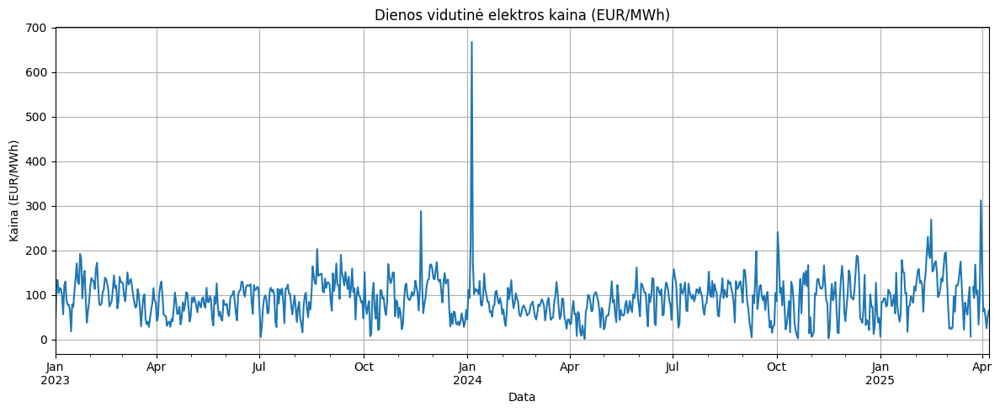

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3905932105.py:39: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  monthly_avg = df['price_eur_mwh'].resample('M').mean()


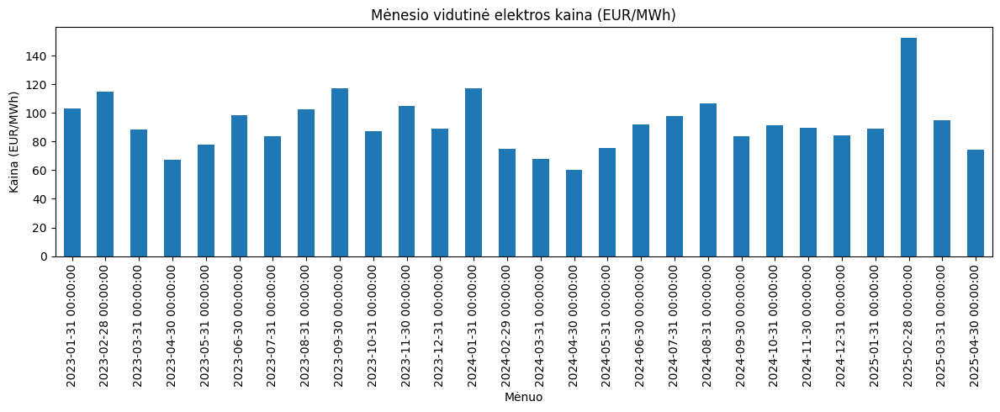

In [2]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    # Atsisiunčia JSON duomenis
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    # Konvertuoja į DataFrame
    df = pd.DataFrame(data)

    # Laiko konvertavimas
    df['local_time'] = pd.to_datetime(df['ltu'])  # vietinis laikas
    df['utc_time'] = pd.to_datetime(df['utc'])    # UTC laikas
    df['price_eur_mwh'] = df['value'].astype(float)

    # Nustatyti indeksą pagal laiką
    df.set_index('local_time', inplace=True)

    return df

def plot_daily_avg_prices(df: pd.DataFrame):
    # Dienos vidutinės kainos
    daily_avg = df['price_eur_mwh'].resample('D').mean()

    plt.figure(figsize=(12, 5))
    daily_avg.plot()
    plt.title("Dienos vidutinė elektros kaina (EUR/MWh)")
    plt.xlabel("Data")
    plt.ylabel("Kaina (EUR/MWh)")
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_monthly_avg_prices(df: pd.DataFrame):
    # Mėnesio vidutinės kainos
    monthly_avg = df['price_eur_mwh'].resample('M').mean()

    plt.figure(figsize=(12, 5))
    monthly_avg.plot(kind='bar')
    plt.title("Mėnesio vidutinė elektros kaina (EUR/MWh)")
    plt.xlabel("Mėnuo")
    plt.ylabel("Kaina (EUR/MWh)")
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    print(df.head())
    plot_daily_avg_prices(df)
    plot_monthly_avg_prices(df)


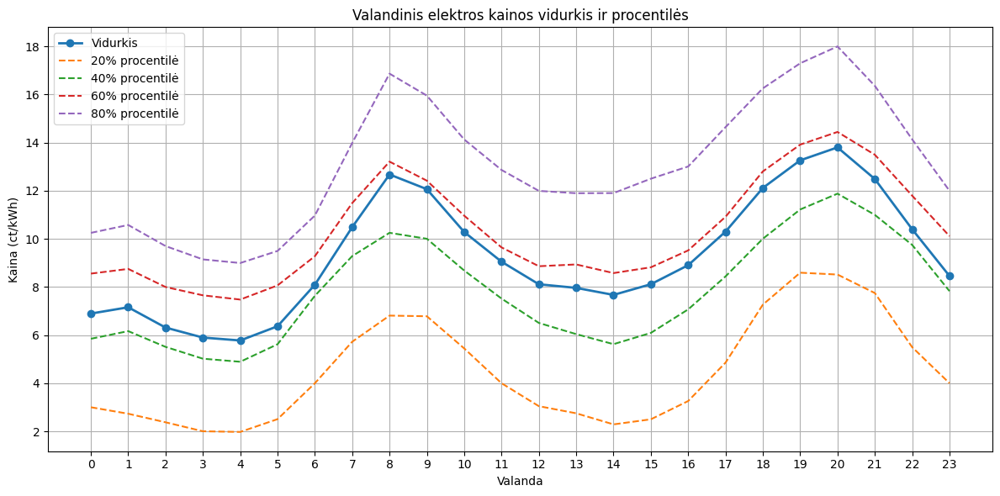

In [3]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df

def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    # Ištraukiame valandą iš laiko
    df['hour'] = df.index.hour

    # Grupavimas pagal valandas per visą laikotarpį
    hourly_stats = df.groupby('hour')['price_ct_kwh'].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('40%', lambda x: x.quantile(0.4)),
        ('60%', lambda x: x.quantile(0.6)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    # Braižome grafiką
    plt.figure(figsize=(12, 6))
    plt.plot(hourly_stats.index, hourly_stats['Mean'], label='Vidurkis', linewidth=2, marker='o')
    plt.plot(hourly_stats.index, hourly_stats['20%'], label='20% procentilė', linestyle='--')
    plt.plot(hourly_stats.index, hourly_stats['40%'], label='40% procentilė', linestyle='--')
    plt.plot(hourly_stats.index, hourly_stats['60%'], label='60% procentilė', linestyle='--')
    plt.plot(hourly_stats.index, hourly_stats['80%'], label='80% procentilė', linestyle='--')

    plt.title("Valandinis elektros kainos vidurkis ir procentilės")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)

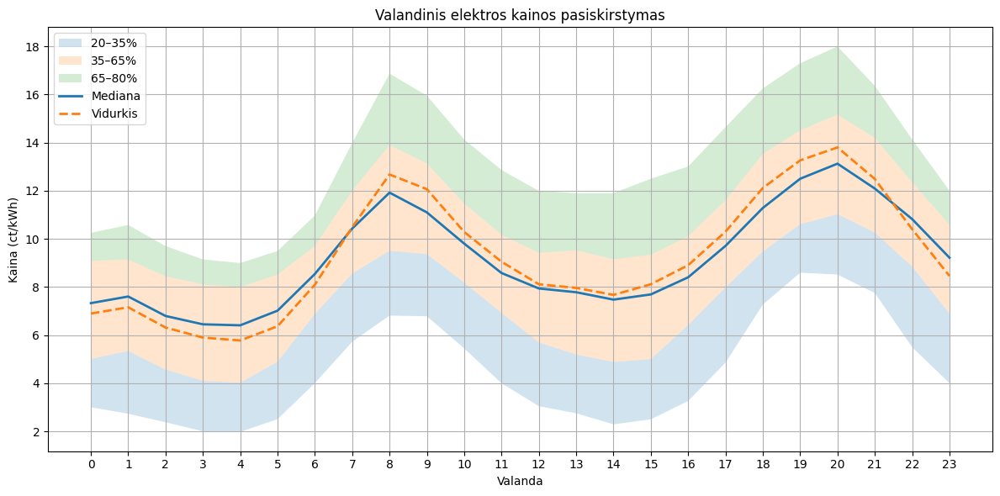

In [4]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df

def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    # Ištraukiame valandą iš laiko
    df['hour'] = df.index.hour

    # Grupavimas pagal valandas per visą laikotarpį
    hourly_stats = df.groupby('hour')['price_ct_kwh'].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    # Braižome grafiką
    plt.figure(figsize=(12, 6))

    # Šešėliavimas tarp procentilių
    plt.fill_between(hourly_stats.index, hourly_stats['20%'], hourly_stats['35%'], alpha=0.2, label='20–35%')
    plt.fill_between(hourly_stats.index, hourly_stats['35%'], hourly_stats['65%'], alpha=0.2, label='35–65%')
    plt.fill_between(hourly_stats.index, hourly_stats['65%'], hourly_stats['80%'], alpha=0.2, label='65–80%')

    # Linijos: mediana – ištisinė, vidurkis – punktyras
    plt.plot(hourly_stats.index, hourly_stats['Median'], label='Mediana', linewidth=2)
    plt.plot(hourly_stats.index, hourly_stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--')

    plt.title("Valandinis elektros kainos pasiskirstymas")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)

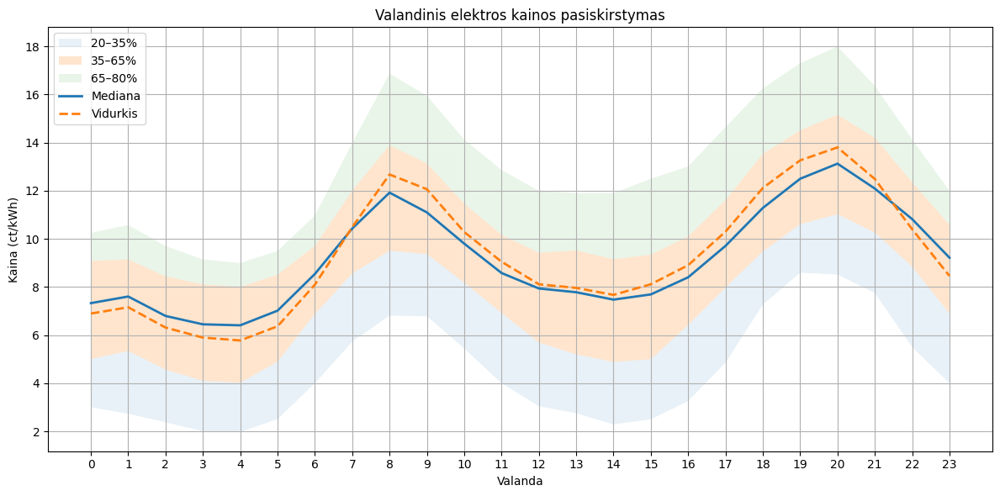

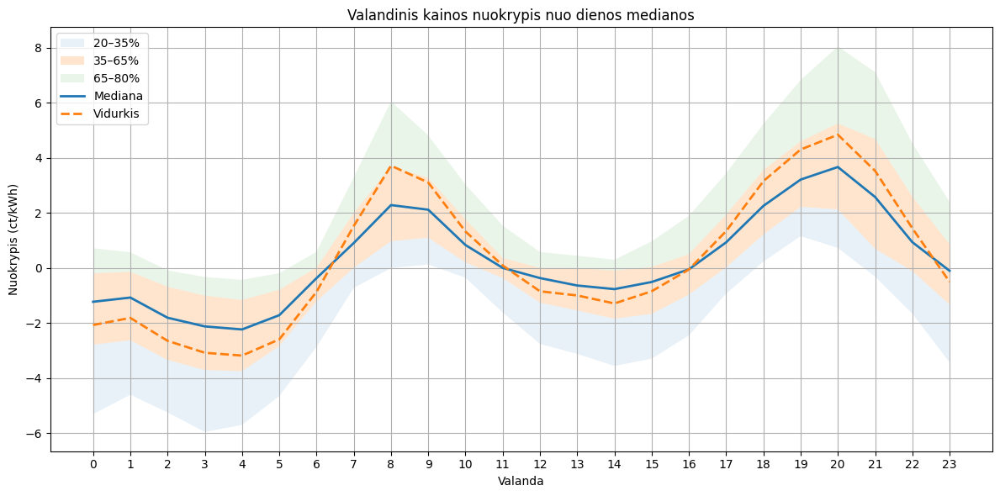

In [5]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df

def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    # Ištraukiame valandą iš laiko
    df['hour'] = df.index.hour

    # Grupavimas pagal valandas per visą laikotarpį
    hourly_stats = df.groupby('hour')['price_ct_kwh'].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    # Braižome grafiką
    plt.figure(figsize=(12, 6))

    # Šešėliavimas tarp procentilių (vienoda spalva, bet skirtingas alpha)
    plt.fill_between(hourly_stats.index, hourly_stats['20%'], hourly_stats['35%'], alpha=0.1, label='20–35%')
    plt.fill_between(hourly_stats.index, hourly_stats['35%'], hourly_stats['65%'], alpha=0.2, label='35–65%')
    plt.fill_between(hourly_stats.index, hourly_stats['65%'], hourly_stats['80%'], alpha=0.1, label='65–80%')

    # Linijos: mediana – ištisinė, vidurkis – punktyras
    plt.plot(hourly_stats.index, hourly_stats['Median'], label='Mediana', linewidth=2)
    plt.plot(hourly_stats.index, hourly_stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--')

    plt.title("Valandinis elektros kainos pasiskirstymas")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_hourly_deviation_from_daily_median(df: pd.DataFrame):
    # Dienos mediana
    df['date'] = df.index.date
    daily_median = df.groupby('date')['price_ct_kwh'].transform('median')

    # Skirtumas nuo dienos medianos
    df['deviation'] = df['price_ct_kwh'] - daily_median
    df['hour'] = df.index.hour

    # Grupavimas pagal valandas
    hourly_dev_stats = df.groupby('hour')['deviation'].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    # Braižome grafiką
    plt.figure(figsize=(12, 6))

    # Šešėliavimas tarp procentilių (vienoda spalva, bet skirtingas alpha)
    plt.fill_between(hourly_dev_stats.index, hourly_dev_stats['20%'], hourly_dev_stats['35%'], alpha=0.1, label='20–35%')
    plt.fill_between(hourly_dev_stats.index, hourly_dev_stats['35%'], hourly_dev_stats['65%'], alpha=0.2, label='35–65%')
    plt.fill_between(hourly_dev_stats.index, hourly_dev_stats['65%'], hourly_dev_stats['80%'], alpha=0.1, label='65–80%')

    # Linijos: mediana – ištisinė, vidurkis – punktyras
    plt.plot(hourly_dev_stats.index, hourly_dev_stats['Median'], label='Mediana', linewidth=2)
    plt.plot(hourly_dev_stats.index, hourly_dev_stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--')

    plt.title("Valandinis kainos nuokrypis nuo dienos medianos")
    plt.xlabel("Valanda")
    plt.ylabel("Nuokrypis (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)

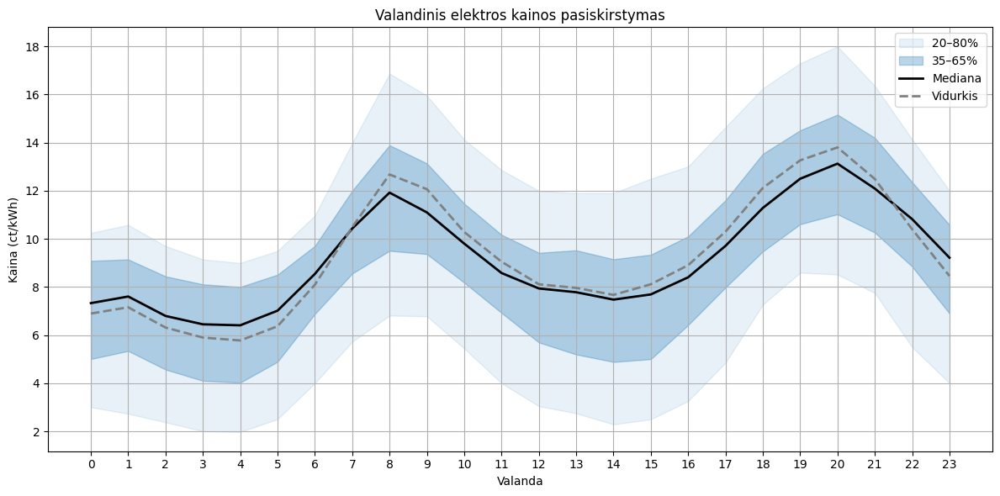

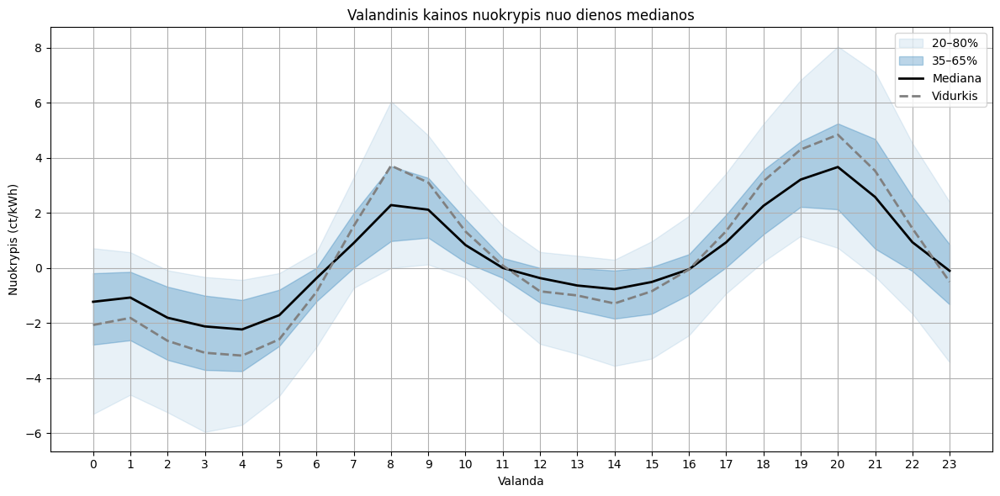

In [6]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df

def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    # Ištraukiame valandą iš laiko
    df['hour'] = df.index.hour

    # Grupavimas pagal valandas per visą laikotarpį
    hourly_stats = df.groupby('hour')['price_ct_kwh'].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    # Braižome grafiką
    plt.figure(figsize=(12, 6))

    # Fonas: šviesus 20–80%, tamsesnis 35–65%
    plt.fill_between(hourly_stats.index, hourly_stats['20%'], hourly_stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(hourly_stats.index, hourly_stats['35%'], hourly_stats['65%'], color='C0', alpha=0.3, label='35–65%')

    # Linijos: mediana – ištisinė, vidurkis – punktyras
    plt.plot(hourly_stats.index, hourly_stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(hourly_stats.index, hourly_stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    plt.title("Valandinis elektros kainos pasiskirstymas")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_hourly_deviation_from_daily_median(df: pd.DataFrame):
    # Dienos mediana
    df['date'] = df.index.date
    daily_median = df.groupby('date')['price_ct_kwh'].transform('median')

    # Skirtumas nuo dienos medianos
    df['deviation'] = df['price_ct_kwh'] - daily_median
    df['hour'] = df.index.hour

    # Grupavimas pagal valandas
    hourly_dev_stats = df.groupby('hour')['deviation'].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    # Braižome grafiką
    plt.figure(figsize=(12, 6))

    # Fonas: šviesus 20–80%, tamsesnis 35–65%
    plt.fill_between(hourly_dev_stats.index, hourly_dev_stats['20%'], hourly_dev_stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(hourly_dev_stats.index, hourly_dev_stats['35%'], hourly_dev_stats['65%'], color='C0', alpha=0.3, label='35–65%')

    # Linijos: mediana – ištisinė, vidurkis – punktyras
    plt.plot(hourly_dev_stats.index, hourly_dev_stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(hourly_dev_stats.index, hourly_dev_stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    plt.title("Valandinis kainos nuokrypis nuo dienos medianos")
    plt.xlabel("Valanda")
    plt.ylabel("Nuokrypis (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)


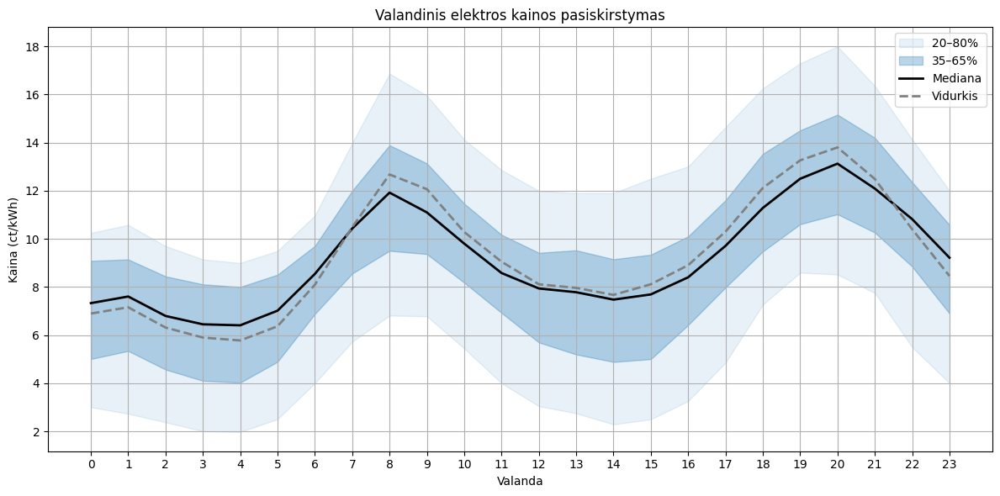

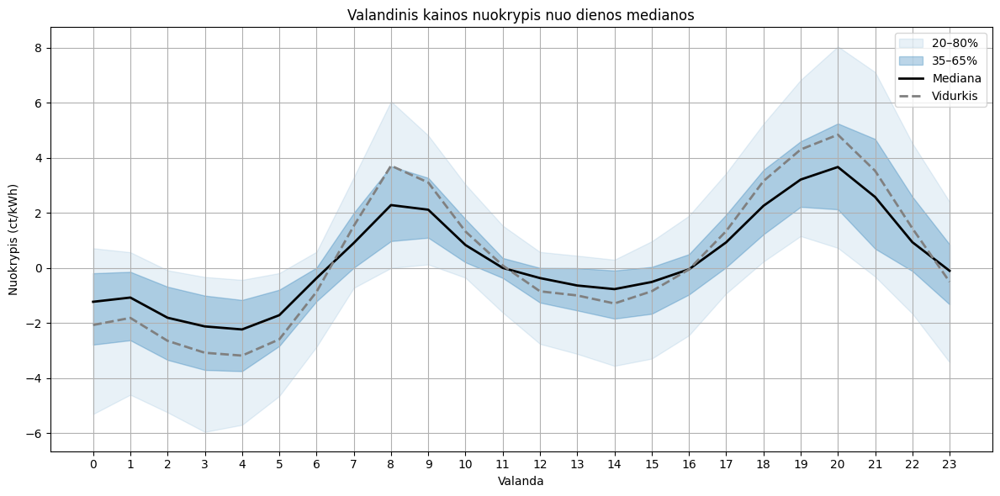

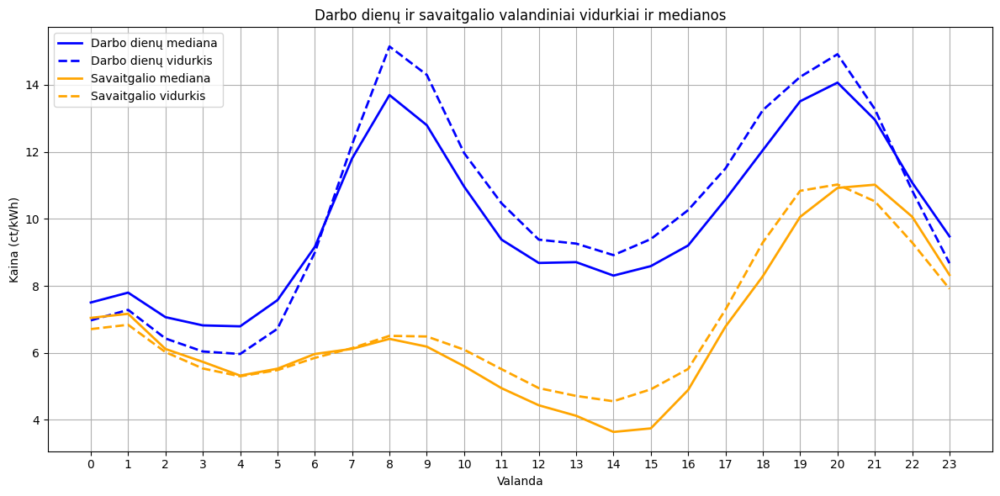

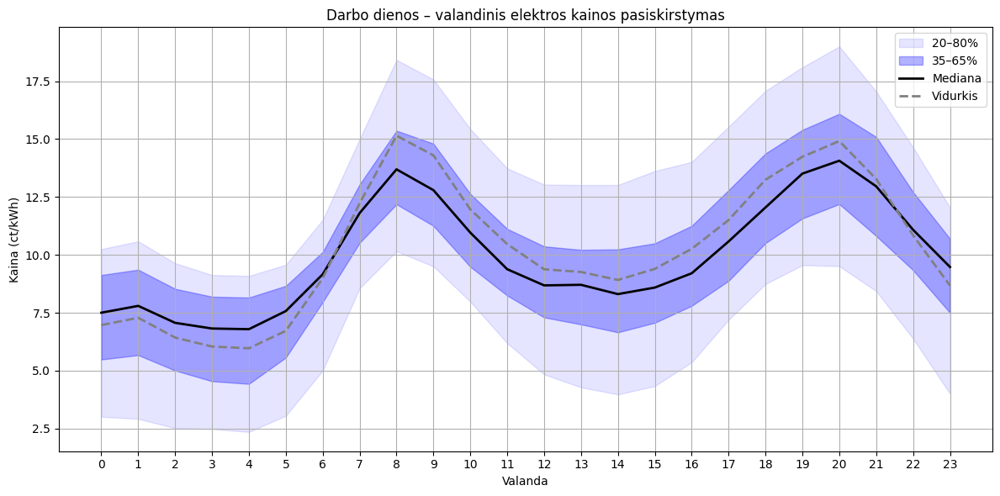

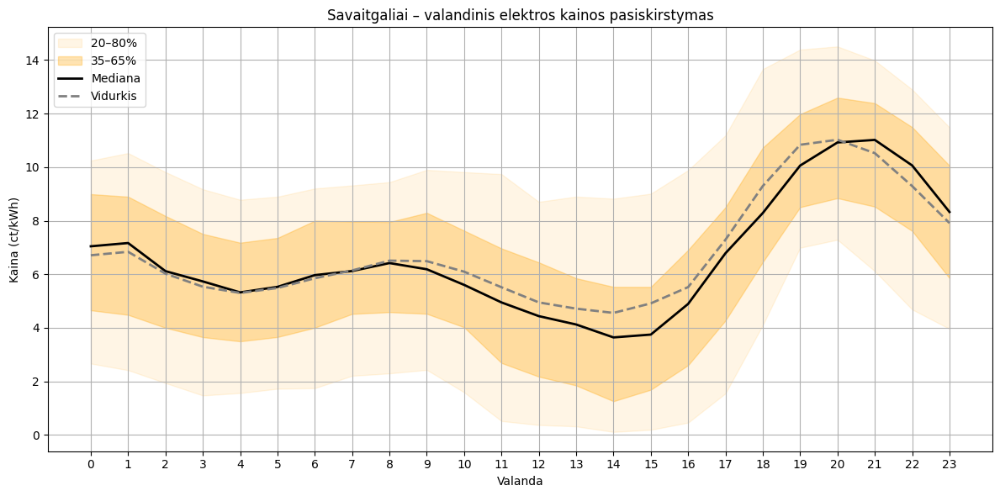

In [7]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df

def compute_hourly_stats(df: pd.DataFrame, column: str) -> pd.DataFrame:
    df['hour'] = df.index.hour
    return df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

def plot_hourly_distribution(stats: pd.DataFrame, title: str, ylabel: str):
    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')
    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_hourly_deviation_from_daily_median(df: pd.DataFrame):
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')
    stats = compute_hourly_stats(df, 'deviation')
    plot_hourly_distribution(stats, "Valandinis kainos nuokrypis nuo dienos medianos", "Nuokrypis (ct/kWh)")

def plot_separated_by_weekday(df: pd.DataFrame):
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['is_weekend'] = df['weekday'] >= 5

    weekday_df = df[df['is_weekend'] == False]
    weekend_df = df[df['is_weekend'] == True]

    weekday_stats = weekday_df.groupby('hour')['price_ct_kwh'].agg(['mean', 'median'])
    weekend_stats = weekend_df.groupby('hour')['price_ct_kwh'].agg(['mean', 'median'])

    plt.figure(figsize=(12, 6))
    plt.plot(weekday_stats.index, weekday_stats['median'], label='Darbo dienų mediana', color='blue', linewidth=2)
    plt.plot(weekday_stats.index, weekday_stats['mean'], label='Darbo dienų vidurkis', color='blue', linestyle='--', linewidth=2)
    plt.plot(weekend_stats.index, weekend_stats['median'], label='Savaitgalio mediana', color='orange', linewidth=2)
    plt.plot(weekend_stats.index, weekend_stats['mean'], label='Savaitgalio vidurkis', color='orange', linestyle='--', linewidth=2)
    plt.title("Darbo dienų ir savaitgalio valandiniai vidurkiai ir medianos")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Atskiri grafikai su fonu
    for df_slice, label, color in [
        (weekday_df, 'Darbo dienos', 'blue'),
        (weekend_df, 'Savaitgaliai', 'orange')
    ]:
        stats = compute_hourly_stats(df_slice.copy(), 'price_ct_kwh')
        
        plt.figure(figsize=(12, 6))
        plt.fill_between(stats.index, stats['20%'], stats['80%'], color=color, alpha=0.1, label='20–80%')
        plt.fill_between(stats.index, stats['35%'], stats['65%'], color=color, alpha=0.3, label='35–65%')
        plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
        plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')
        plt.title(f"{label} – valandinis elektros kainos pasiskirstymas")
        plt.xlabel("Valanda")
        plt.ylabel("Kaina (ct/kWh)")
        plt.xticks(range(0, 24))
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    stats = compute_hourly_stats(df, 'price_ct_kwh')
    plot_hourly_distribution(stats, "Valandinis elektros kainos pasiskirstymas", "Kaina (ct/kWh)")

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)

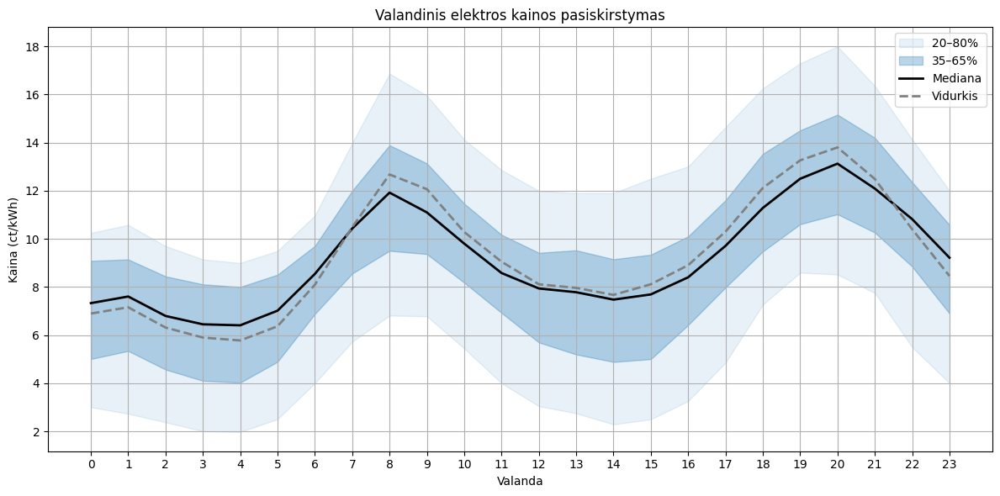

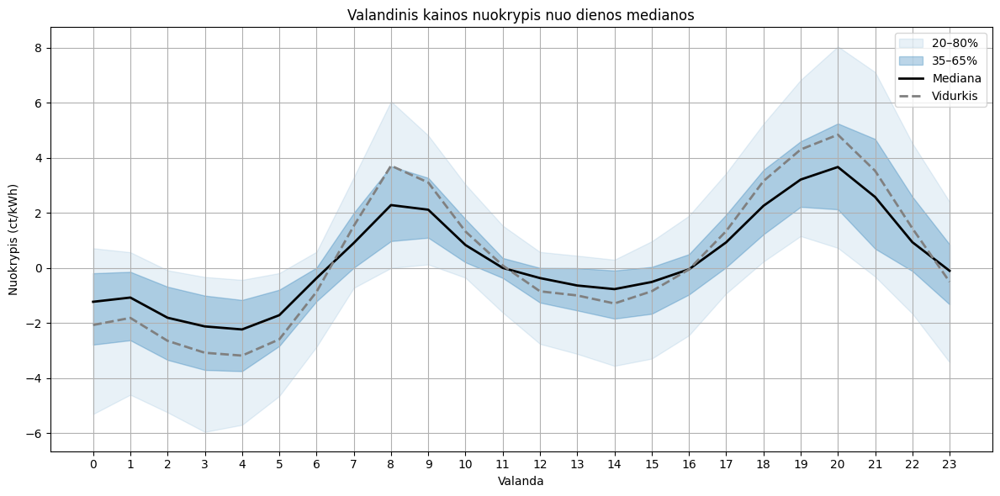

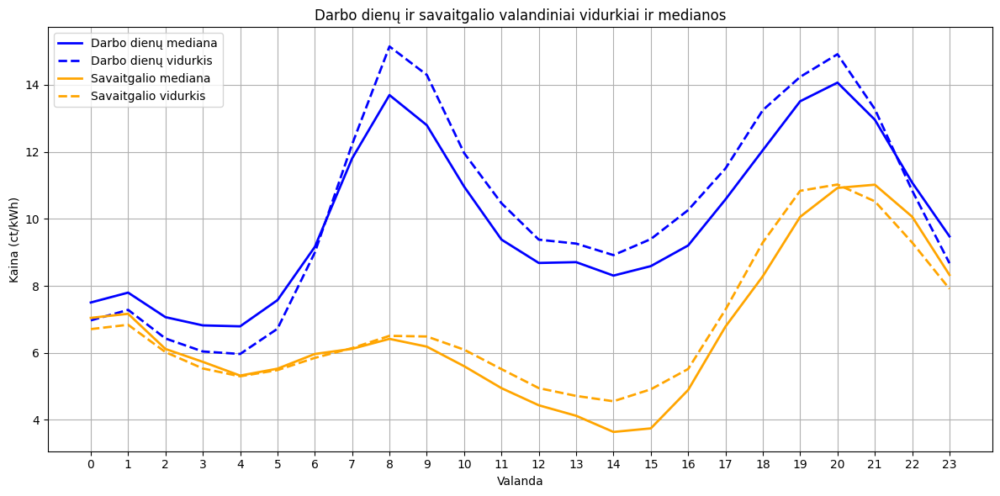

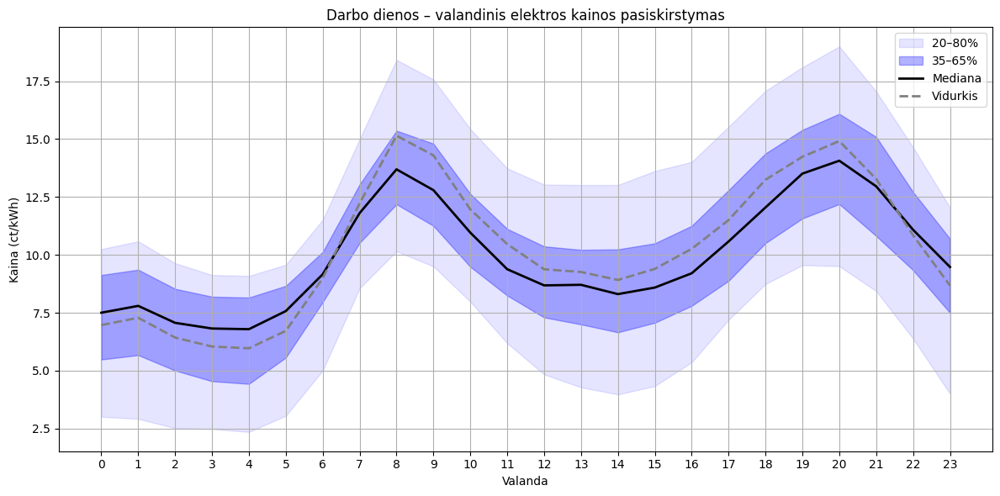

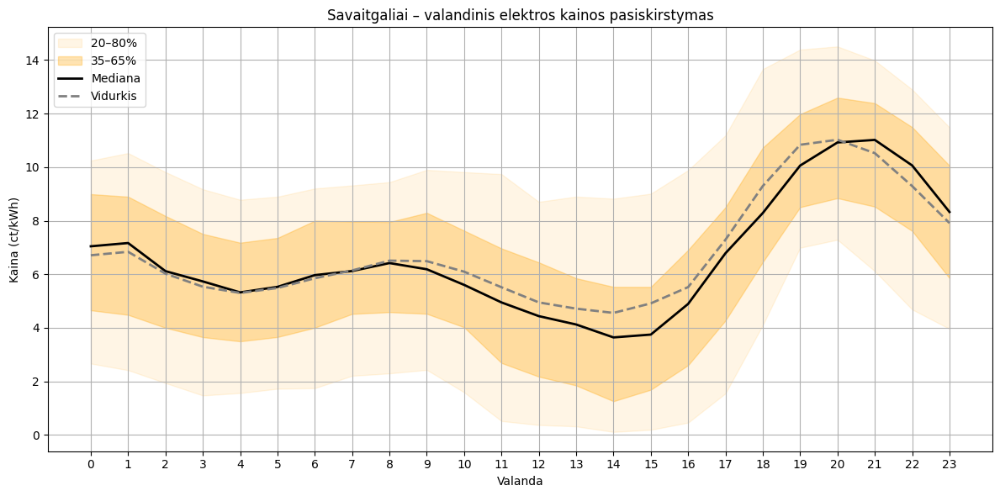

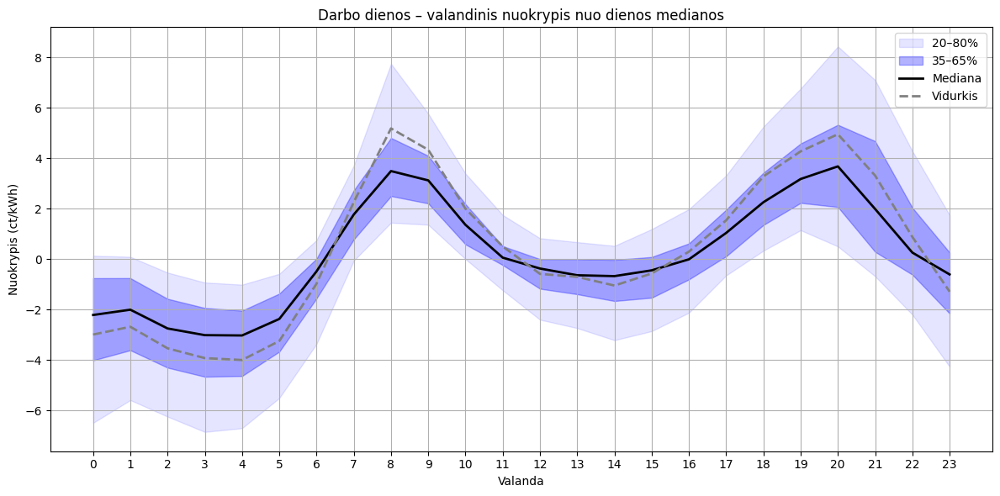

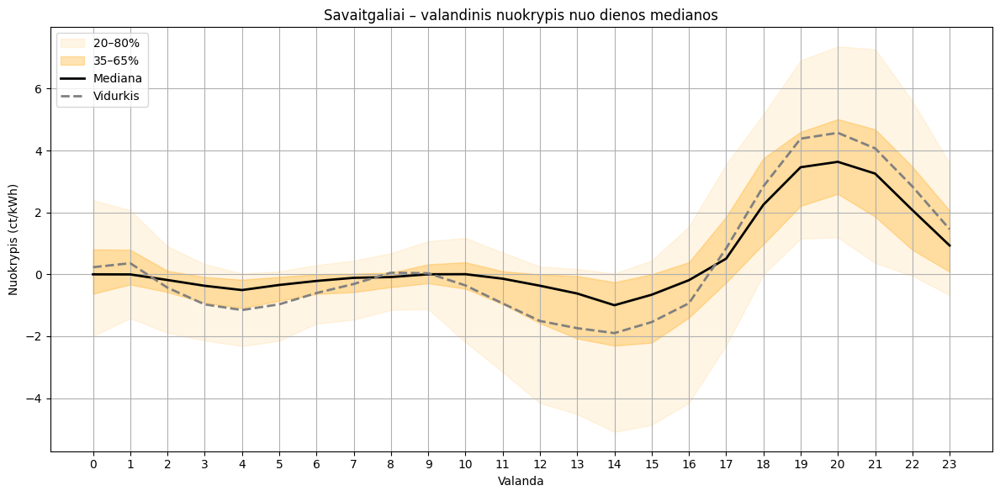

In [8]:
import requests
import pandas as pd
import matplotlib.pyplot as plt

def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df

def compute_hourly_stats(df: pd.DataFrame, column: str) -> pd.DataFrame:
    df['hour'] = df.index.hour
    return df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

def plot_hourly_distribution(stats: pd.DataFrame, title: str, ylabel: str):
    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')
    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

def plot_hourly_deviation_from_daily_median(df: pd.DataFrame):
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')
    stats = compute_hourly_stats(df, 'deviation')
    plot_hourly_distribution(stats, "Valandinis kainos nuokrypis nuo dienos medianos", "Nuokrypis (ct/kWh)")

def plot_separated_by_weekday(df: pd.DataFrame):
    df['date'] = df.index.date
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['is_weekend'] = df['weekday'] >= 5
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    weekday_df = df[df['is_weekend'] == False].copy()
    weekend_df = df[df['is_weekend'] == True].copy()

    # Kainų statistika – bendras grafikas
    weekday_stats = weekday_df.groupby('hour')['price_ct_kwh'].agg(['mean', 'median'])
    weekend_stats = weekend_df.groupby('hour')['price_ct_kwh'].agg(['mean', 'median'])

    plt.figure(figsize=(12, 6))
    plt.plot(weekday_stats.index, weekday_stats['median'], label='Darbo dienų mediana', color='blue', linewidth=2)
    plt.plot(weekday_stats.index, weekday_stats['mean'], label='Darbo dienų vidurkis', color='blue', linestyle='--', linewidth=2)
    plt.plot(weekend_stats.index, weekend_stats['median'], label='Savaitgalio mediana', color='orange', linewidth=2)
    plt.plot(weekend_stats.index, weekend_stats['mean'], label='Savaitgalio vidurkis', color='orange', linestyle='--', linewidth=2)
    plt.title("Darbo dienų ir savaitgalio valandiniai vidurkiai ir medianos")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Atskiri grafikai su fonu – kainos
    for df_slice, label, color in [
        (weekday_df, 'Darbo dienos', 'blue'),
        (weekend_df, 'Savaitgaliai', 'orange')
    ]:
        stats = compute_hourly_stats(df_slice.copy(), 'price_ct_kwh')
        plt.figure(figsize=(12, 6))
        plt.fill_between(stats.index, stats['20%'], stats['80%'], color=color, alpha=0.1, label='20–80%')
        plt.fill_between(stats.index, stats['35%'], stats['65%'], color=color, alpha=0.3, label='35–65%')
        plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
        plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')
        plt.title(f"{label} – valandinis elektros kainos pasiskirstymas")
        plt.xlabel("Valanda")
        plt.ylabel("Kaina (ct/kWh)")
        plt.xticks(range(0, 24))
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    # Atskiri grafikai su fonu – nuokrypiai
    for df_slice, label, color in [
        (weekday_df, 'Darbo dienos', 'blue'),
        (weekend_df, 'Savaitgaliai', 'orange')
    ]:
        stats = compute_hourly_stats(df_slice.copy(), 'deviation')
        plt.figure(figsize=(12, 6))
        plt.fill_between(stats.index, stats['20%'], stats['80%'], color=color, alpha=0.1, label='20–80%')
        plt.fill_between(stats.index, stats['35%'], stats['65%'], color=color, alpha=0.3, label='35–65%')
        plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
        plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')
        plt.title(f"{label} – valandinis nuokrypis nuo dienos medianos")
        plt.xlabel("Valanda")
        plt.ylabel("Nuokrypis (ct/kWh)")
        plt.xticks(range(0, 24))
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    stats = compute_hourly_stats(df, 'price_ct_kwh')
    plot_hourly_distribution(stats, "Valandinis elektros kainos pasiskirstymas", "Kaina (ct/kWh)")

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)


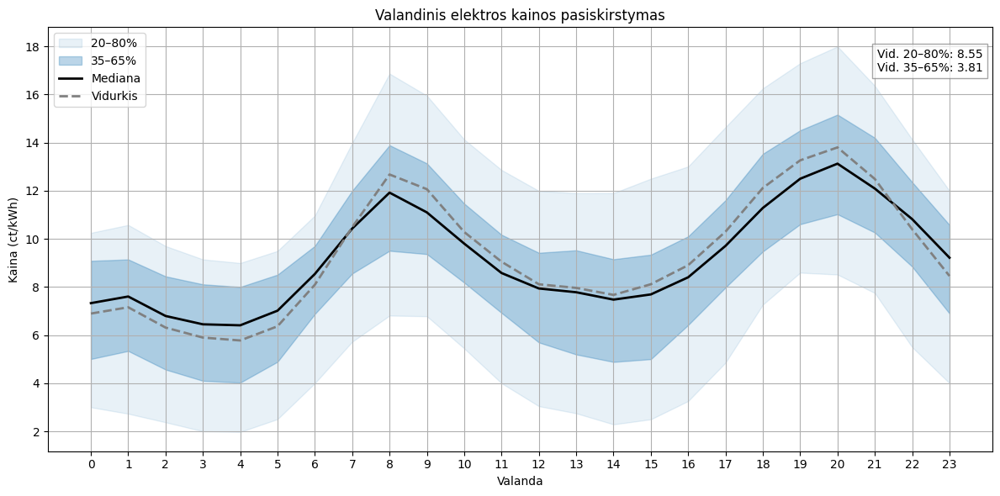

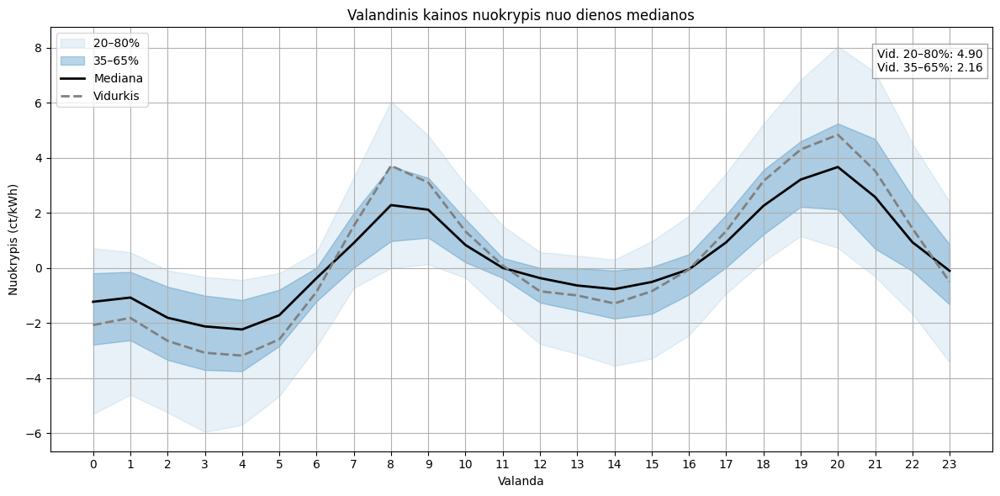

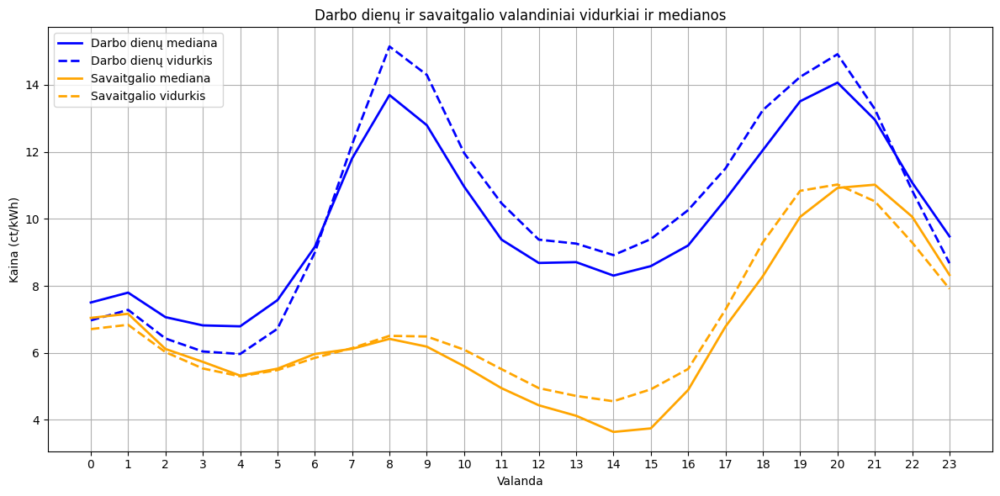

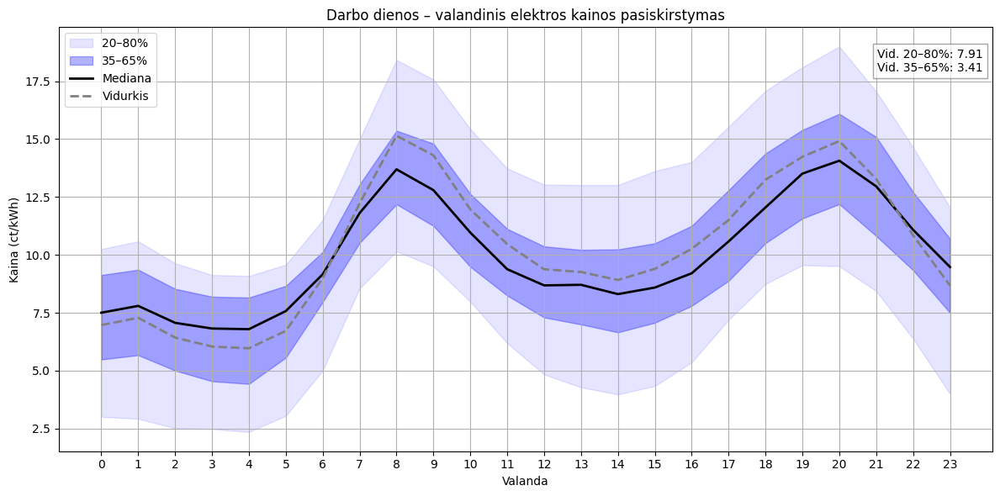

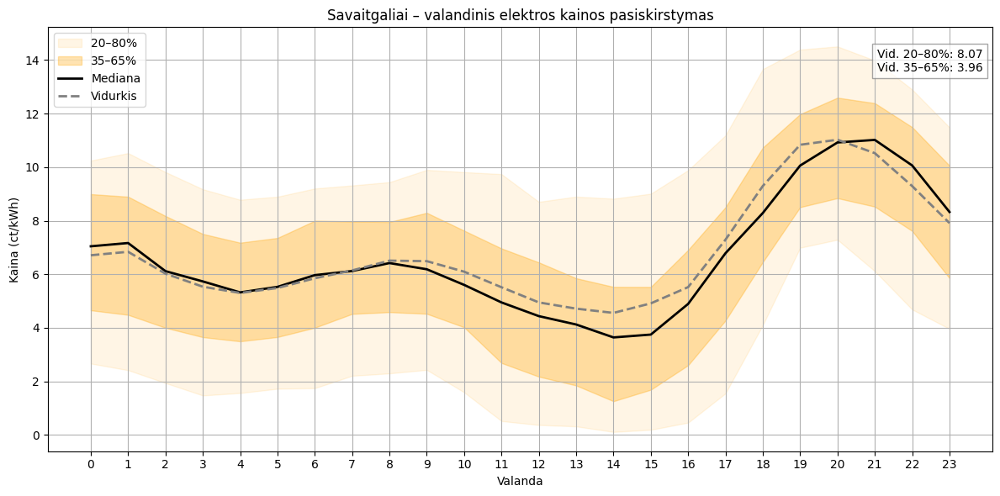

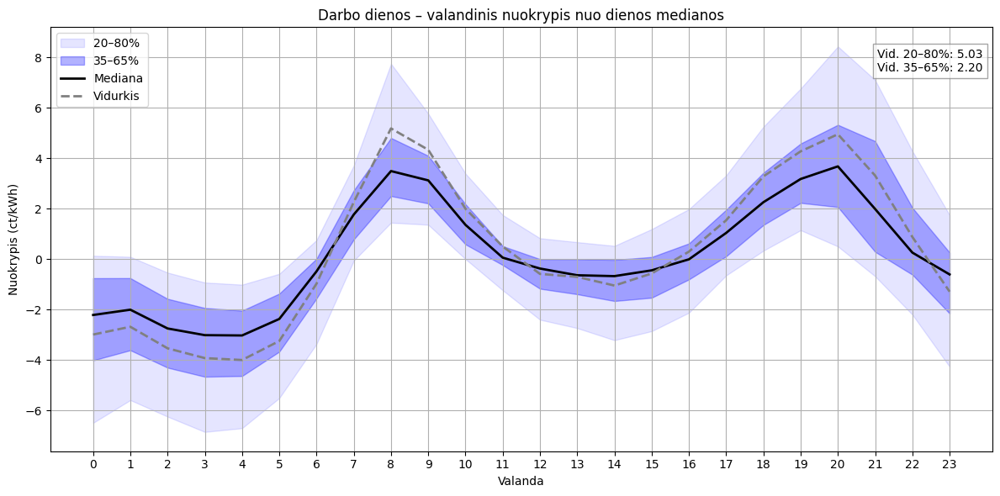

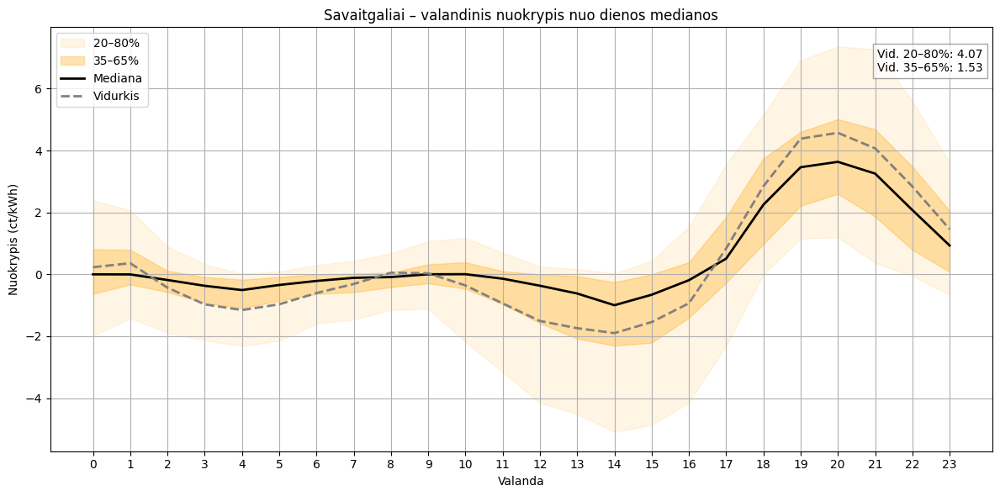

In [9]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df


def compute_hourly_stats(df: pd.DataFrame, column: str) -> pd.DataFrame:
    df['hour'] = df.index.hour
    return df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])


def plot_hourly_distribution(stats: pd.DataFrame, title: str, ylabel: str):
    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()
    plt.text(0.99, 0.95, f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}",
             transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


def plot_hourly_deviation_from_daily_median(df: pd.DataFrame):
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')
    stats = compute_hourly_stats(df, 'deviation')
    plot_hourly_distribution(stats, "Valandinis kainos nuokrypis nuo dienos medianos", "Nuokrypis (ct/kWh)")


def plot_separated_by_weekday(df: pd.DataFrame):
    df['date'] = df.index.date
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['is_weekend'] = df['weekday'] >= 5
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    weekday_df = df[df['is_weekend'] == False].copy()
    weekend_df = df[df['is_weekend'] == True].copy()

    # Kainų statistika – bendras grafikas
    weekday_stats = weekday_df.groupby('hour')['price_ct_kwh'].agg(['mean', 'median'])
    weekend_stats = weekend_df.groupby('hour')['price_ct_kwh'].agg(['mean', 'median'])

    plt.figure(figsize=(12, 6))
    plt.plot(weekday_stats.index, weekday_stats['median'], label='Darbo dienų mediana', color='blue', linewidth=2)
    plt.plot(weekday_stats.index, weekday_stats['mean'], label='Darbo dienų vidurkis', color='blue', linestyle='--', linewidth=2)
    plt.plot(weekend_stats.index, weekend_stats['median'], label='Savaitgalio mediana', color='orange', linewidth=2)
    plt.plot(weekend_stats.index, weekend_stats['mean'], label='Savaitgalio vidurkis', color='orange', linestyle='--', linewidth=2)
    plt.title("Darbo dienų ir savaitgalio valandiniai vidurkiai ir medianos")
    plt.xlabel("Valanda")
    plt.ylabel("Kaina (ct/kWh)")
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # Atskiri grafikai su fonu – kainos
    for df_slice, label, color in [
        (weekday_df, 'Darbo dienos', 'blue'),
        (weekend_df, 'Savaitgaliai', 'orange')
    ]:
        stats = compute_hourly_stats(df_slice.copy(), 'price_ct_kwh')
        plt.figure(figsize=(12, 6))
        plt.fill_between(stats.index, stats['20%'], stats['80%'], color=color, alpha=0.1, label='20–80%')
        plt.fill_between(stats.index, stats['35%'], stats['65%'], color=color, alpha=0.3, label='35–65%')
        plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
        plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

        mean_20_80 = (stats['80%'] - stats['20%']).mean()
        mean_35_65 = (stats['65%'] - stats['35%']).mean()
        plt.text(0.99, 0.95, f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}",
                 transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
                 bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

        plt.title(f"{label} – valandinis elektros kainos pasiskirstymas")
        plt.xlabel("Valanda")
        plt.ylabel("Kaina (ct/kWh)")
        plt.xticks(range(0, 24))
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

    # Atskiri grafikai su fonu – nuokrypiai
    for df_slice, label, color in [
        (weekday_df, 'Darbo dienos', 'blue'),
        (weekend_df, 'Savaitgaliai', 'orange')
    ]:
        stats = compute_hourly_stats(df_slice.copy(), 'deviation')
        plt.figure(figsize=(12, 6))
        plt.fill_between(stats.index, stats['20%'], stats['80%'], color=color, alpha=0.1, label='20–80%')
        plt.fill_between(stats.index, stats['35%'], stats['65%'], color=color, alpha=0.3, label='35–65%')
        plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
        plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

        mean_20_80 = (stats['80%'] - stats['20%']).mean()
        mean_35_65 = (stats['65%'] - stats['35%']).mean()
        plt.text(0.99, 0.95, f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}",
                 transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
                 bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

        plt.title(f"{label} – valandinis nuokrypis nuo dienos medianos")
        plt.xlabel("Valanda")
        plt.ylabel("Nuokrypis (ct/kWh)")
        plt.xticks(range(0, 24))
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()


def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    stats = compute_hourly_stats(df, 'price_ct_kwh')
    plot_hourly_distribution(stats, "Valandinis elektros kainos pasiskirstymas", "Kaina (ct/kWh)")


if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)


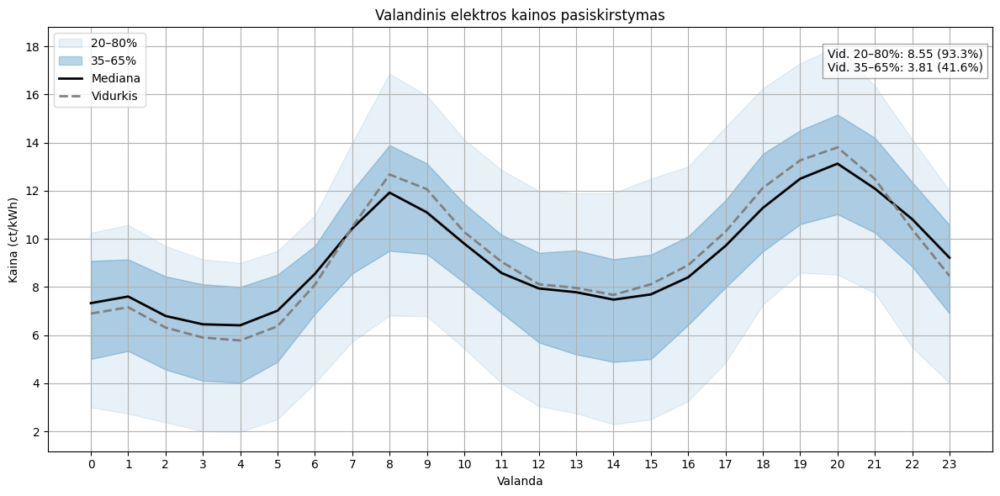

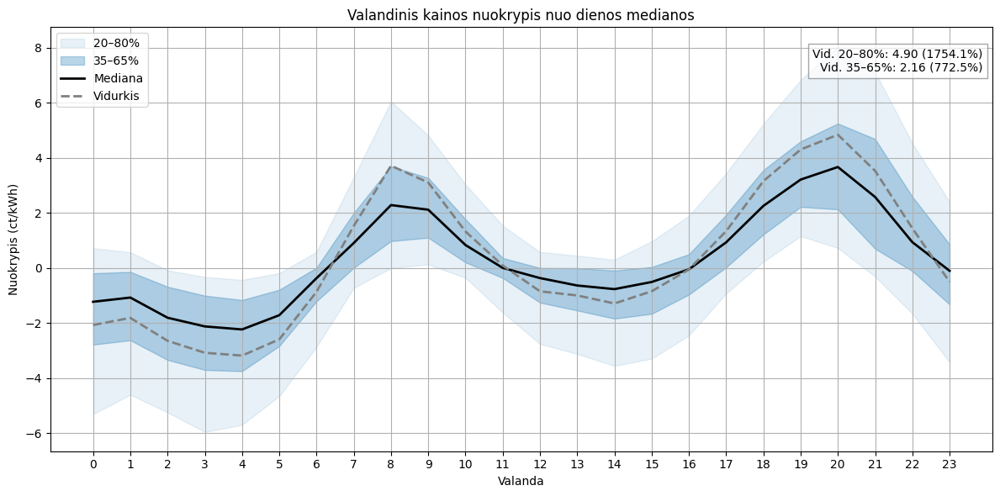

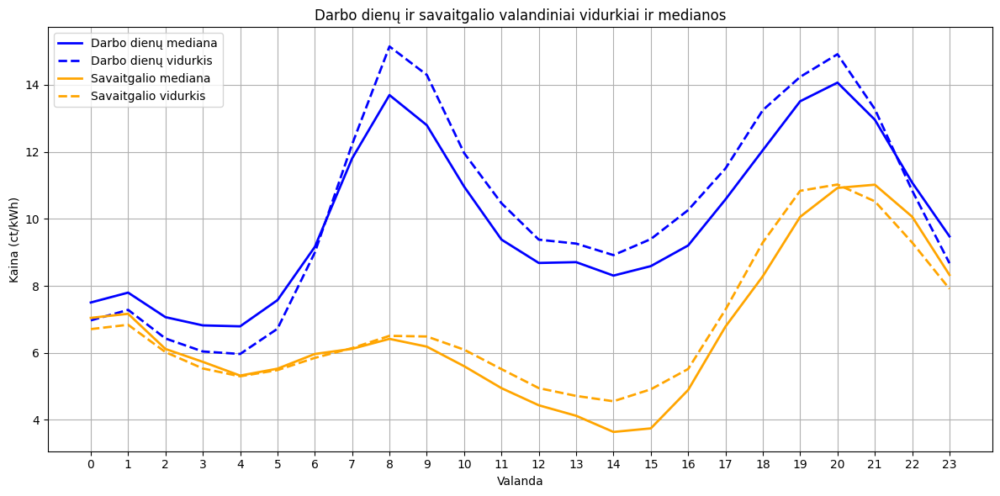

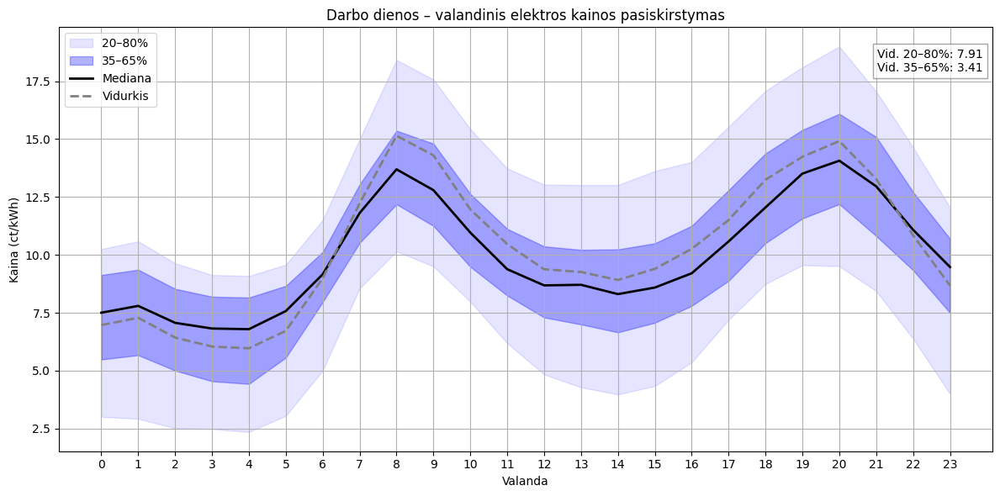

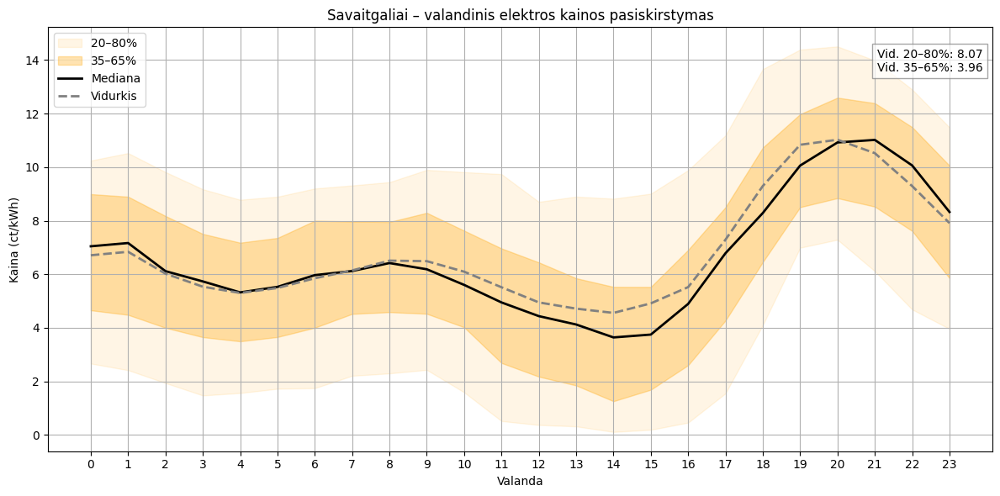

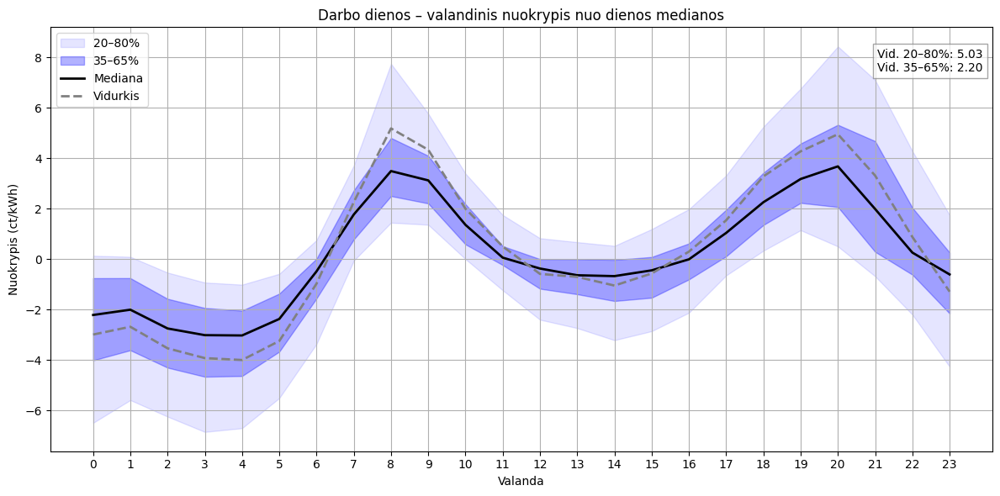

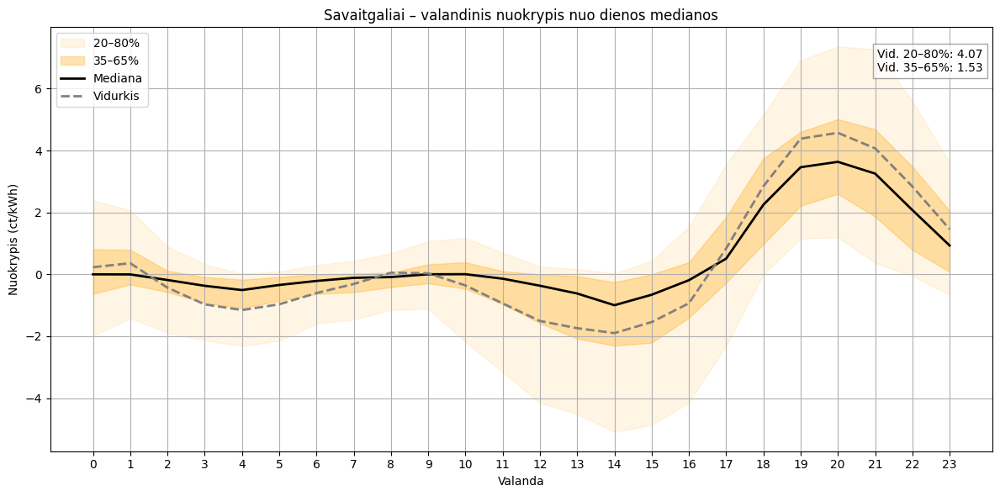

In [10]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df


def compute_hourly_stats(df: pd.DataFrame, column: str) -> pd.DataFrame:
    df['hour'] = df.index.hour
    return df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])


def plot_hourly_distribution(stats: pd.DataFrame, title: str, ylabel: str):
    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()
    mean_20_80_pct = (mean_20_80 / stats['Median'].mean()) * 100
    mean_35_65_pct = (mean_35_65 / stats['Median'].mean()) * 100
    
    plt.text(0.99, 0.95,
             f"Vid. 20–80%: {mean_20_80:.2f} ({mean_20_80_pct:.1f}%)\nVid. 35–65%: {mean_35_65:.2f} ({mean_35_65_pct:.1f}%)",
             transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# Kiti likę grafikai naudoja plot_hourly_distribution, todėl jie automatiškai gaus šią informaciją

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)


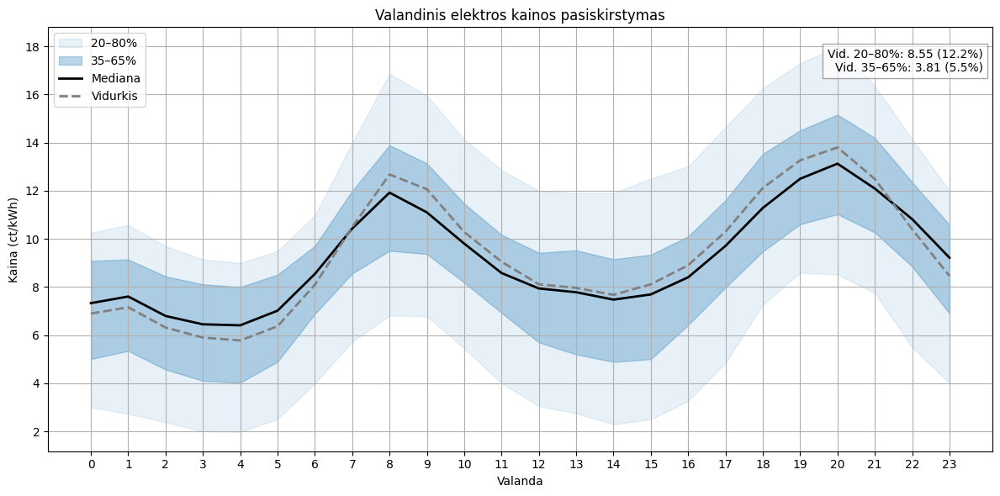

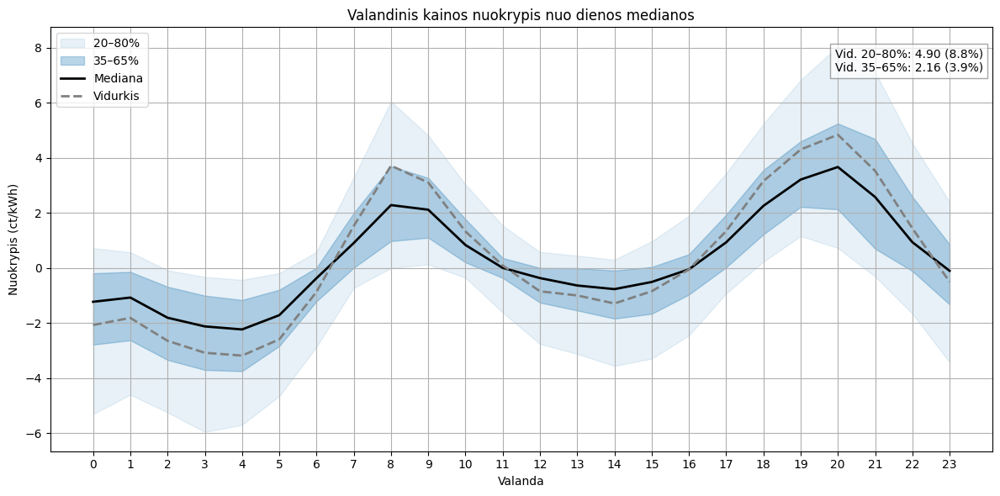

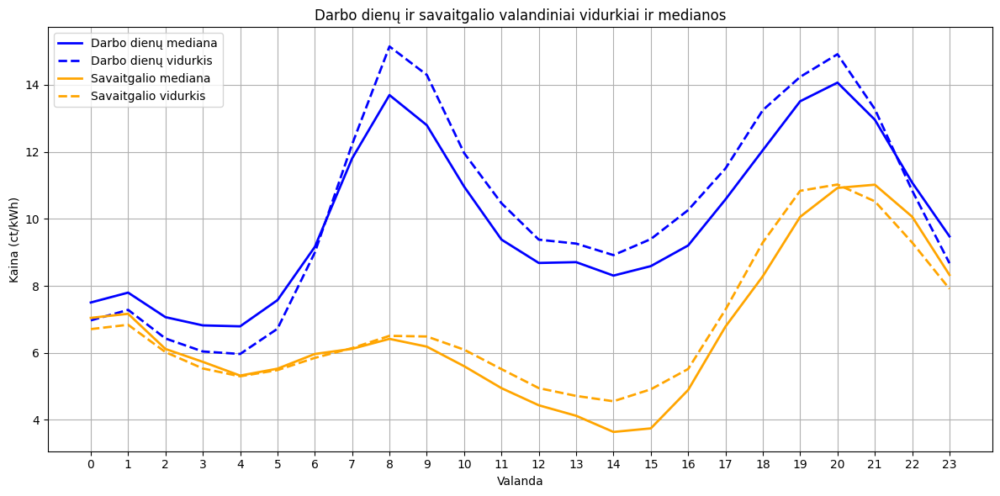

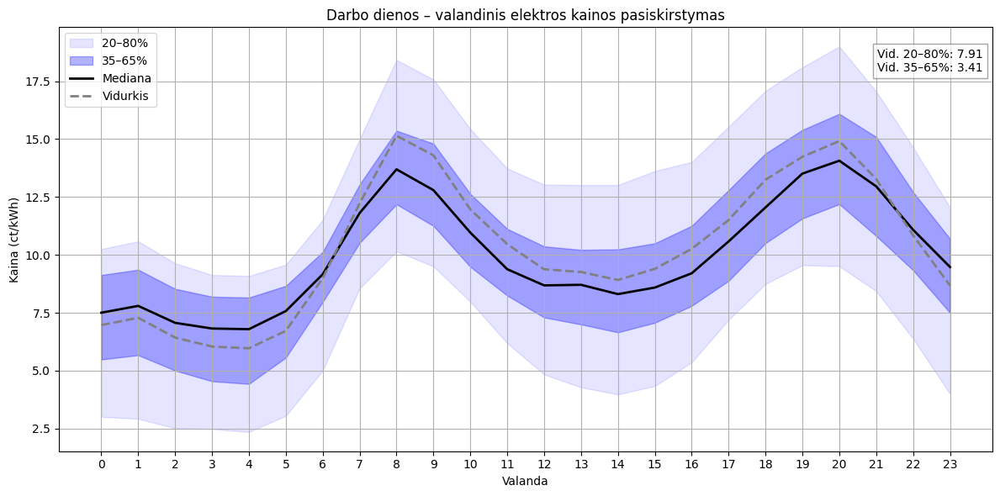

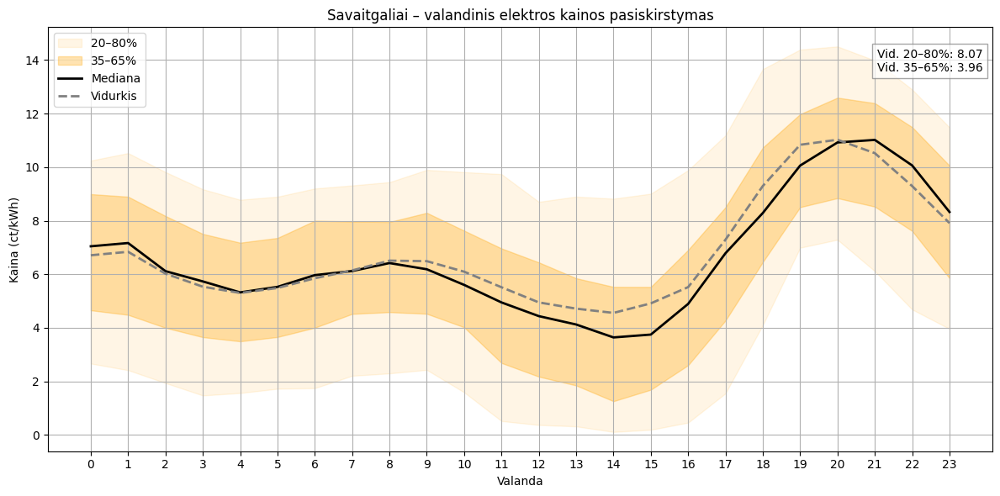

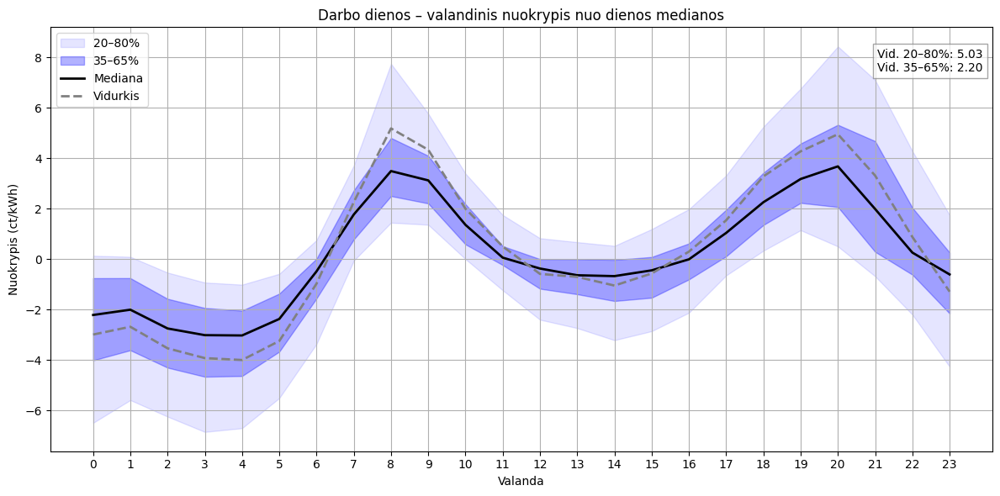

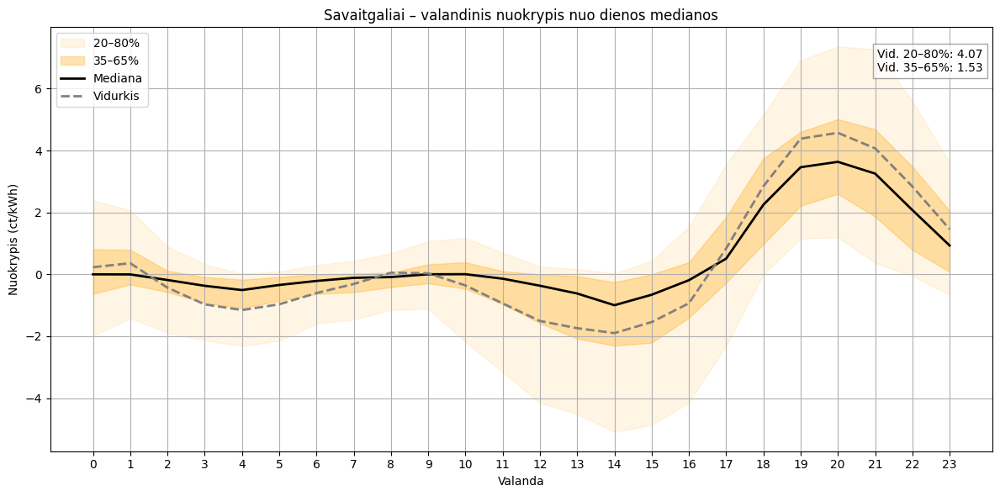

In [11]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df


def compute_hourly_stats(df: pd.DataFrame, column: str) -> pd.DataFrame:
    df['hour'] = df.index.hour
    return df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8)),
        ('Max', 'max'),
        ('Min', 'min')
    ])


def plot_hourly_distribution(stats: pd.DataFrame, title: str, ylabel: str):
    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()
    range_mean = (stats['Max'] - stats['Min']).mean()

    mean_20_80_pct = (mean_20_80 / range_mean) * 100 if range_mean else 0
    mean_35_65_pct = (mean_35_65 / range_mean) * 100 if range_mean else 0

    plt.text(0.99, 0.95,
             f"Vid. 20–80%: {mean_20_80:.2f} ({mean_20_80_pct:.1f}%)\nVid. 35–65%: {mean_35_65:.2f} ({mean_35_65_pct:.1f}%)",
             transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


# Kiti likę grafikai naudoja plot_hourly_distribution, todėl jie automatiškai gaus šią informaciją

if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)


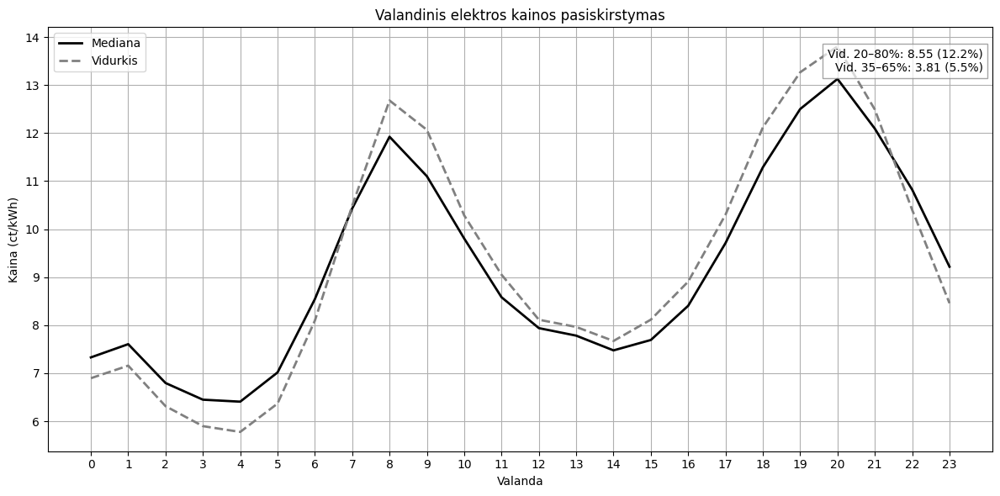

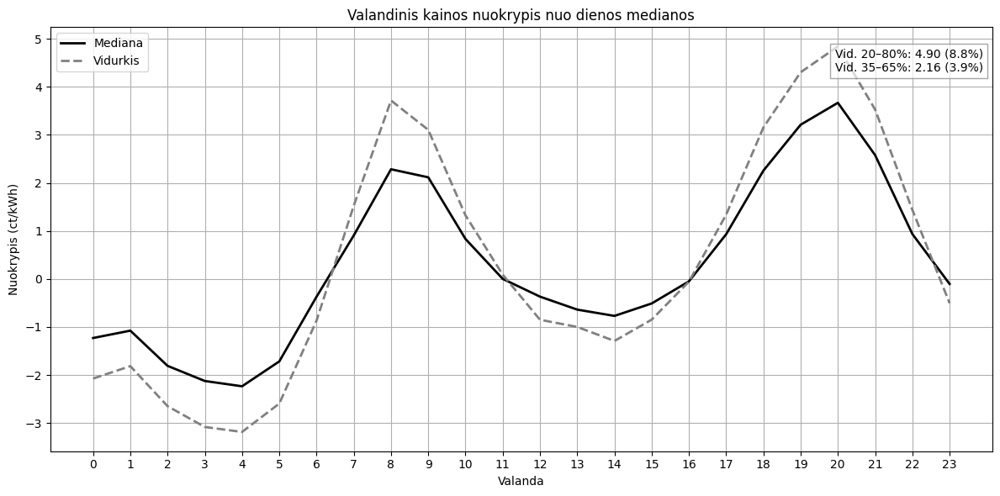

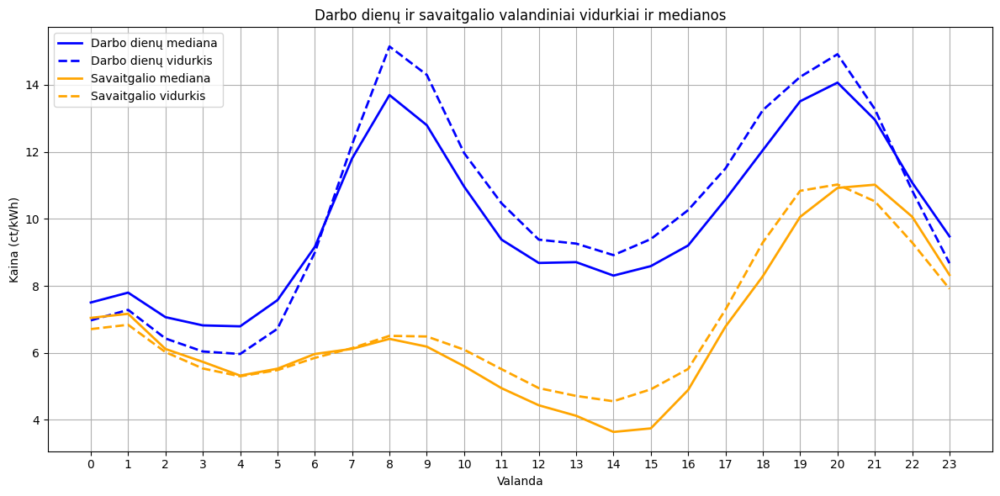

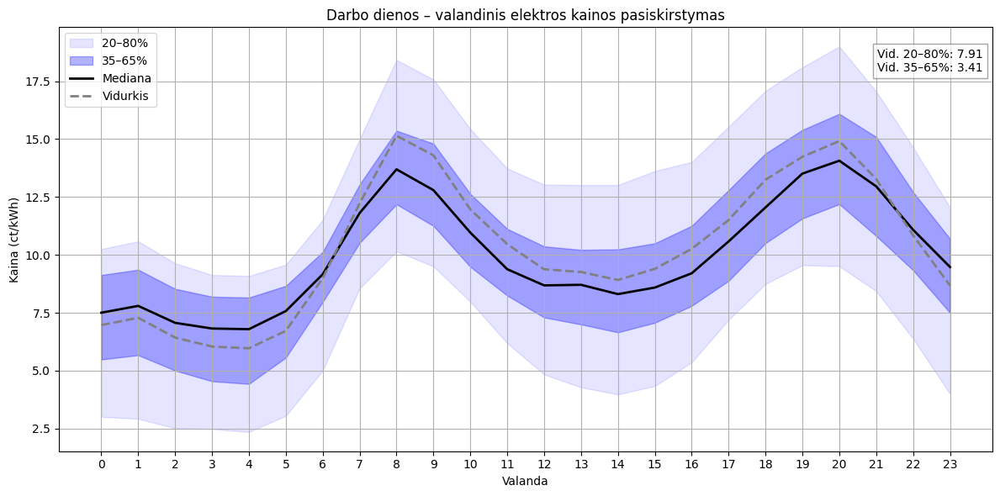

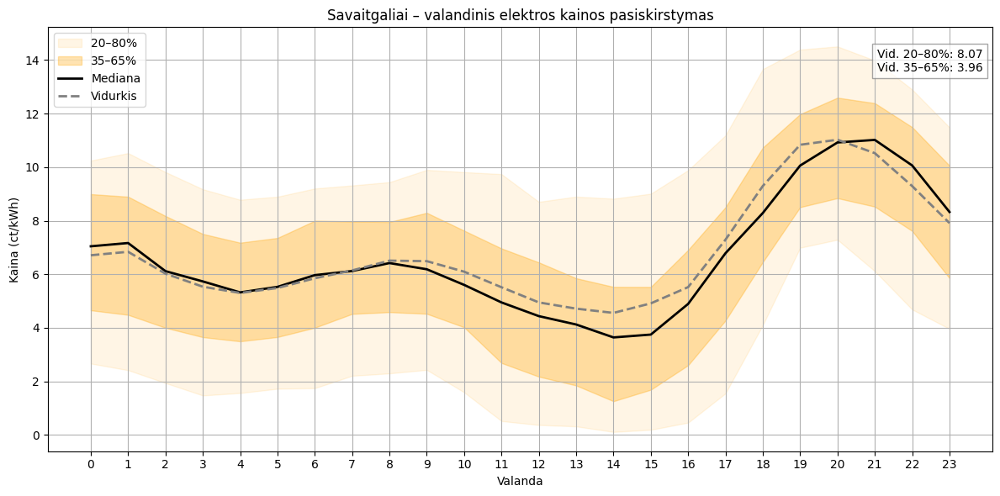

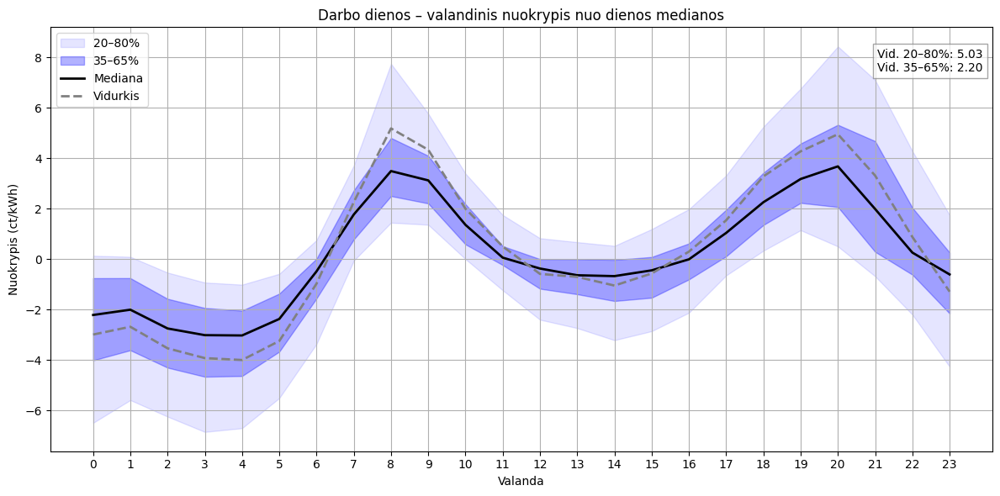

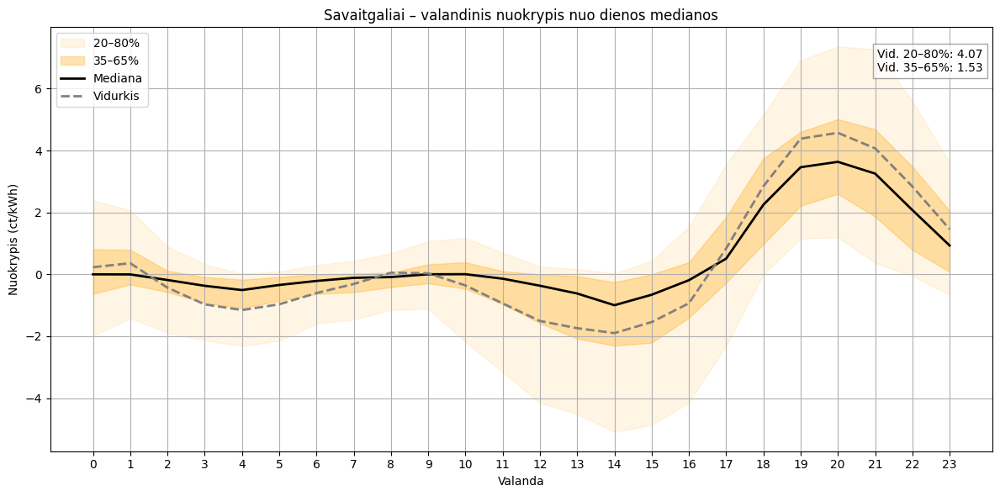

In [12]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    # Konvertuojame EUR/MWh į ct/kWh (1 EUR/MWh = 0.1 ct/kWh)
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)

    return df


def compute_hourly_stats(df: pd.DataFrame, column: str) -> pd.DataFrame:
    df['hour'] = df.index.hour
    return df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8)),
        ('Max', 'max'),
        ('Min', 'min')
    ])


def plot_hourly_distribution(stats: pd.DataFrame, title: str, ylabel: str, show_bands: bool = True, color: str = 'C0'):
    plt.figure(figsize=(12, 6))

    if show_bands:
        plt.fill_between(stats.index, stats['20%'], stats['80%'], color=color, alpha=0.1, label='20–80%')
        plt.fill_between(stats.index, stats['35%'], stats['65%'], color=color, alpha=0.3, label='35–65%')

    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()
    range_mean = (stats['Max'] - stats['Min']).mean()

    mean_20_80_pct = (mean_20_80 / range_mean) * 100 if range_mean else 0
    mean_35_65_pct = (mean_35_65 / range_mean) * 100 if range_mean else 0

    plt.text(0.99, 0.95,
             f"Vid. 20–80%: {mean_20_80:.2f} ({mean_20_80_pct:.1f}%)\nVid. 35–65%: {mean_35_65:.2f} ({mean_35_65_pct:.1f}%)",
             transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(0, 24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


def plot_hourly_deviation_from_daily_median(df: pd.DataFrame):
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')
    stats = compute_hourly_stats(df, 'deviation')
    plot_hourly_distribution(stats, "Valandinis kainos nuokrypis nuo dienos medianos", "Nuokrypis (ct/kWh)", show_bands=False)


def plot_hourly_avg_and_quantiles(df: pd.DataFrame):
    stats = compute_hourly_stats(df, 'price_ct_kwh')
    plot_hourly_distribution(stats, "Valandinis elektros kainos pasiskirstymas", "Kaina (ct/kWh)", show_bands=False)


if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)

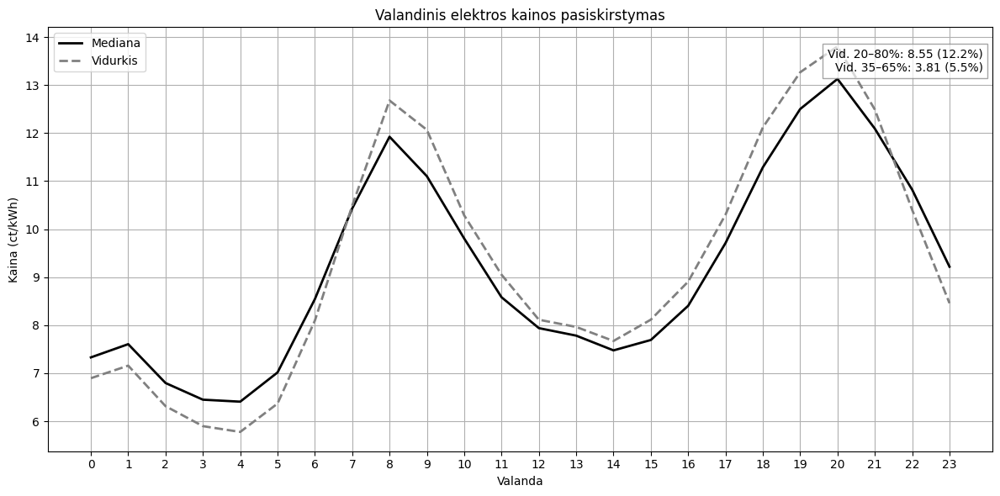

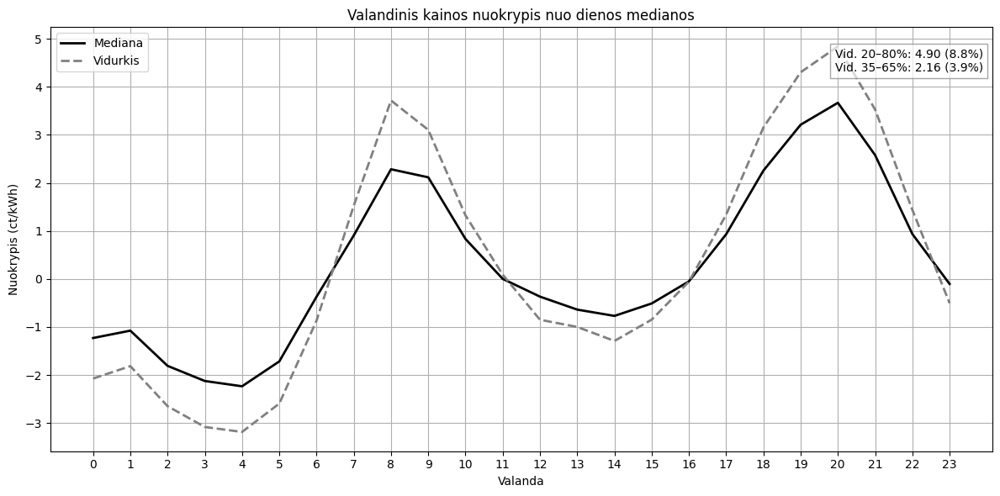

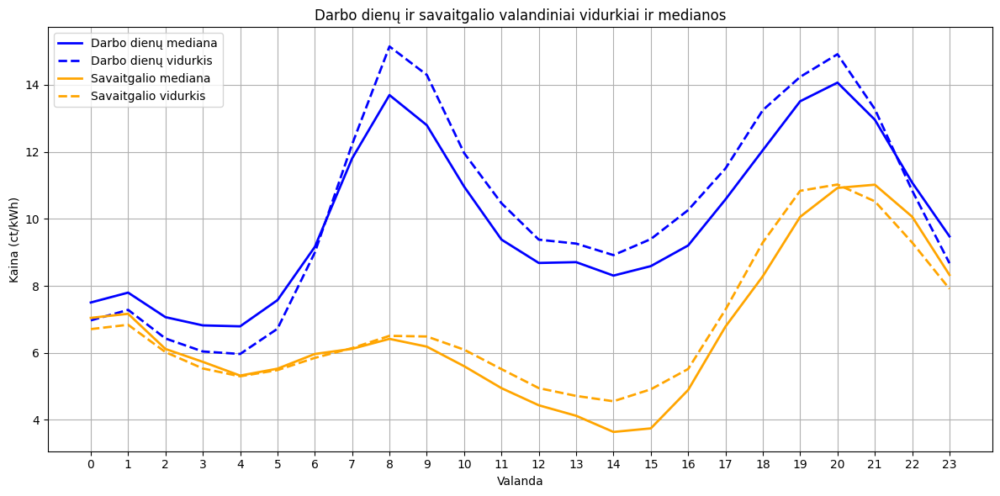

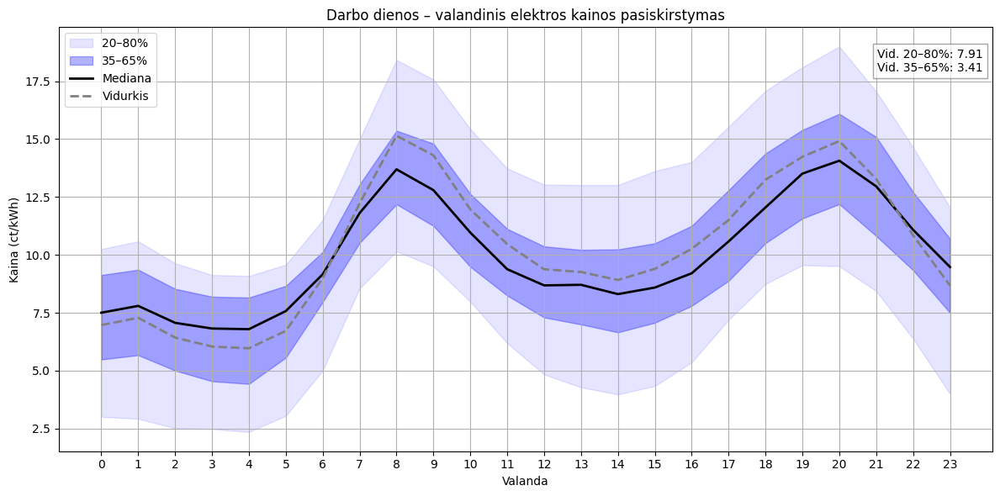

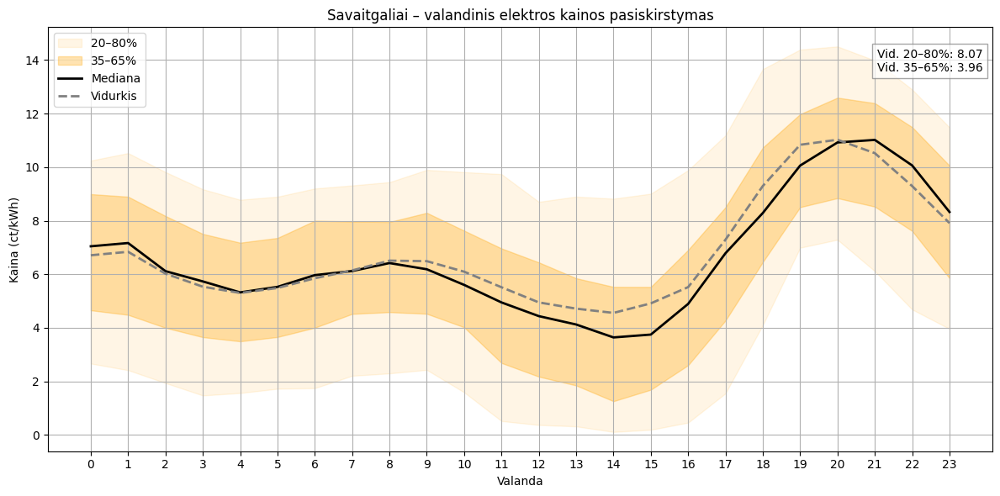

...

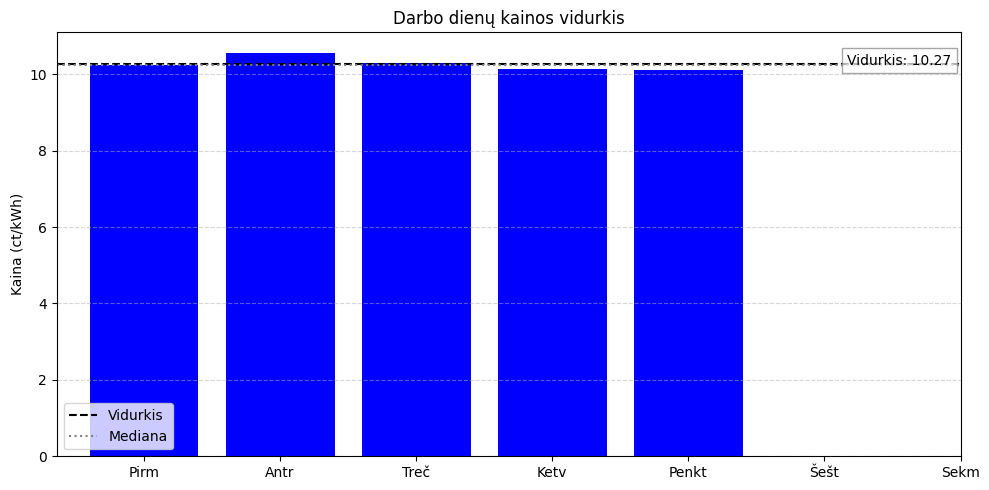

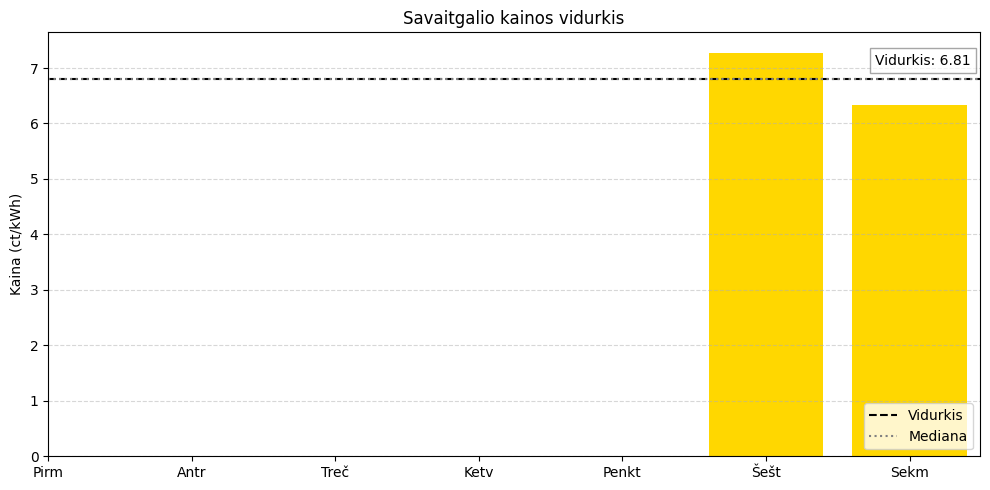

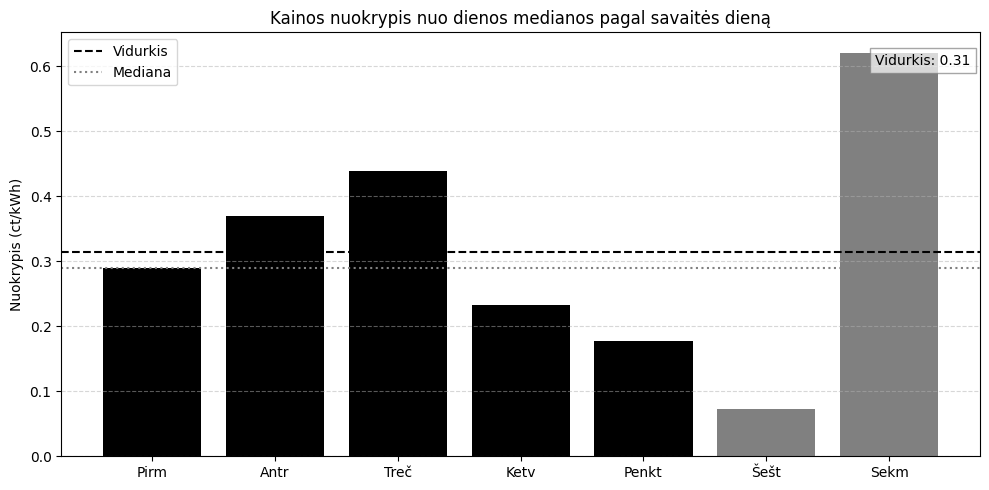

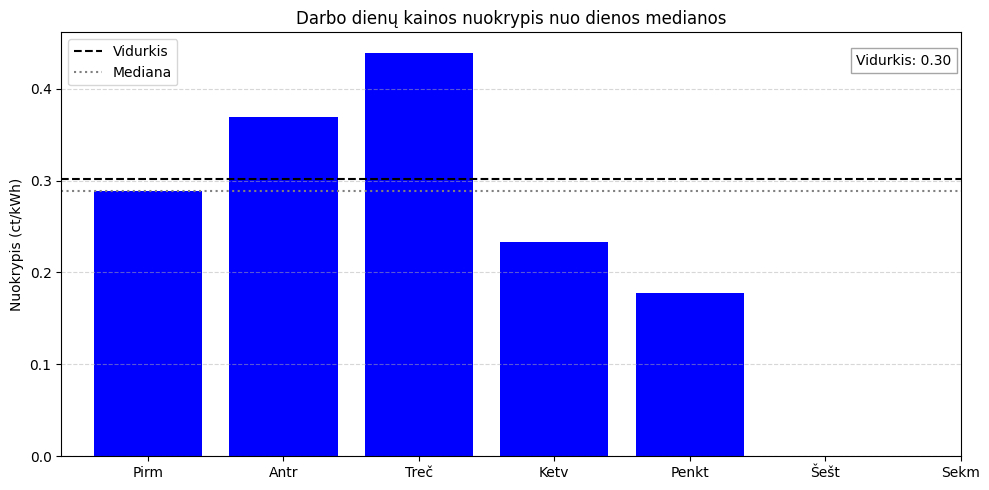

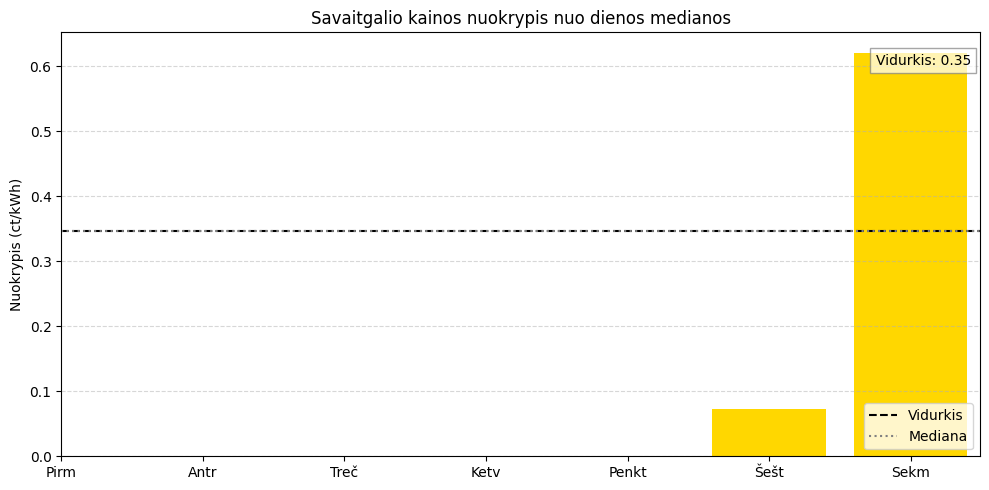

In [13]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    # Konvertuojame laiką
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)
    return df


def plot_weekday_bar_chart(data: pd.Series, title: str, ylabel: str, color: str, alt_color: str, draw_interval: bool = False, interval: pd.Series = None):
    plt.figure(figsize=(10, 5))
    weekdays = ['Pirm', 'Antr', 'Treč', 'Ketv', 'Penkt', 'Šešt', 'Sekm']
    colors = [color if i < 5 else alt_color for i in range(7)]
    data = data.reindex(range(7))  # ensure order from Monday (0) to Sunday (6)
    plt.bar(range(7), data.values, color=colors)

    mean_val = data.mean()
    plt.axhline(mean_val, color='black', linestyle='--', label='Vidurkis')
    median_val = data.median()
    plt.axhline(median_val, color='gray', linestyle=':', label='Mediana')

    label = f"Vidurkis: {mean_val:.2f}"
    if draw_interval and interval is not None:
        avg_interval = interval.mean()
        label += f"\nIntervalo vidurkis: {avg_interval:.2f}"
    plt.text(0.99, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.xticks(range(7), weekdays)
    plt.title(title)
    plt.ylabel(ylabel)
    plt.legend()
    plt.tight_layout()
    plt.grid(True, axis='y', linestyle='--', alpha=0.5)
    plt.show()


def plot_all_weekday_analyses(df: pd.DataFrame):
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    # 1. Kainos vidurkis per savaitės dienas
    weekday_price_avg = df.groupby('weekday')['price_ct_kwh'].mean()
    plot_weekday_bar_chart(weekday_price_avg, "Kainos vidurkis pagal savaitės dieną", "Kaina (ct/kWh)", 'black', 'gray')

    # 2–3. Kainos vidurkiai atskirai darbo dienoms ir savaitgaliams
    workdays_df = df[df['weekday'] < 5]
    weekend_df = df[df['weekday'] >= 5]

    workday_avg = workdays_df.groupby('weekday')['price_ct_kwh'].mean()
    weekend_avg = weekend_df.groupby('weekday')['price_ct_kwh'].mean()

    plot_weekday_bar_chart(workday_avg, "Darbo dienų kainos vidurkis", "Kaina (ct/kWh)", 'blue', 'cyan')
    plot_weekday_bar_chart(weekend_avg, "Savaitgalio kainos vidurkis", "Kaina (ct/kWh)", 'orange', 'gold')

    # 4. Nuokrypio nuo dienos medianos vidurkis per savaitės dienas
    weekday_dev_avg = df.groupby('weekday')['deviation'].mean()
    plot_weekday_bar_chart(weekday_dev_avg, "Kainos nuokrypis nuo dienos medianos pagal savaitės dieną", "Nuokrypis (ct/kWh)", 'black', 'gray')

    # 5–6. Darbo dienų ir savaitgalio nuokrypiai
    workday_dev_avg = workdays_df.groupby('weekday')['deviation'].mean()
    weekend_dev_avg = weekend_df.groupby('weekday')['deviation'].mean()

    plot_weekday_bar_chart(workday_dev_avg, "Darbo dienų kainos nuokrypis nuo dienos medianos", "Nuokrypis (ct/kWh)", 'blue', 'cyan')
    plot_weekday_bar_chart(weekend_dev_avg, "Savaitgalio kainos nuokrypis nuo dienos medianos", "Nuokrypis (ct/kWh)", 'orange', 'gold')


if __name__ == "__main__":
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    plot_hourly_avg_and_quantiles(df)
    plot_hourly_deviation_from_daily_median(df)
    plot_separated_by_weekday(df)
    plot_all_weekday_analyses(df)

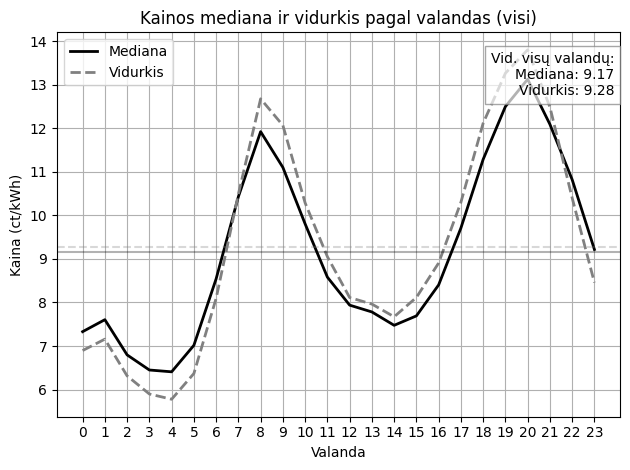

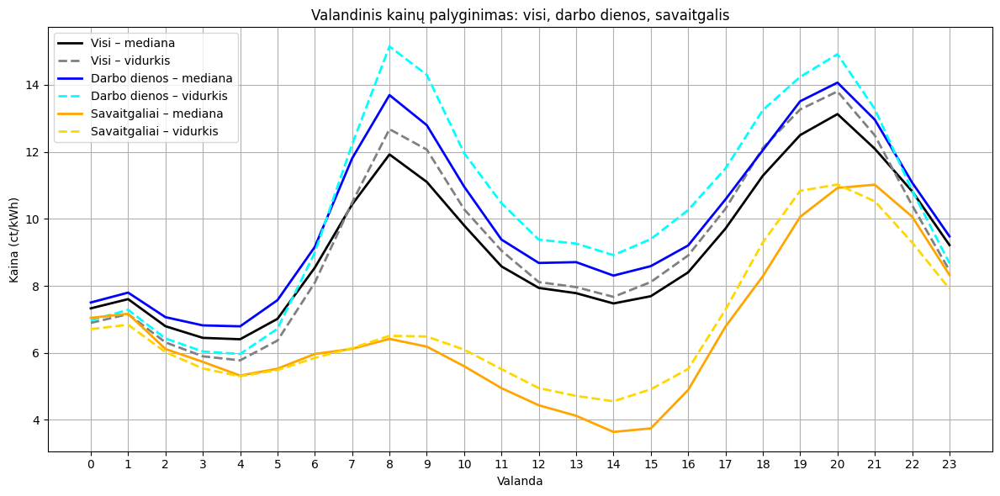

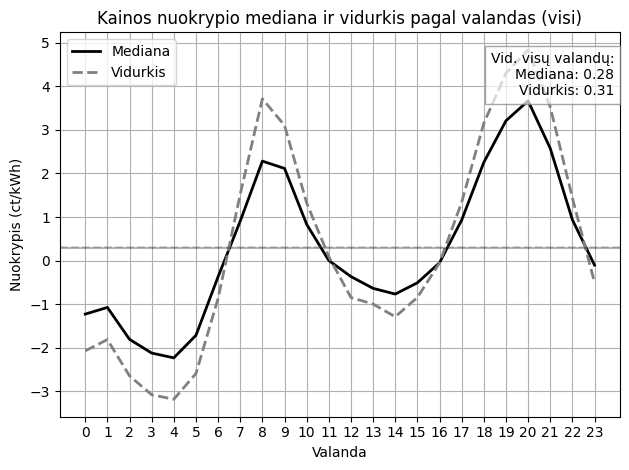

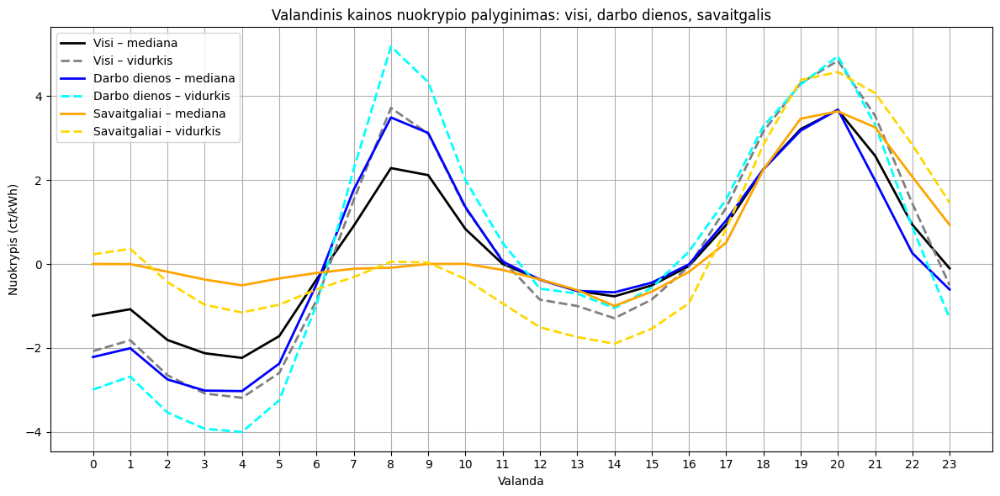

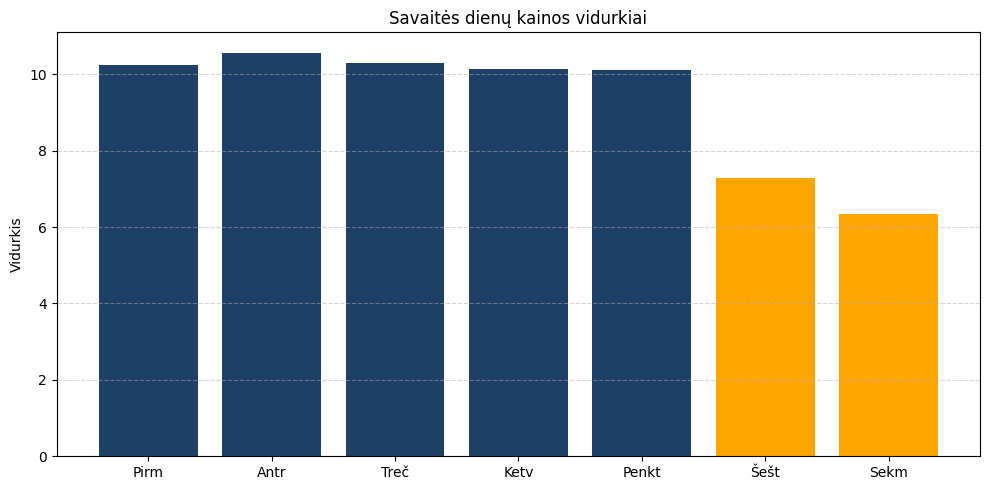

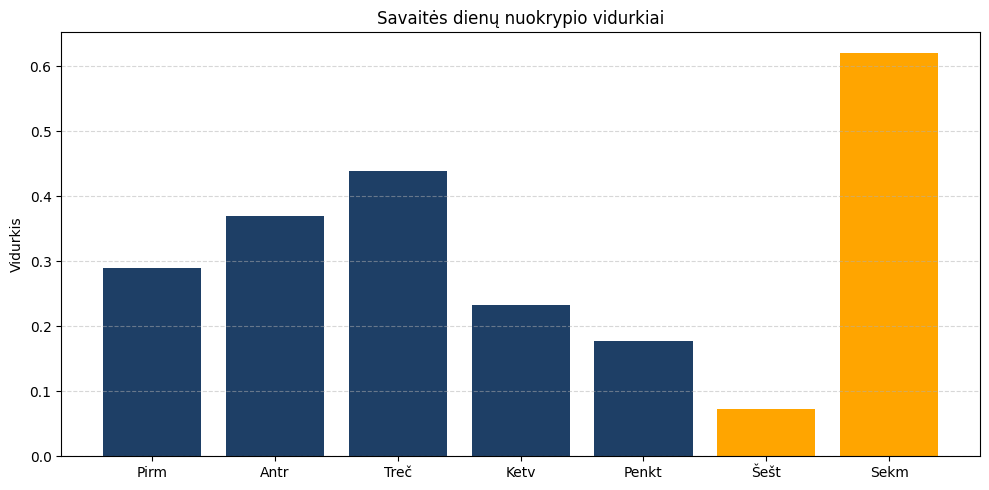

In [14]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)
    return df


def plot_hourly_line_chart(df: pd.DataFrame, column: str, title: str, ylabel: str,
                            color: str = 'black', alt_color: str = 'gray'):
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    grouped = df.groupby('hour')[column].agg(['mean', 'median'])
    plt.plot(grouped.index, grouped['median'], label='Mediana', color=color, linewidth=2)
    plt.plot(grouped.index, grouped['mean'], label='Vidurkis', color=alt_color, linestyle='--', linewidth=2)

    mean_val = grouped['mean'].mean()
    median_val = grouped['median'].mean()
    plt.axhline(mean_val, linestyle='--', color=alt_color, alpha=0.3)
    plt.axhline(median_val, linestyle='-', color=color, alpha=0.3)
    label = f"Vid. visų valandų:\nMediana: {median_val:.2f}\nVidurkis: {mean_val:.2f}"
    plt.text(0.99, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))
    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(24))
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


def plot_weekday_mean(df: pd.DataFrame, column: str, title: str, color_weekday: str, color_weekend: str):
    df['weekday'] = df.index.weekday
    weekday_means = df.groupby('weekday')[column].mean()
    colors = [color_weekday if i < 5 else color_weekend for i in range(7)]
    labels = ['Pirm', 'Antr', 'Treč', 'Ketv', 'Penkt', 'Šešt', 'Sekm']

    plt.figure(figsize=(10, 5))
    plt.bar(range(7), weekday_means.values, color=colors)
    plt.xticks(range(7), labels)
    plt.title(title)
    plt.ylabel("Vidurkis")
    plt.tight_layout()
    plt.grid(True, axis='y', linestyle='--', alpha=0.5)
    plt.show()


def plot_combined_line_graphs(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday

    full = df.groupby('hour')[column].agg(['mean', 'median'])
    work = df[df['weekday'] < 5].groupby('hour')[column].agg(['mean', 'median'])
    weekend = df[df['weekday'] >= 5].groupby('hour')[column].agg(['mean', 'median'])

    plt.figure(figsize=(12, 6))
    plt.plot(full.index, full['median'], color='black', label='Visi – mediana', linewidth=2)
    plt.plot(full.index, full['mean'], color='gray', linestyle='--', label='Visi – vidurkis', linewidth=2)
    plt.plot(work.index, work['median'], color='blue', label='Darbo dienos – mediana', linewidth=2)
    plt.plot(work.index, work['mean'], color='cyan', linestyle='--', label='Darbo dienos – vidurkis', linewidth=2)
    plt.plot(weekend.index, weekend['median'], color='orange', label='Savaitgaliai – mediana', linewidth=2)
    plt.plot(weekend.index, weekend['mean'], color='gold', linestyle='--', label='Savaitgaliai – vidurkis', linewidth=2)

    plt.title(title)
    plt.xlabel("Valanda")
    plt.ylabel(ylabel)
    plt.xticks(range(24))
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    # Kainos kreivės (bendros ašys, be kvantilių)
    plot_hourly_line_chart(df, 'price_ct_kwh', 'Kainos mediana ir vidurkis pagal valandas (visi)', 'Kaina (ct/kWh)')
    plot_combined_line_graphs(df, 'price_ct_kwh', 'Valandinis kainų palyginimas: visi, darbo dienos, savaitgalis', 'Kaina (ct/kWh)')

    # Nuokrypio kreivės
    plot_hourly_line_chart(df, 'deviation', 'Kainos nuokrypio mediana ir vidurkis pagal valandas (visi)', 'Nuokrypis (ct/kWh)')
    plot_combined_line_graphs(df, 'deviation', 'Valandinis kainos nuokrypio palyginimas: visi, darbo dienos, savaitgalis', 'Nuokrypis (ct/kWh)')

    # Savaitės dienų vidurkiai be papildomų duomenų
    plot_weekday_mean(df, 'price_ct_kwh', 'Savaitės dienų kainos vidurkiai', '#1e3f66', 'orange')
    plot_weekday_mean(df, 'deviation', 'Savaitės dienų nuokrypio vidurkiai', '#1e3f66', 'orange')


if __name__ == "__main__":
    main()

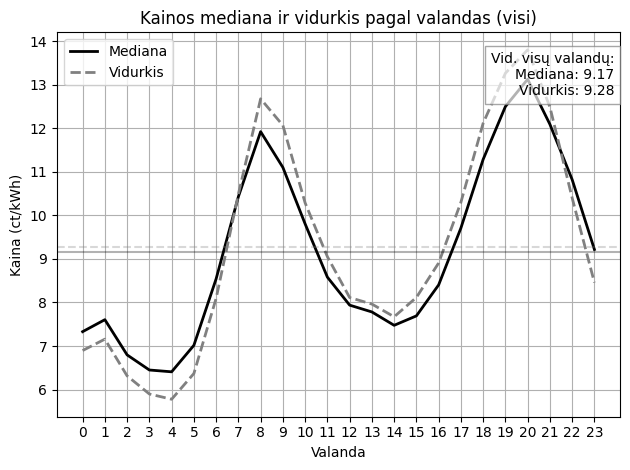

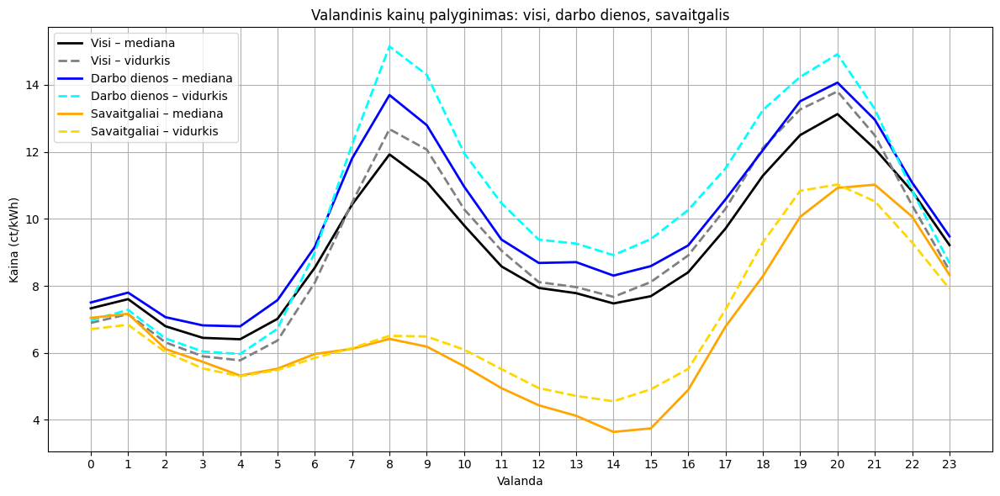

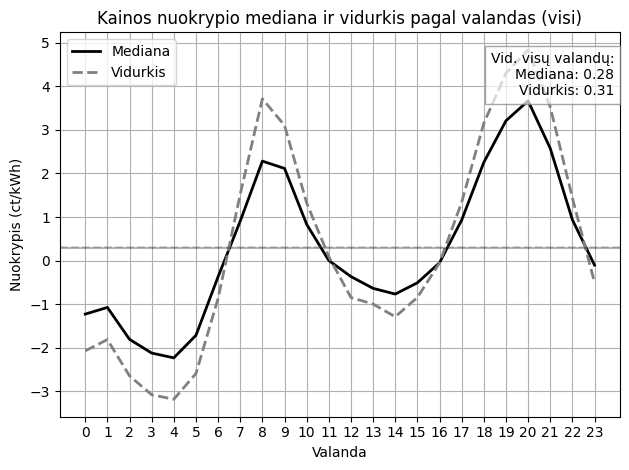

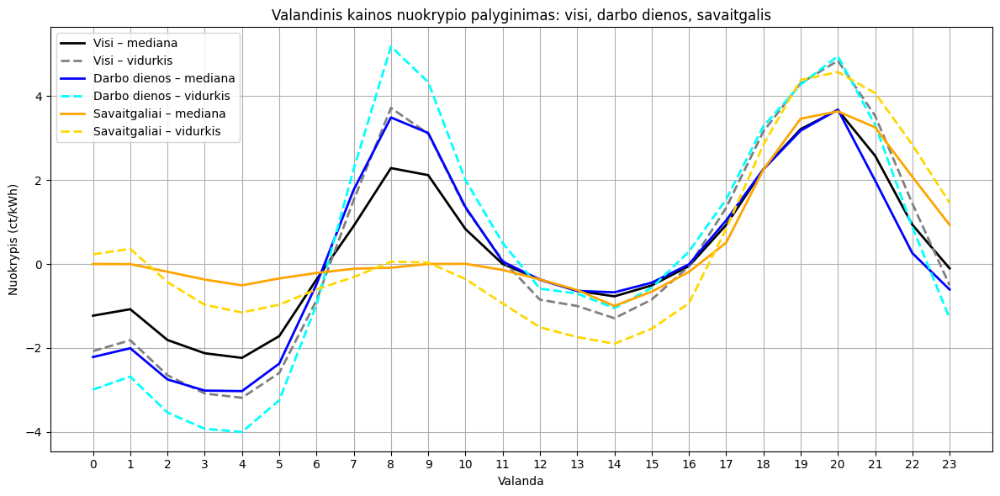

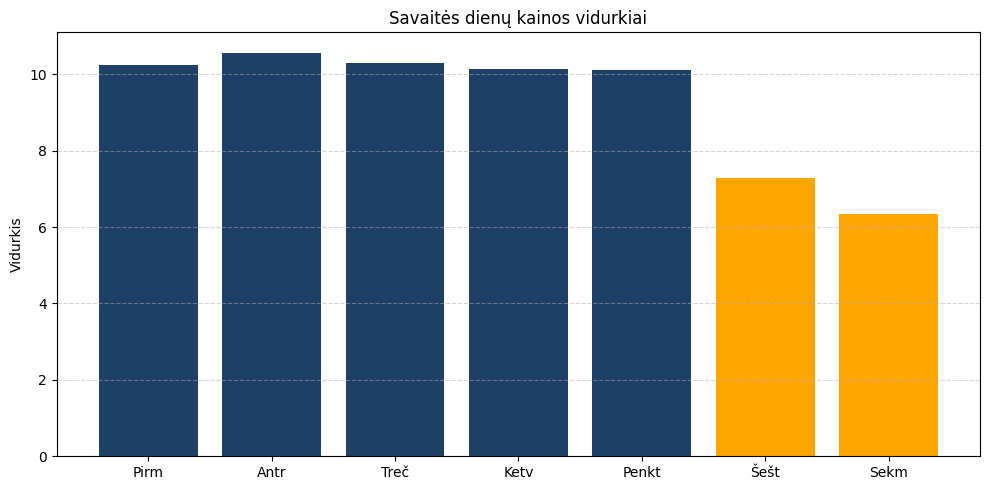

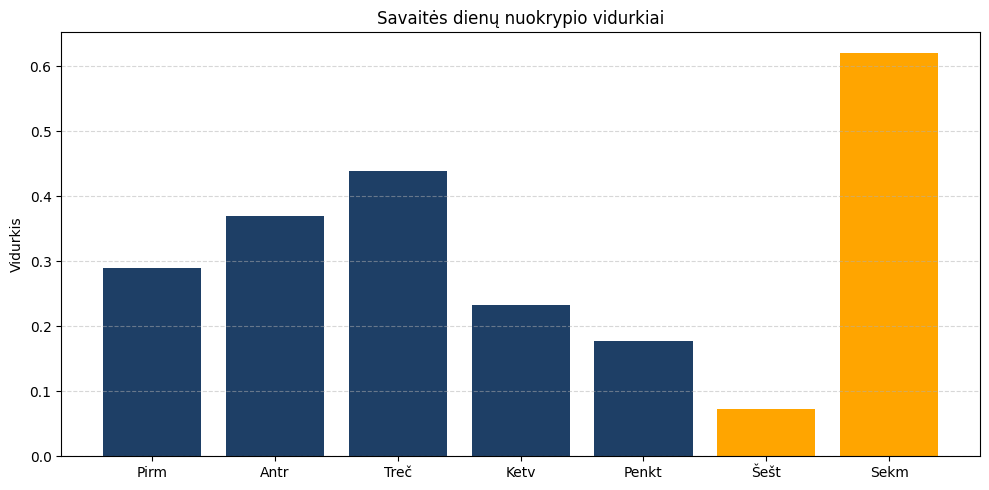

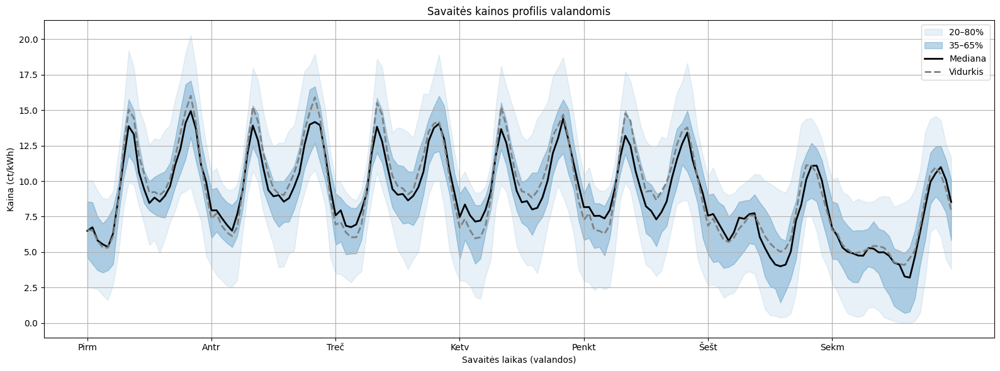

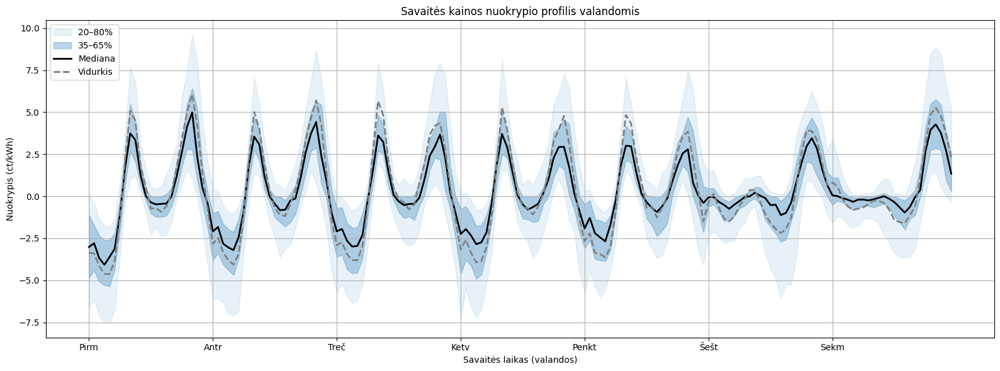

In [15]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)
    return df


def plot_week_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['weekhour'] = df['weekday'] * 24 + df['hour']  # nuo 0 (Pirm 00:00) iki 167 (Sekm 23:00)

    stats = df.groupby('weekhour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    plt.figure(figsize=(16, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    plt.title(title)
    plt.xlabel("Savaitės laikas (valandos)")
    plt.ylabel(ylabel)
    plt.xticks(ticks=[i * 24 for i in range(7)], labels=['Pirm', 'Antr', 'Treč', 'Ketv', 'Penkt', 'Šešt', 'Sekm'])
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    # Paprasti grafikai
    plot_hourly_line_chart(df, 'price_ct_kwh', 'Kainos mediana ir vidurkis pagal valandas (visi)', 'Kaina (ct/kWh)')
    plot_combined_line_graphs(df, 'price_ct_kwh', 'Valandinis kainų palyginimas: visi, darbo dienos, savaitgalis', 'Kaina (ct/kWh)')
    plot_hourly_line_chart(df, 'deviation', 'Kainos nuokrypio mediana ir vidurkis pagal valandas (visi)', 'Nuokrypis (ct/kWh)')
    plot_combined_line_graphs(df, 'deviation', 'Valandinis kainos nuokrypio palyginimas: visi, darbo dienos, savaitgalis', 'Nuokrypis (ct/kWh)')

    # Savaitės dienų vidurkiai
    plot_weekday_mean(df, 'price_ct_kwh', 'Savaitės dienų kainos vidurkiai', '#1e3f66', 'orange')
    plot_weekday_mean(df, 'deviation', 'Savaitės dienų nuokrypio vidurkiai', '#1e3f66', 'orange')

    # Savaitės profilis valandomis
    plot_week_profile(df, 'price_ct_kwh', 'Savaitės kainos profilis valandomis', 'Kaina (ct/kWh)')
    plot_week_profile(df, 'deviation', 'Savaitės kainos nuokrypio profilis valandomis', 'Nuokrypis (ct/kWh)')


if __name__ == "__main__":
    main()

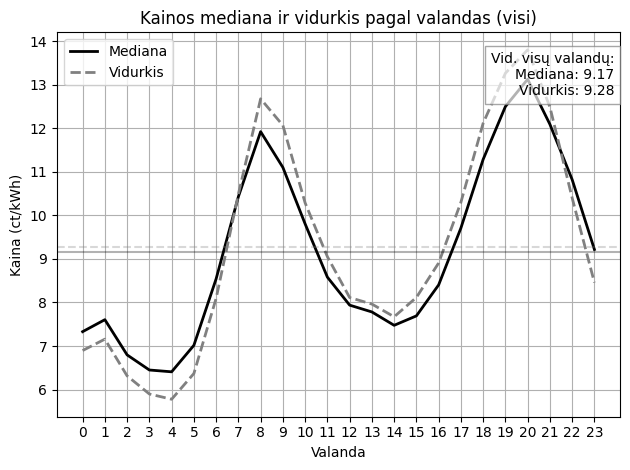

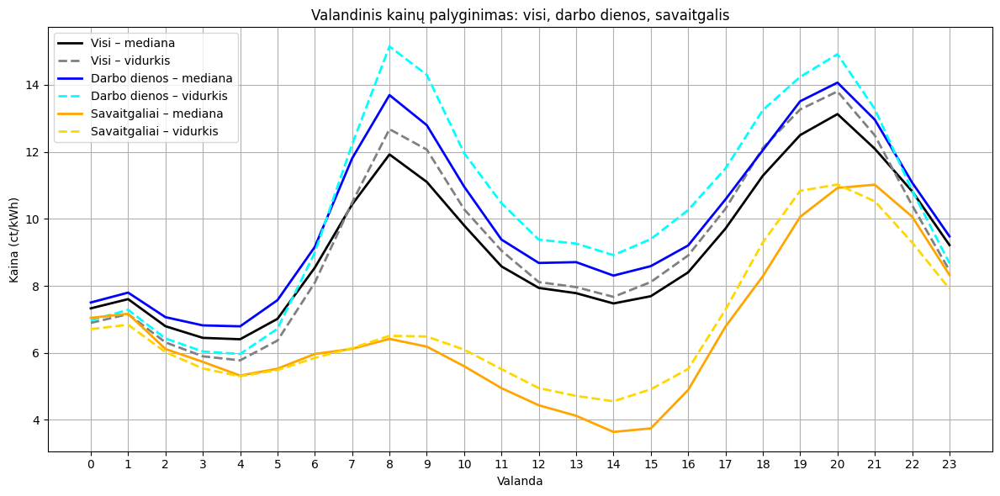

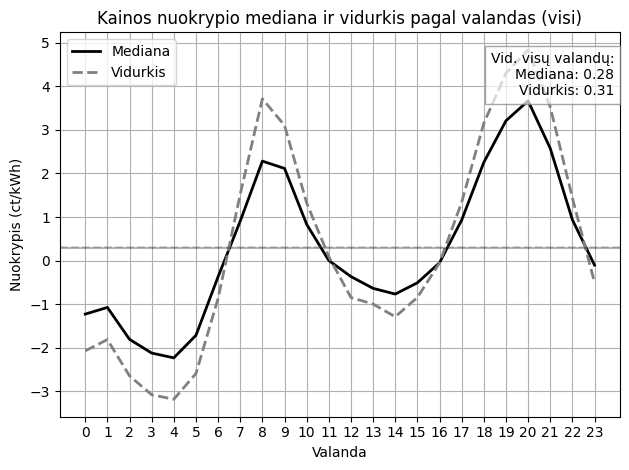

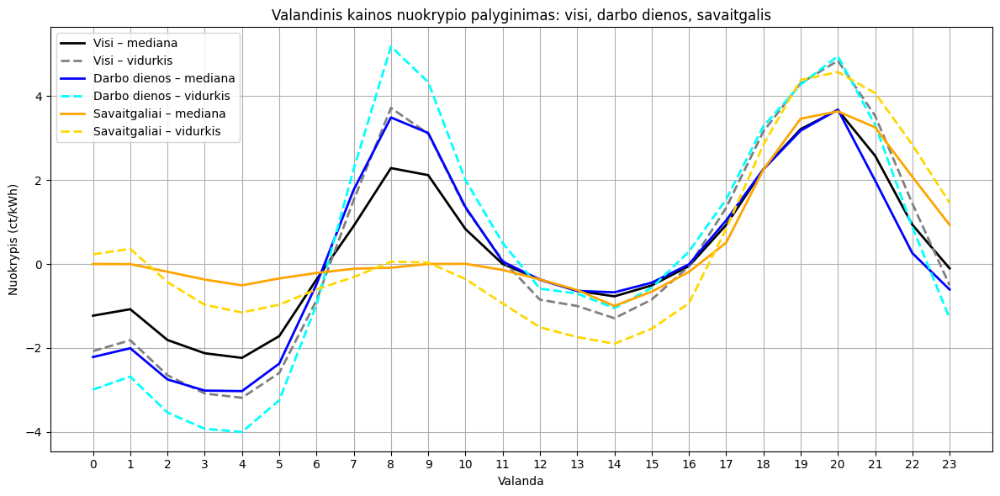

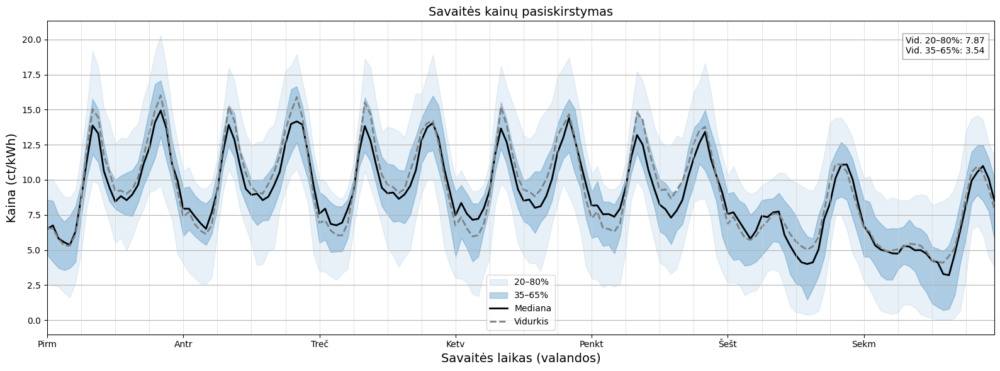

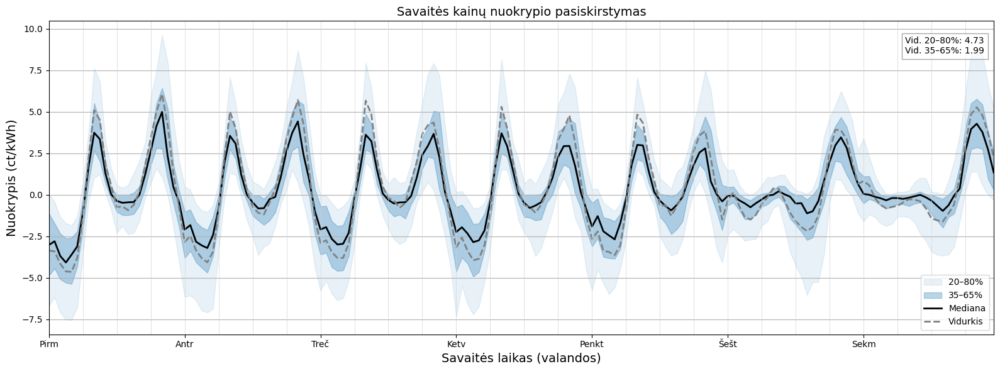

In [16]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)
    return df


def plot_week_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['weekhour'] = df['weekday'] * 24 + df['hour']  # nuo 0 (Pirm 00:00) iki 167 (Sekm 23:00)

    stats = df.groupby('weekhour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    avg_20_80 = (stats['80%'] - stats['20%']).mean()
    avg_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(16, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    plt.title(title, fontsize=14)
    plt.xlabel("Savaitės laikas (valandos)", fontsize=14)
    plt.ylabel(ylabel, fontsize=14)
    plt.xticks(ticks=[i * 24 for i in range(7)], labels=['Pirm', 'Antr', 'Treč', 'Ketv', 'Penkt', 'Šešt', 'Sekm'])
    for hour in range(0, 168, 6):
        plt.axvline(x=hour, color='lightgray', linewidth=0.5)

    label = f"Vid. 20–80%: {avg_20_80:.2f}\nVid. 35–65%: {avg_35_65:.2f}"
    plt.text(0.99, 0.95, label, transform=plt.gca().transAxes, ha='right', va='top', fontsize=10,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.grid(True, axis='y')
    plt.legend()
    plt.margins(x=0)  # Pašalina paraštes kairėje/dešinėje
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    # Paprasti grafikai
    plot_hourly_line_chart(df, 'price_ct_kwh', 'Kainos mediana ir vidurkis pagal valandas (visi)', 'Kaina (ct/kWh)')
    plot_combined_line_graphs(df, 'price_ct_kwh', 'Valandinis kainų palyginimas: visi, darbo dienos, savaitgalis', 'Kaina (ct/kWh)')
    plot_hourly_line_chart(df, 'deviation', 'Kainos nuokrypio mediana ir vidurkis pagal valandas (visi)', 'Nuokrypis (ct/kWh)')
    plot_combined_line_graphs(df, 'deviation', 'Valandinis kainos nuokrypio palyginimas: visi, darbo dienos, savaitgalis', 'Nuokrypis (ct/kWh)')

    # Savaitės profilis valandomis
    plot_week_profile(df, 'price_ct_kwh', 'Savaitės kainų pasiskirstymas', 'Kaina (ct/kWh)')
    plot_week_profile(df, 'deviation', 'Savaitės kainų nuokrypio pasiskirstymas', 'Nuokrypis (ct/kWh)')


if __name__ == "__main__":
    main()


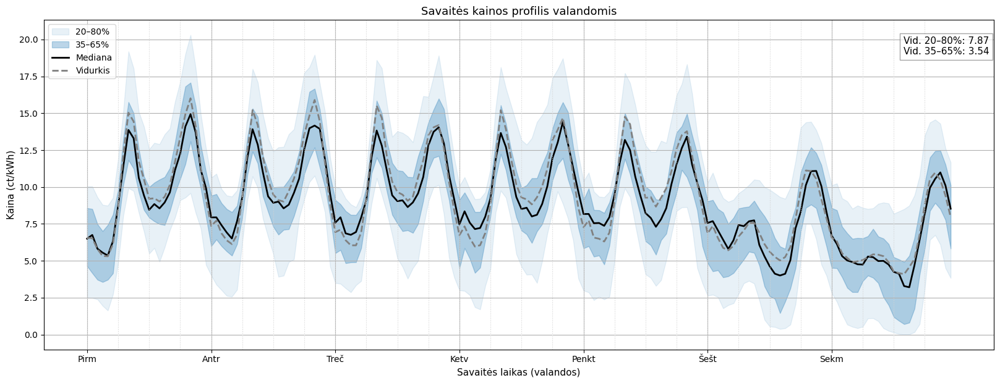

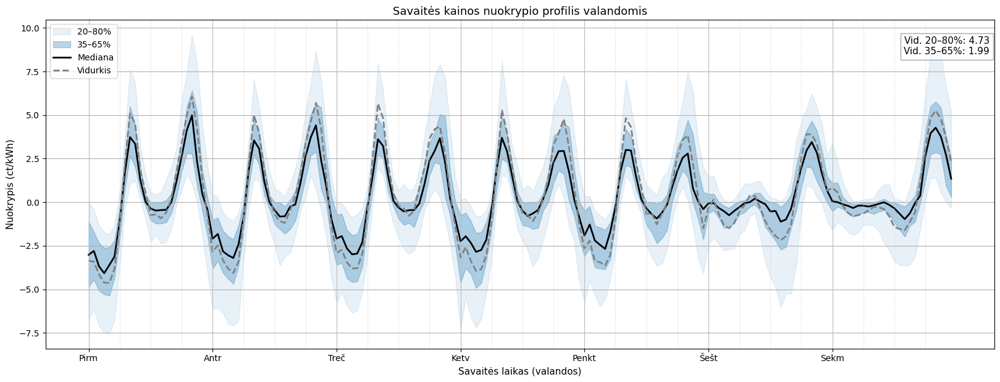

In [17]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)
    return df


def plot_week_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['weekhour'] = df['weekday'] * 24 + df['hour']

    stats = df.groupby('weekhour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(16, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=11,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    for h in range(0, 168, 6):
        plt.axvline(x=h, color='lightgray', linestyle=':', linewidth=0.8)

    plt.title(title, fontsize=13)
    plt.xlabel("Savaitės laikas (valandos)", fontsize=11)
    plt.ylabel(ylabel, fontsize=11)
    plt.xticks(ticks=[i * 24 for i in range(7)], labels=['Pirm', 'Antr', 'Treč', 'Ketv', 'Penkt', 'Šešt', 'Sekm'], fontsize=10)
    plt.yticks(fontsize=10)
    plt.grid(True)
    plt.legend(fontsize=10)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.02, right=0.98)
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    plot_week_profile(df, 'price_ct_kwh', 'Savaitės kainos profilis valandomis', 'Kaina (ct/kWh)')
    plot_week_profile(df, 'deviation', 'Savaitės kainos nuokrypio profilis valandomis', 'Nuokrypis (ct/kWh)')


if __name__ == "__main__":
    main()


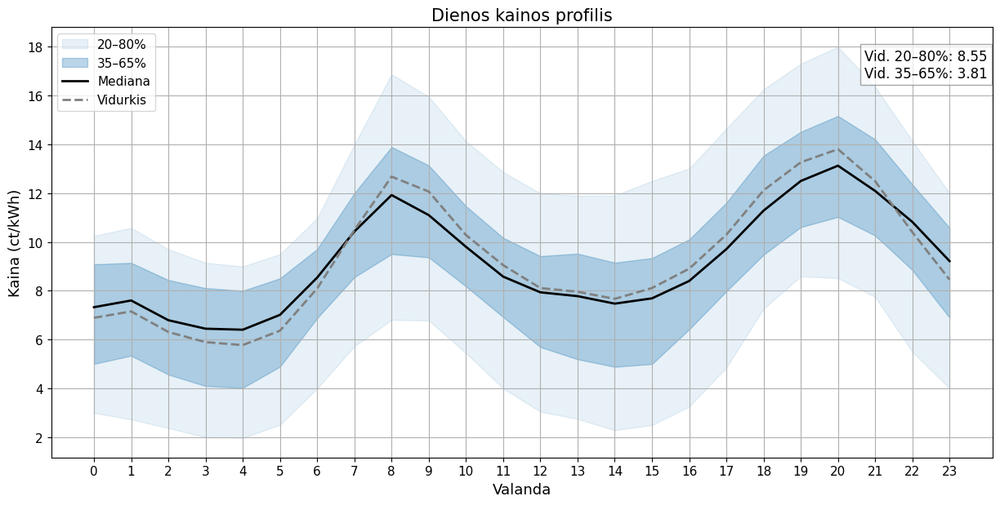

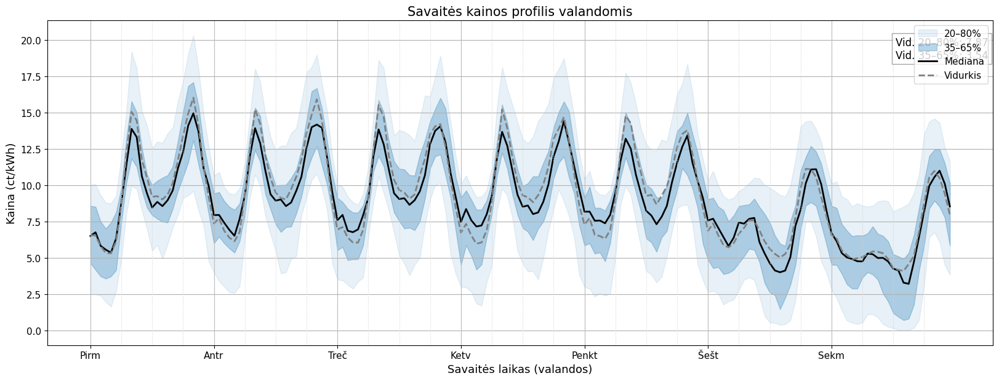

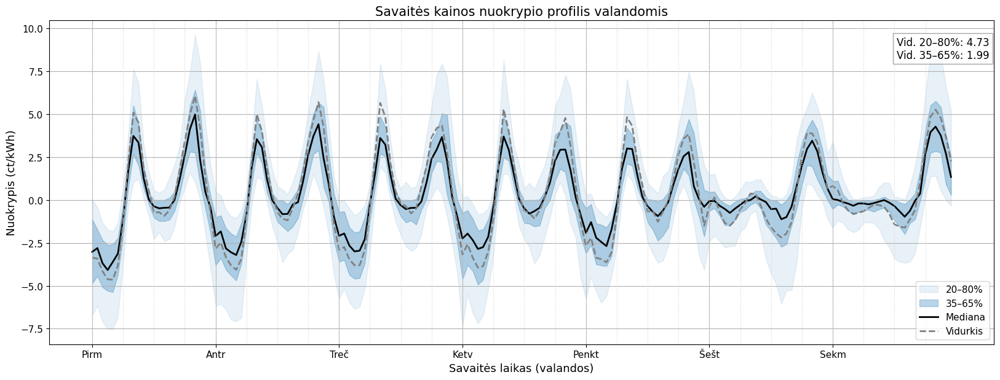

In [18]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)

    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1

    df.set_index('local_time', inplace=True)
    return df


def plot_day_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['hour'] = df.index.hour
    stats = df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=12,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title, fontsize=15)
    plt.xlabel("Valanda", fontsize=13)
    plt.ylabel(ylabel, fontsize=13)
    plt.xticks(range(24), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.02, right=0.98)
    plt.show()


def plot_week_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['weekhour'] = df['weekday'] * 24 + df['hour']

    stats = df.groupby('weekhour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(16, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=12,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    for h in range(0, 168, 6):
        plt.axvline(x=h, color='lightgray', linestyle=':', linewidth=0.8)

    plt.title(title, fontsize=15)
    plt.xlabel("Savaitės laikas (valandos)", fontsize=13)
    plt.ylabel(ylabel, fontsize=13)
    plt.xticks(ticks=[i * 24 for i in range(7)], labels=['Pirm', 'Antr', 'Treč', 'Ketv', 'Penkt', 'Šešt', 'Sekm'], fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.02, right=0.98)
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    plot_day_profile(df, 'price_ct_kwh', 'Dienos kainos profilis', 'Kaina (ct/kWh)')
    plot_week_profile(df, 'price_ct_kwh', 'Savaitės kainos profilis valandomis', 'Kaina (ct/kWh)')
    plot_week_profile(df, 'deviation', 'Savaitės kainos nuokrypio profilis valandomis', 'Nuokrypis (ct/kWh)')


if __name__ == "__main__":
    main()

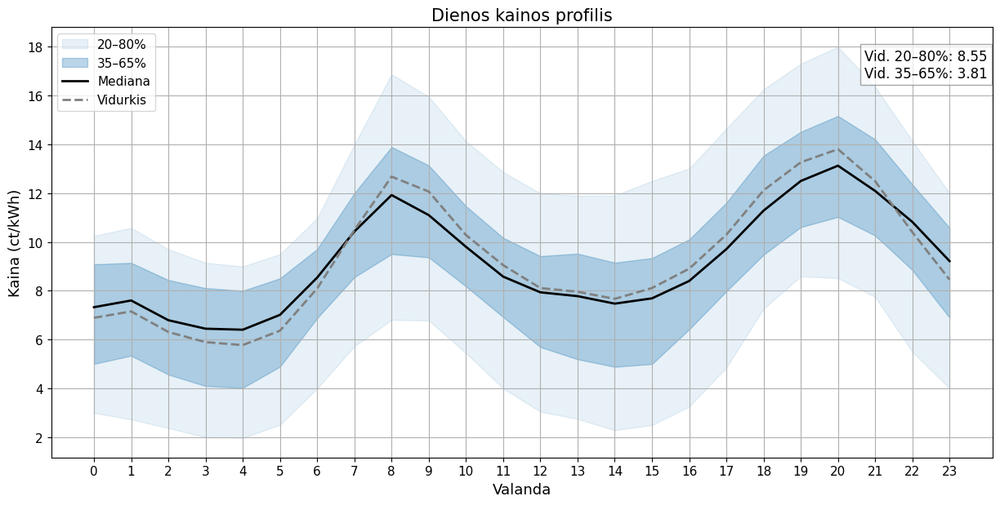

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


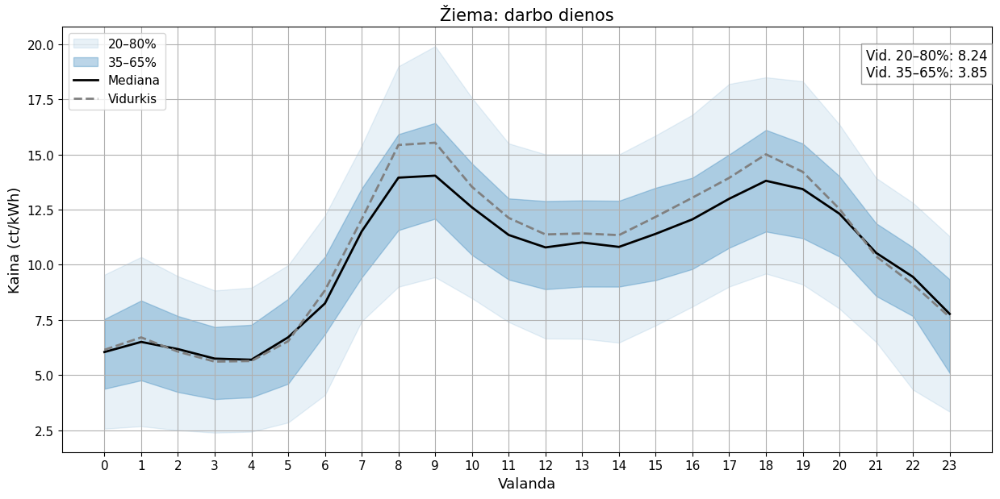

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


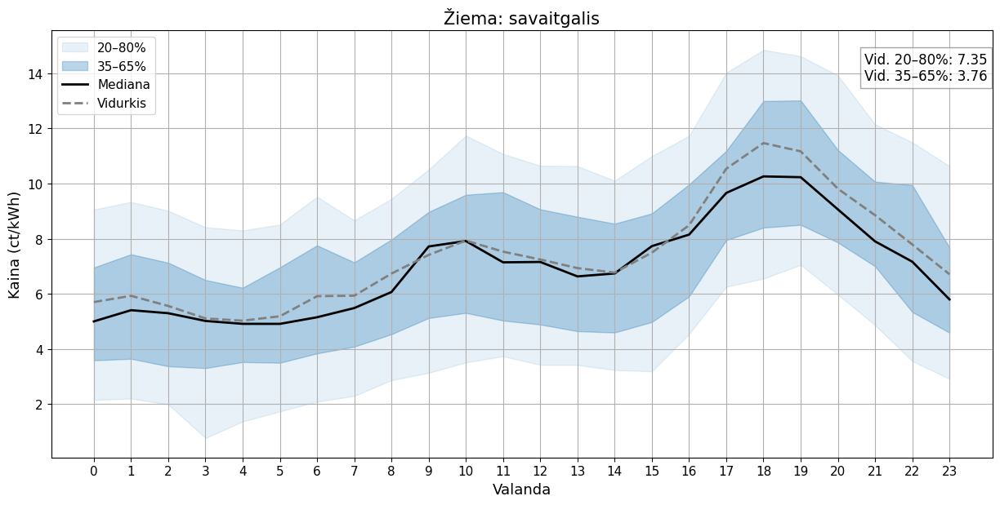

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


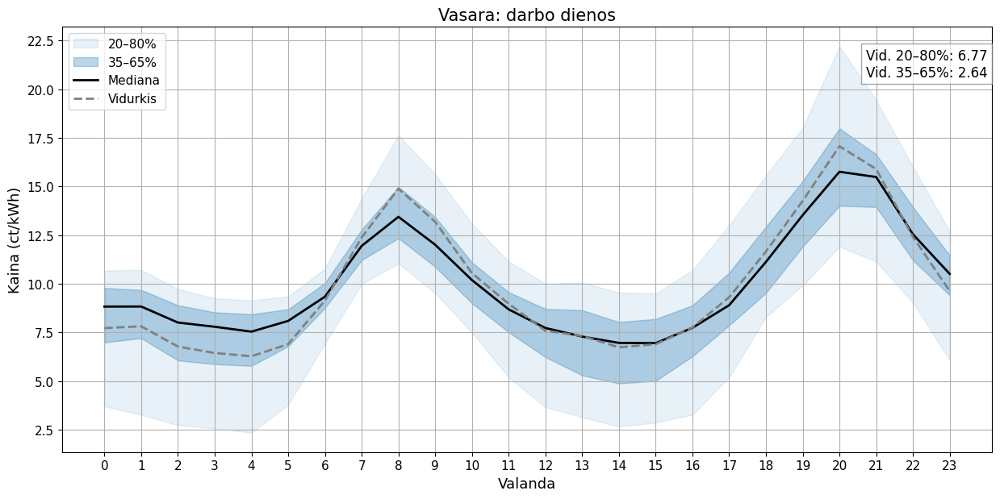

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


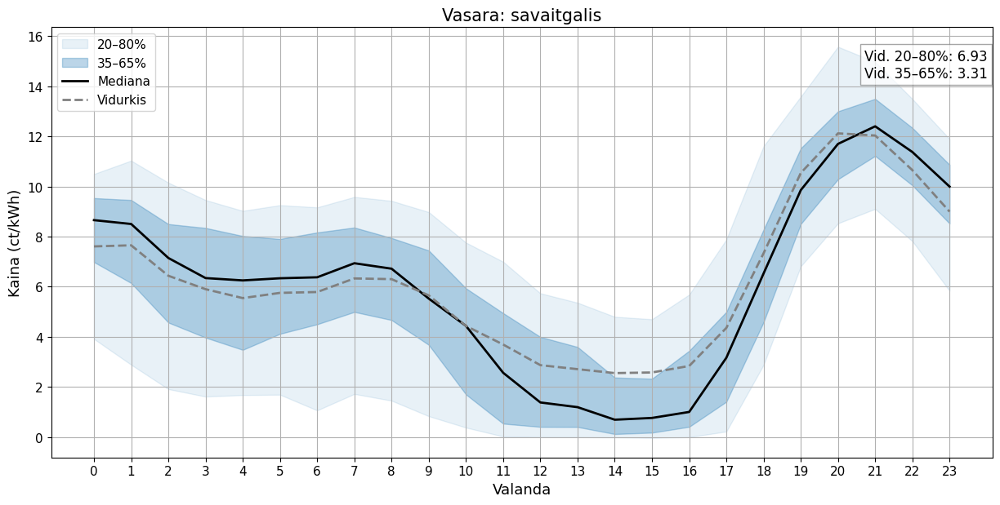

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


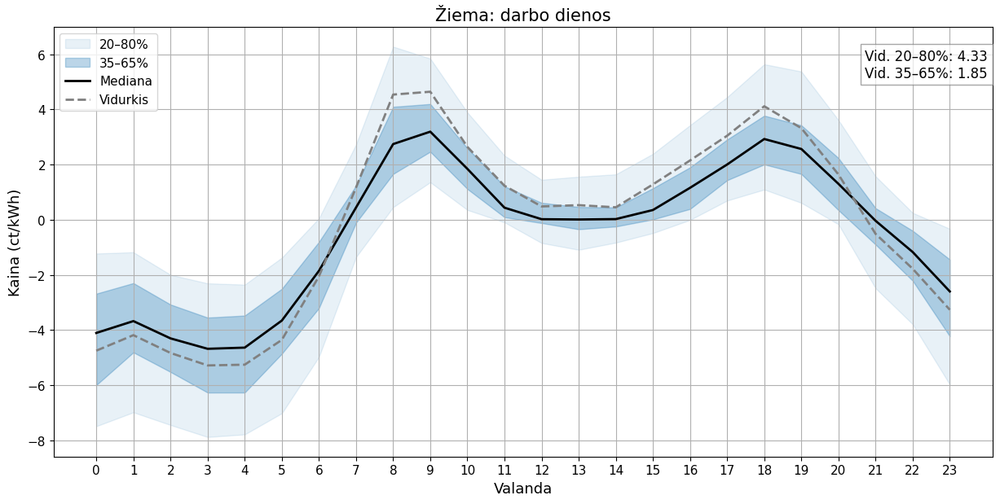

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


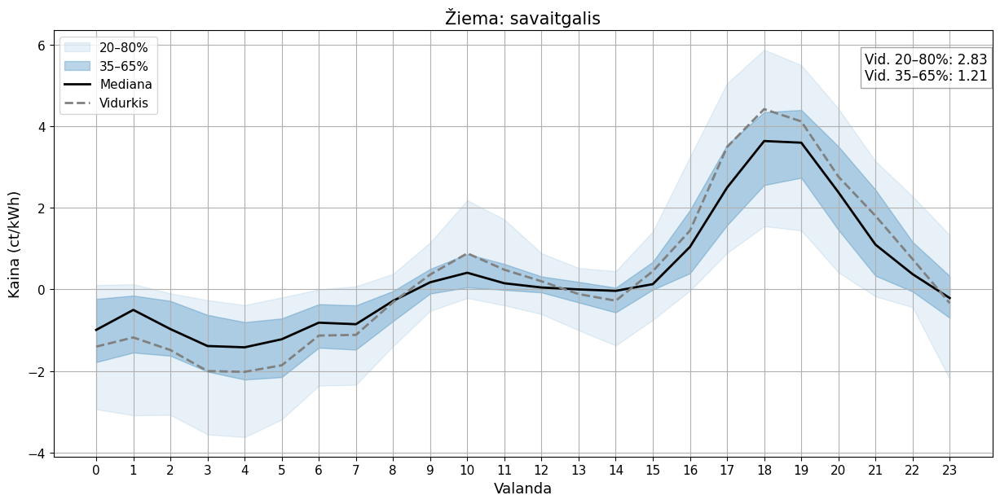

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


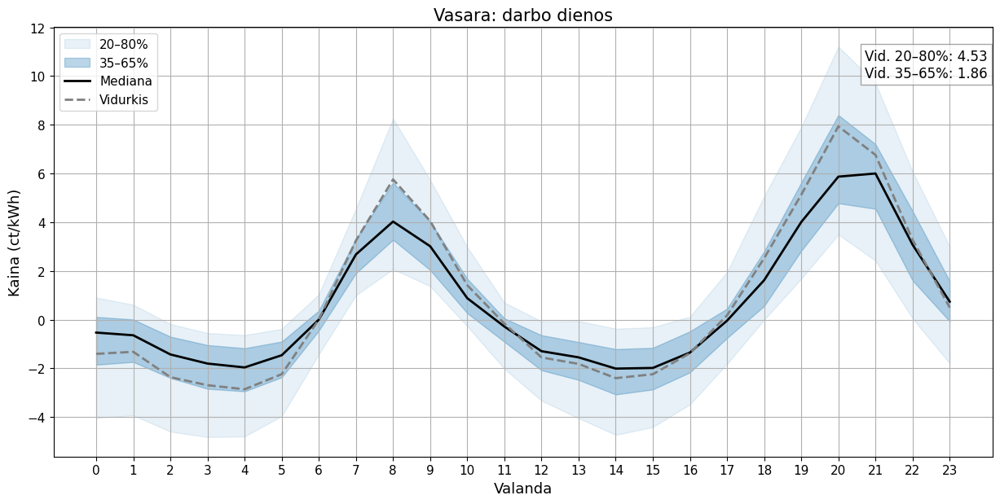

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\3729798417.py:19: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


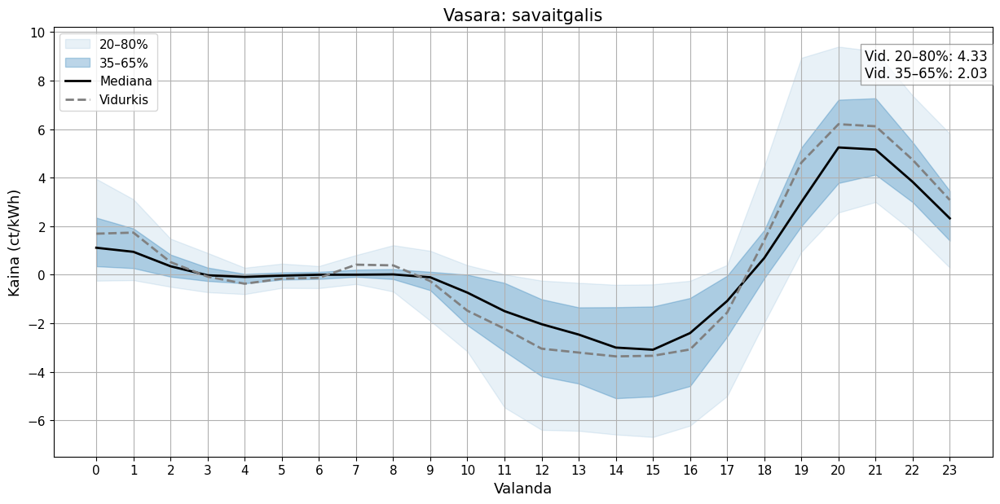

In [19]:
import requests
import pandas as pd
import matplotlib.pyplot as plt


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_day_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['hour'] = df.index.hour
    stats = df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=12,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title, fontsize=15)
    plt.xlabel("Valanda", fontsize=13)
    plt.ylabel(ylabel, fontsize=13)
    plt.xticks(range(24), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.02, right=0.98)
    plt.show()


def plot_day_profiles_by_season(df: pd.DataFrame, column: str):
    df['hour'] = df.index.hour
    df['month'] = df.index.month
    df['weekday'] = df.index.weekday

    winter_df = df[(df['month'] < 4) | (df['month'] > 10)]
    summer_df = df[(df['month'] >= 4) & (df['month'] <= 10)]

    for season_df, label in [(winter_df, 'Žiema'), (summer_df, 'Vasara')]:
        workdays = season_df[season_df['weekday'] < 5]
        weekends = season_df[season_df['weekday'] >= 5]
        plot_day_profile(workdays, column, f"{label}: darbo dienos", "Kaina (ct/kWh)")
        plot_day_profile(weekends, column, f"{label}: savaitgalis", "Kaina (ct/kWh)")


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)

    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date
    df['deviation'] = df['price_ct_kwh'] - df.groupby('date')['price_ct_kwh'].transform('median')

    plot_day_profile(df, 'price_ct_kwh', 'Dienos kainos profilis', 'Kaina (ct/kWh)')
    plot_day_profiles_by_season(df, 'price_ct_kwh')
    plot_day_profiles_by_season(df, 'deviation')


if __name__ == "__main__":
    main()


C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


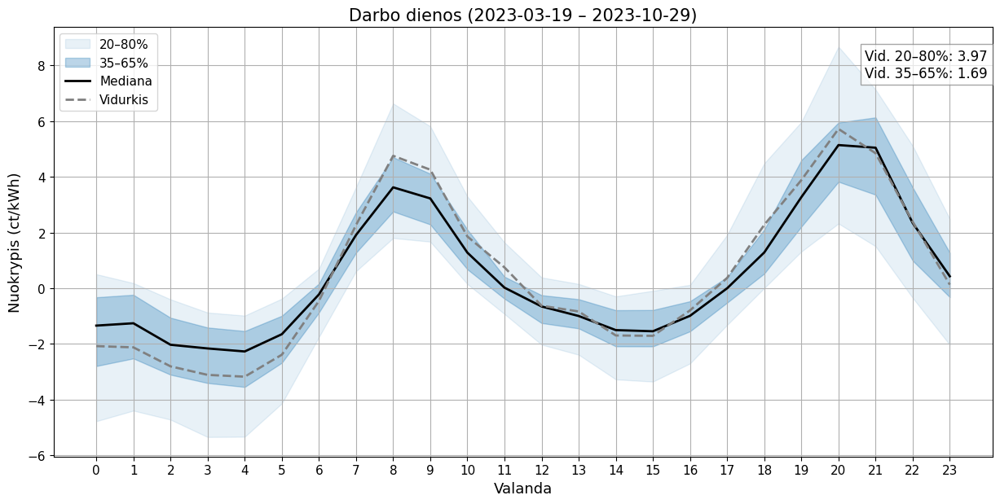

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


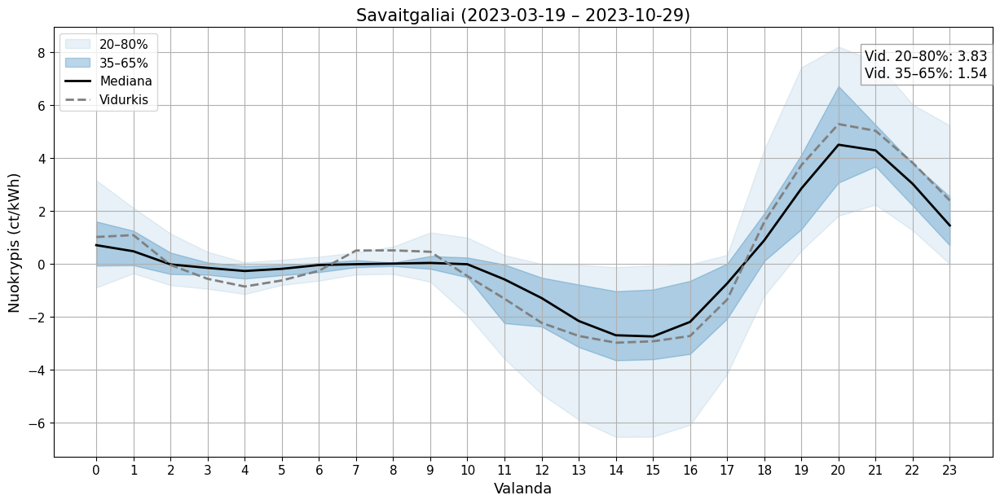

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


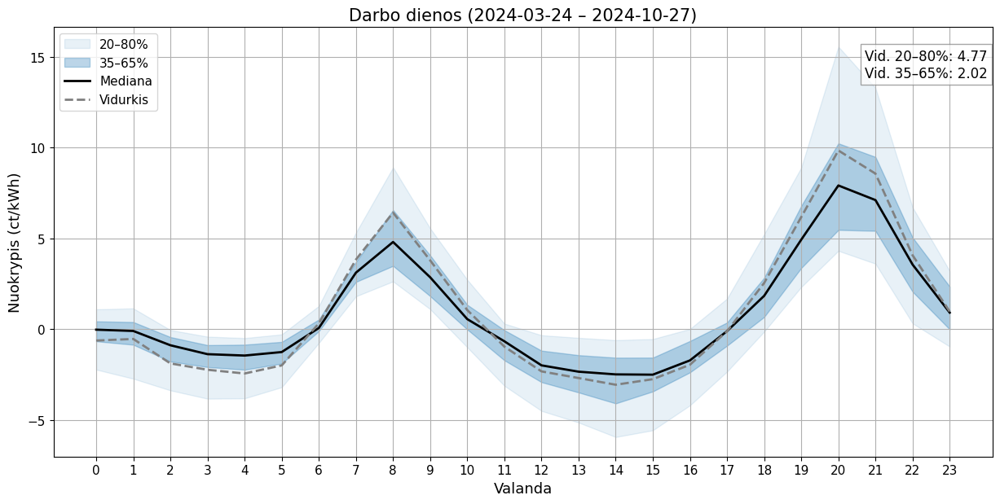

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


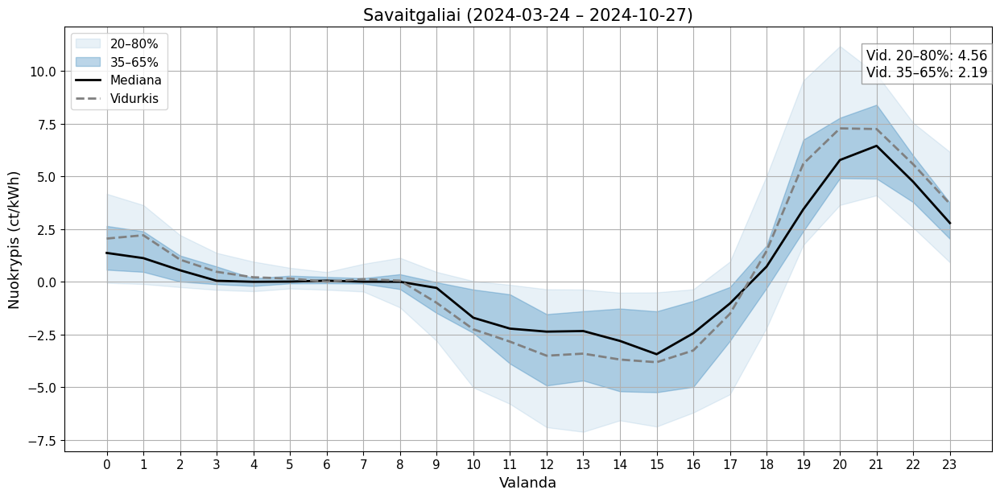

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


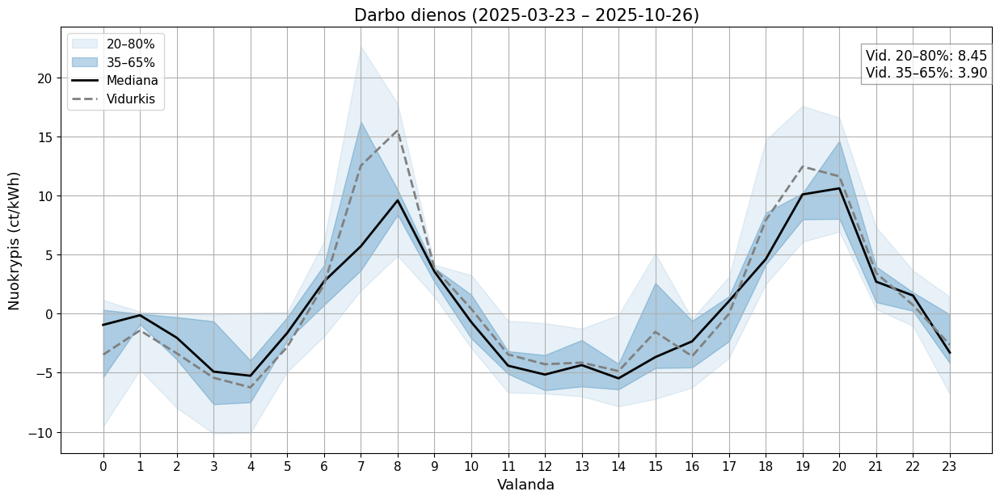

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


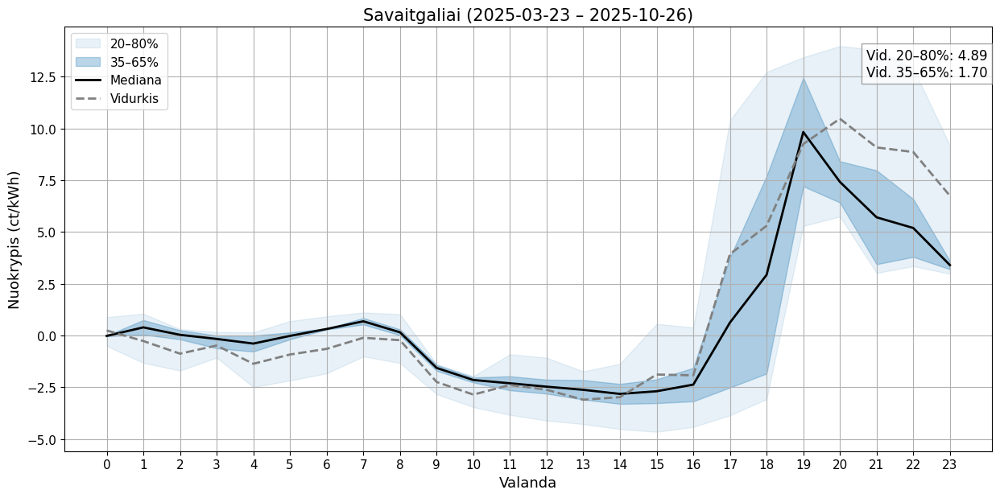

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


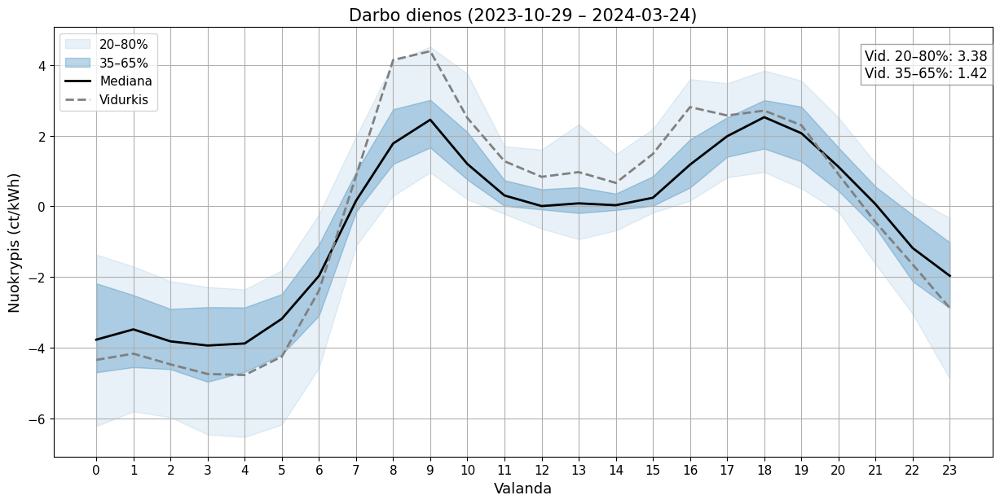

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


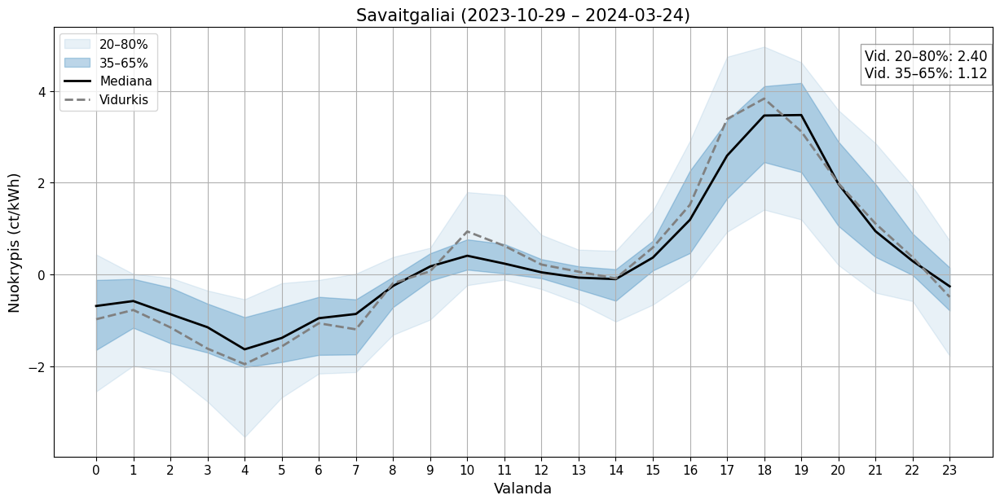

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


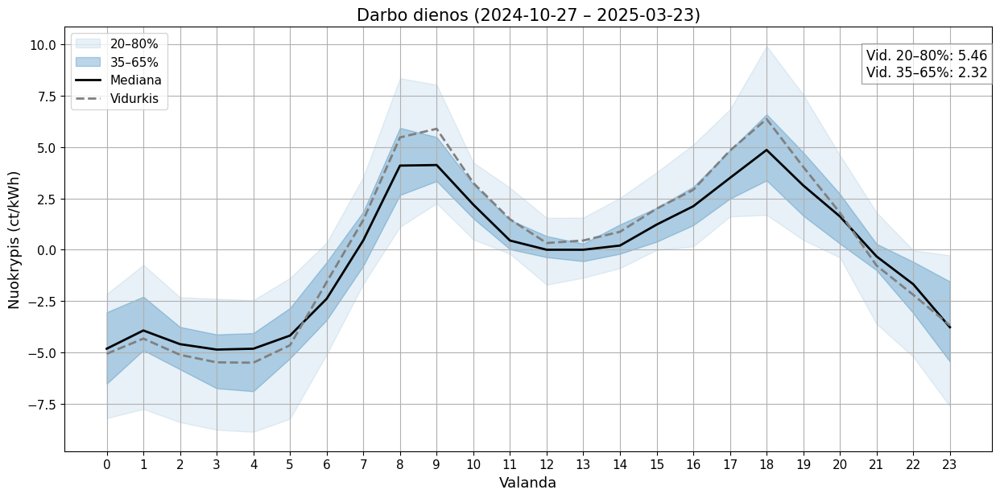

C:\Users\Eridas\AppData\Local\Temp\ipykernel_3184\4177674620.py:22: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['hour'] = df.index.hour


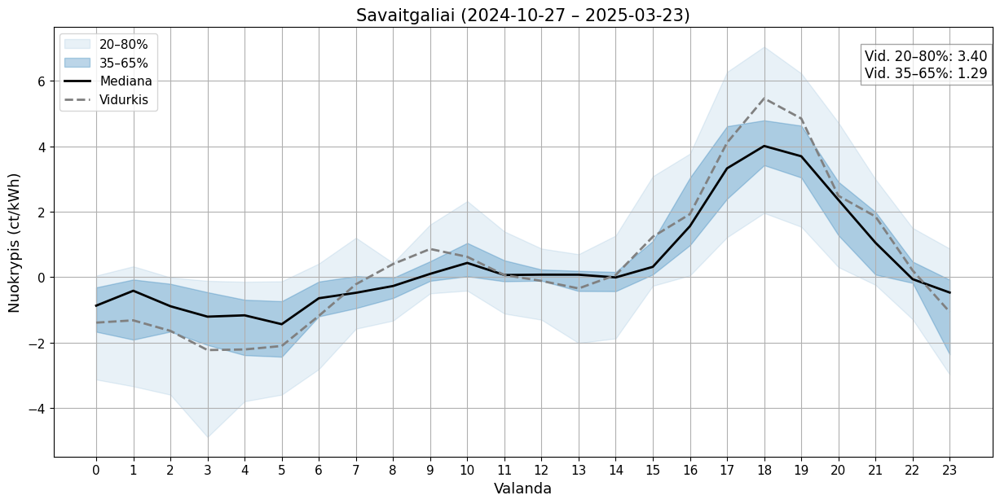

In [20]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_day_profile(df: pd.DataFrame, column: str, title: str, ylabel: str):
    df['hour'] = df.index.hour
    stats = df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(12, 6))
    plt.fill_between(stats.index, stats['20%'], stats['80%'], color='C0', alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color='C0', alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color='black')
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color='gray')

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=12,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title, fontsize=15)
    plt.xlabel("Valanda", fontsize=13)
    plt.ylabel(ylabel, fontsize=13)
    plt.xticks(range(24), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.02, right=0.98)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def plot_by_dst_intervals(df: pd.DataFrame, column: str):
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date

    transitions = get_dst_transitions(df)

    for start_date, end_date in transitions:
        summer_df = df[(df.index.date >= start_date) & (df.index.date < end_date)]
        for is_weekend, name in [(False, 'Darbo dienos'), (True, 'Savaitgaliai')]:
            subset = summer_df[summer_df['weekday'] >= 5] if is_weekend else summer_df[summer_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"{name} ({start_date.isoformat()} – {end_date.isoformat()})",
                    "Nuokrypis (ct/kWh)"
                )
        # Winter periods (from end of DST to next start)
    for i in range(len(transitions) - 1):
        end_date = transitions[i][1]
        next_start = transitions[i + 1][0]
        winter_df = df[(df.index.date >= end_date) & (df.index.date < next_start)]
        for is_weekend, name in [(False, 'Darbo dienos'), (True, 'Savaitgaliai')]:
            subset = winter_df[winter_df['weekday'] >= 5] if is_weekend else winter_df[winter_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"{name} ({end_date.isoformat()} – {next_start.isoformat()})",
                    "Nuokrypis (ct/kWh)"
                )


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_by_dst_intervals(df, 'deviation')


if __name__ == "__main__":
    main()

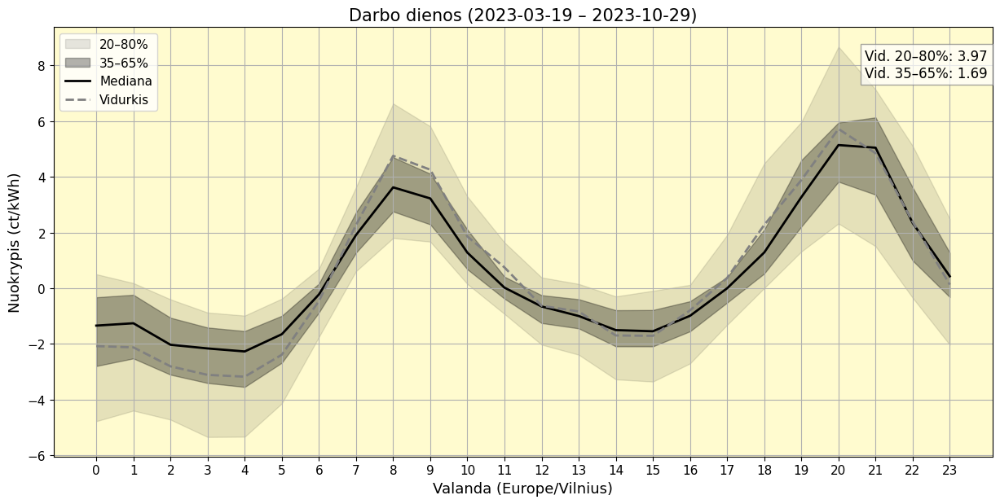

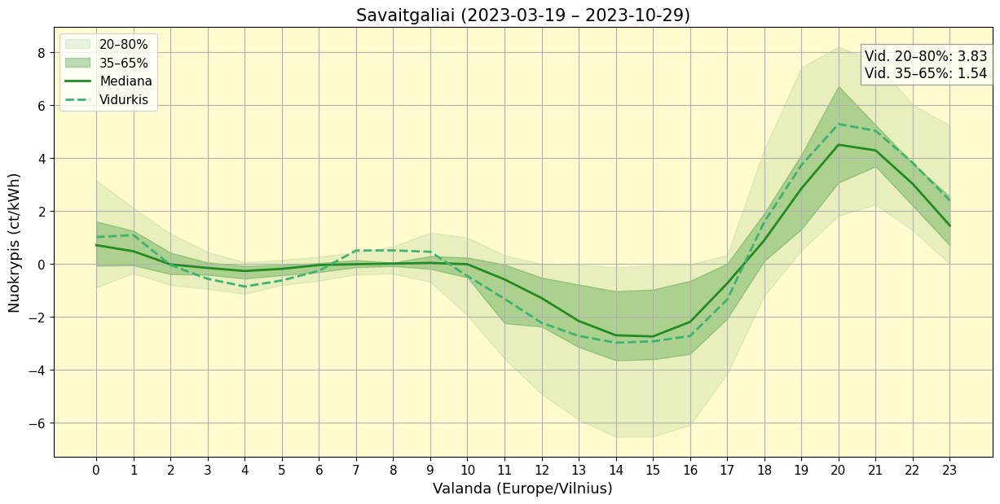

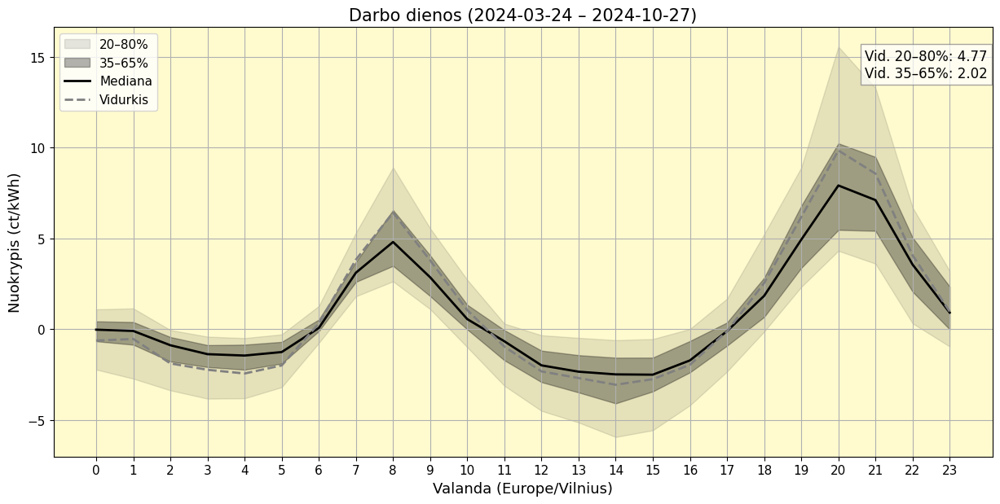

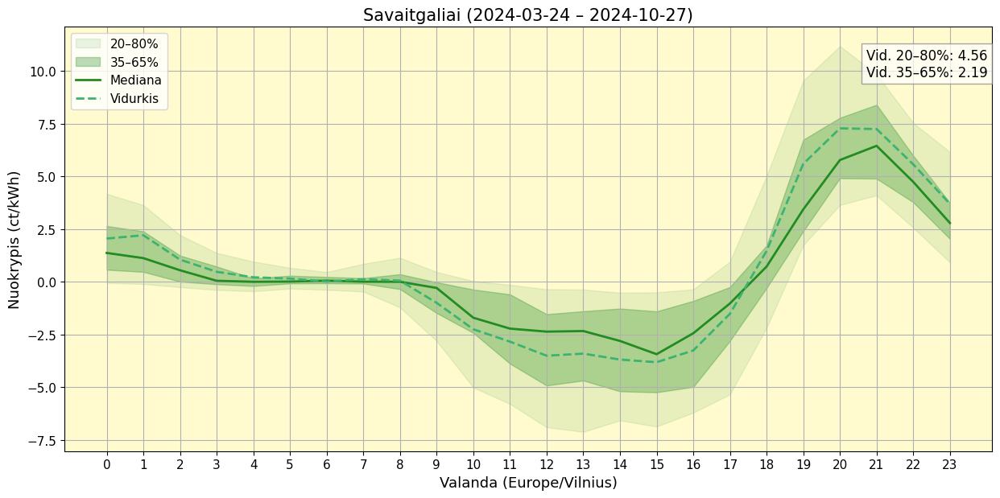

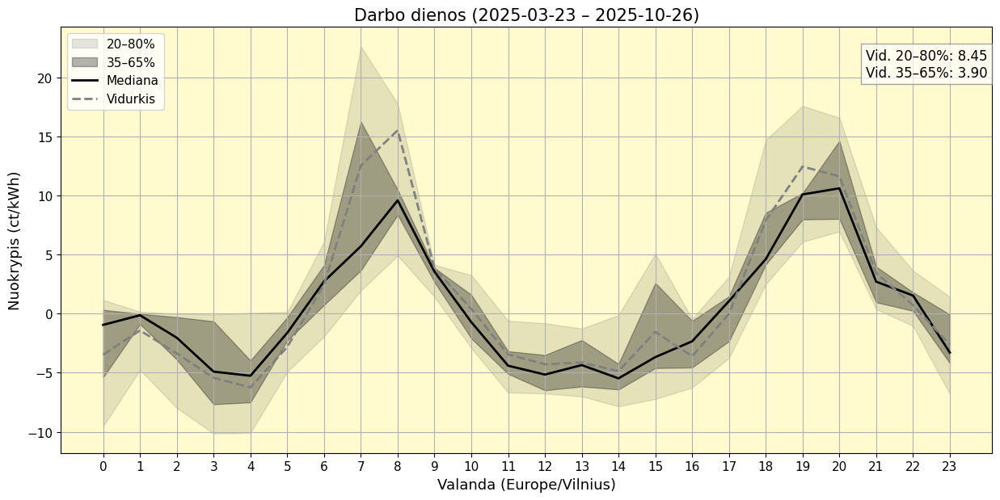

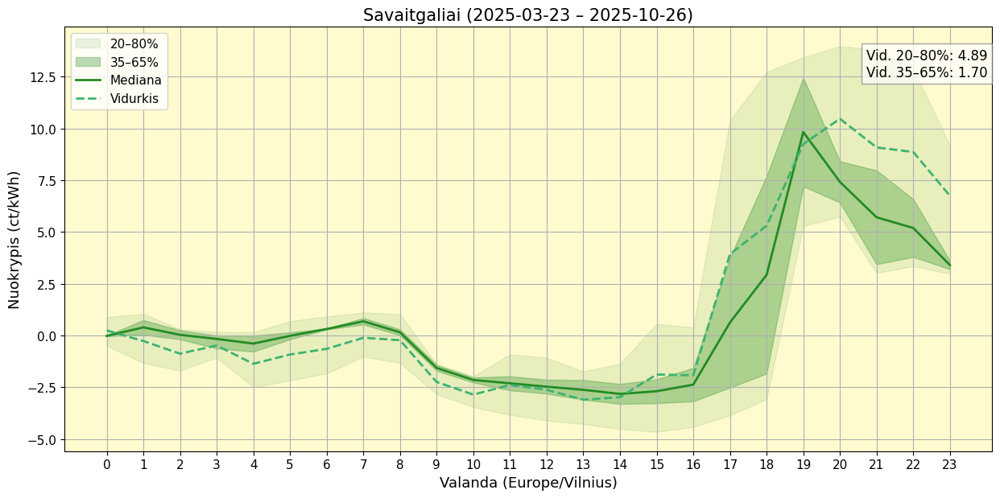

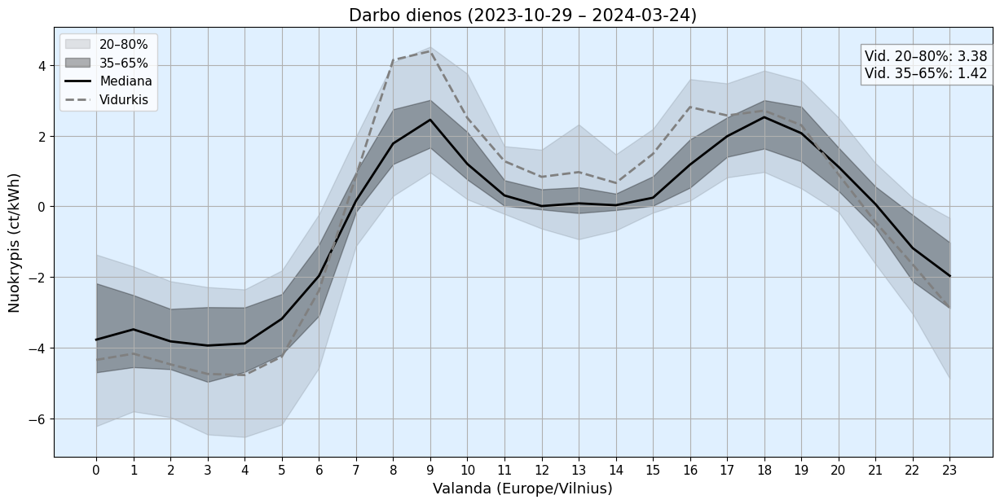

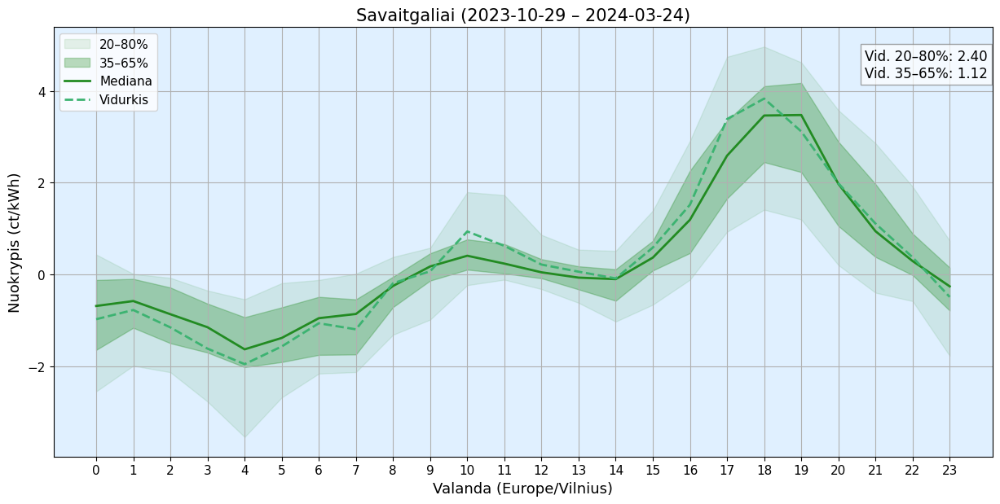

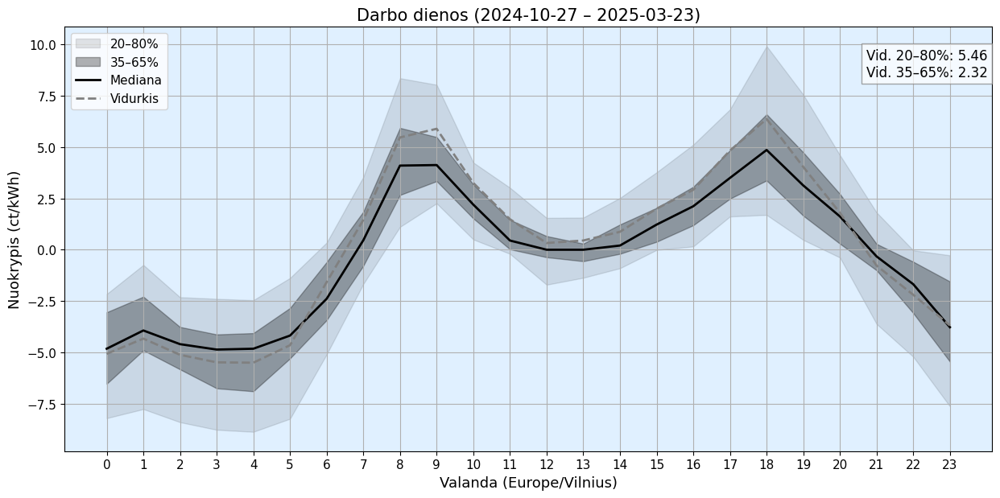

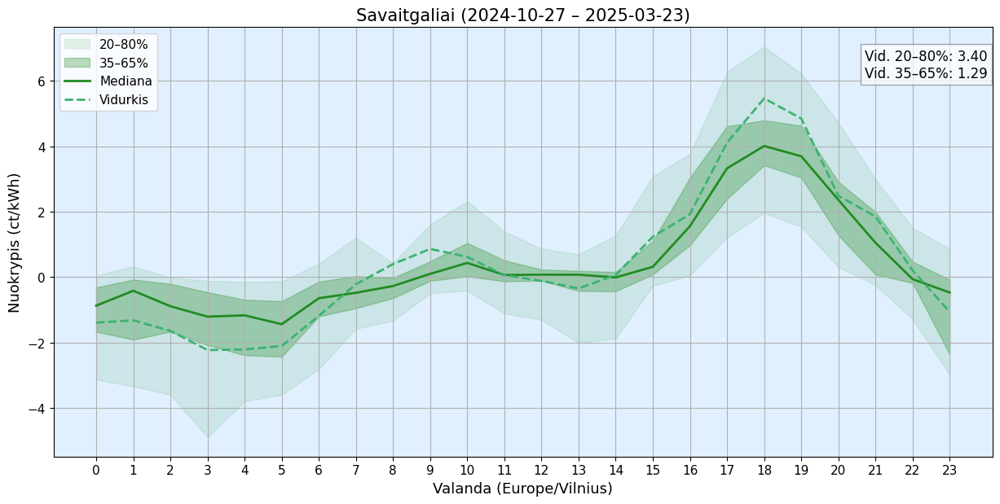

In [21]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_day_profile(df: pd.DataFrame, column: str, title: str, ylabel: str, is_weekend: bool, is_summer: bool):
    df = df.copy()
    df['hour'] = df.index.hour
    stats = df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(12, 6))

    # Foninė spalva
    bg_color = '#fffbcf' if is_summer else '#e0f0ff'
    plt.gca().set_facecolor(bg_color)

    # Linijų spalvos
    main_color = 'forestgreen' if is_weekend else 'black'
    alt_color = 'mediumseagreen' if is_weekend else 'gray'

    plt.fill_between(stats.index, stats['20%'], stats['80%'], color=main_color, alpha=0.1, label='20–80%')
    plt.fill_between(stats.index, stats['35%'], stats['65%'], color=main_color, alpha=0.3, label='35–65%')
    plt.plot(stats.index, stats['Median'], label='Mediana', linewidth=2, color=main_color)
    plt.plot(stats.index, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color=alt_color)

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=12,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    plt.title(title, fontsize=15)
    plt.xlabel("Valanda (Europe/Vilnius)", fontsize=13)
    plt.ylabel(ylabel, fontsize=13)
    plt.xticks(range(24), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.02, right=0.98)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def plot_by_dst_intervals(df: pd.DataFrame, column: str):
    df = df.copy()
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date

    transitions = get_dst_transitions(df)

    for start_date, end_date in transitions:
        summer_df = df[(df.index.date >= start_date) & (df.index.date < end_date)]
        for is_weekend, name in [(False, 'Darbo dienos'), (True, 'Savaitgaliai')]:
            subset = summer_df[summer_df['weekday'] >= 5] if is_weekend else summer_df[summer_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"{name} ({start_date.isoformat()} – {end_date.isoformat()})",
                    "Nuokrypis (ct/kWh)",
                    is_weekend=is_weekend,
                    is_summer=True
                )

    for i in range(len(transitions) - 1):
        end_date = transitions[i][1]
        next_start = transitions[i + 1][0]
        winter_df = df[(df.index.date >= end_date) & (df.index.date < next_start)]
        for is_weekend, name in [(False, 'Darbo dienos'), (True, 'Savaitgaliai')]:
            subset = winter_df[winter_df['weekday'] >= 5] if is_weekend else winter_df[winter_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"{name} ({end_date.isoformat()} – {next_start.isoformat()})",
                    "Nuokrypis (ct/kWh)",
                    is_weekend=is_weekend,
                    is_summer=False
                )


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df = df.copy()
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_by_dst_intervals(df, 'deviation')


if __name__ == "__main__":
    main()

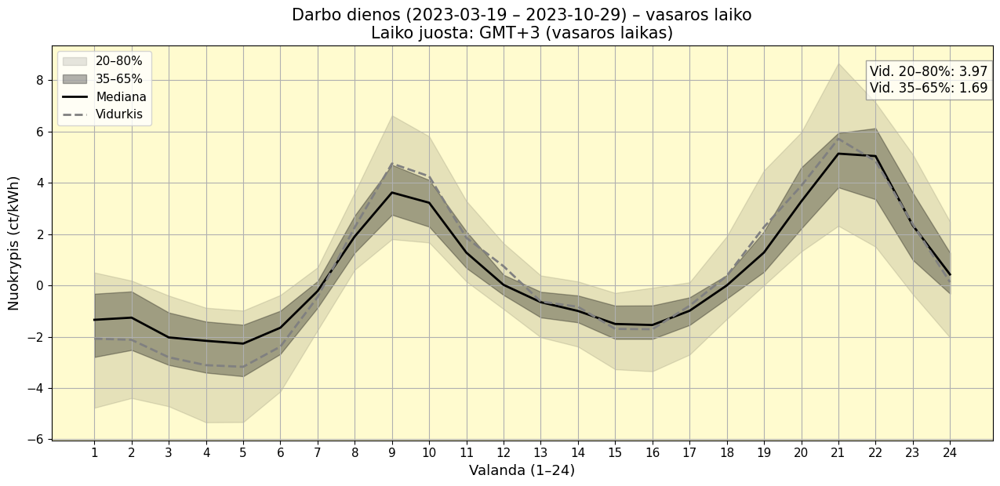

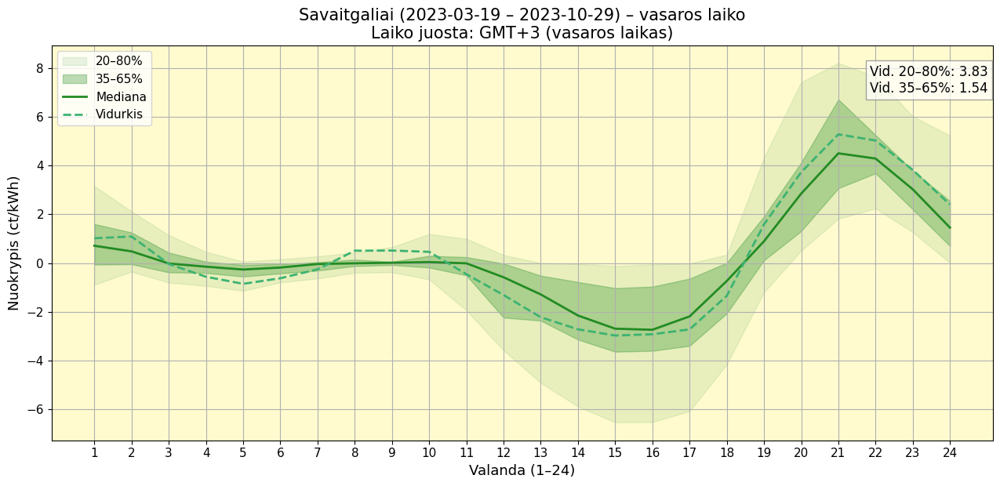

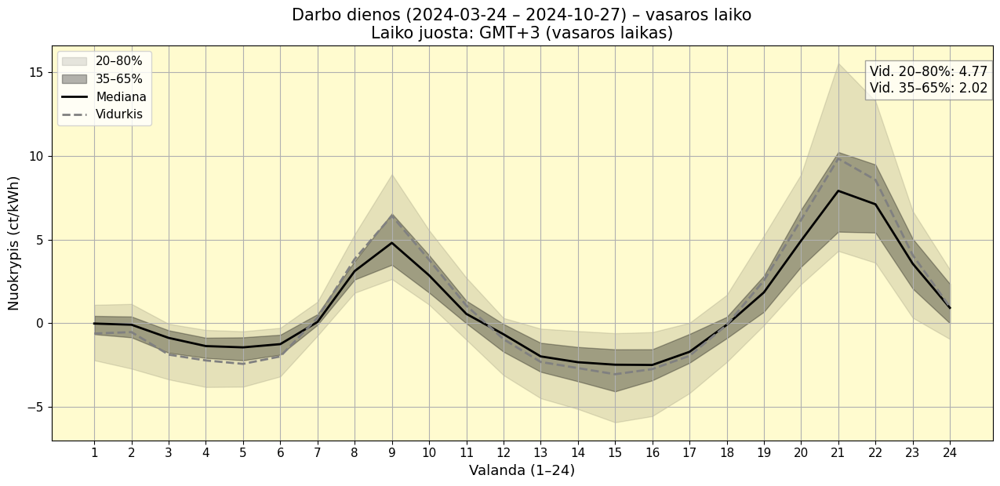

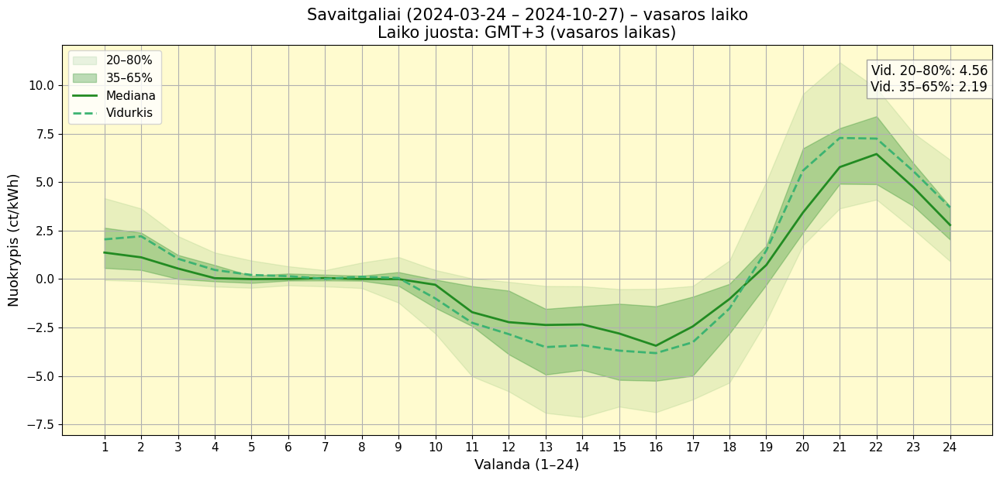

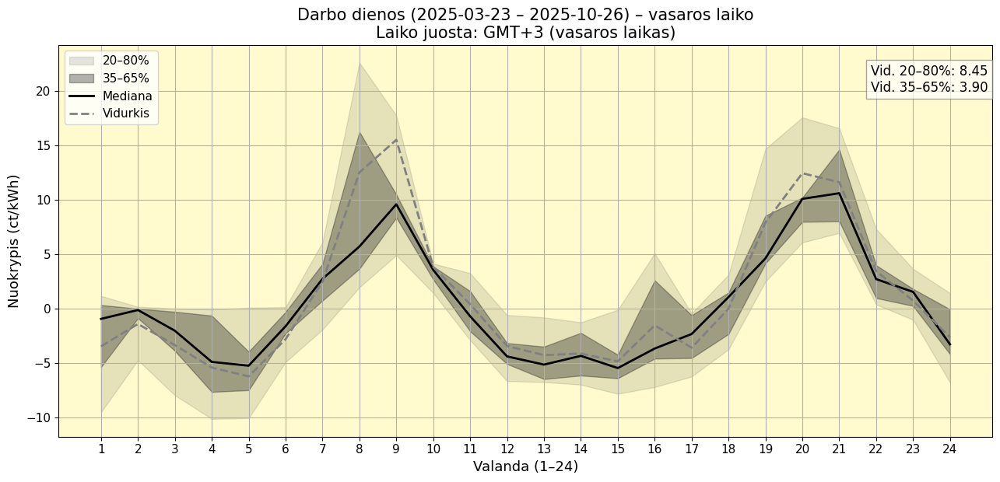

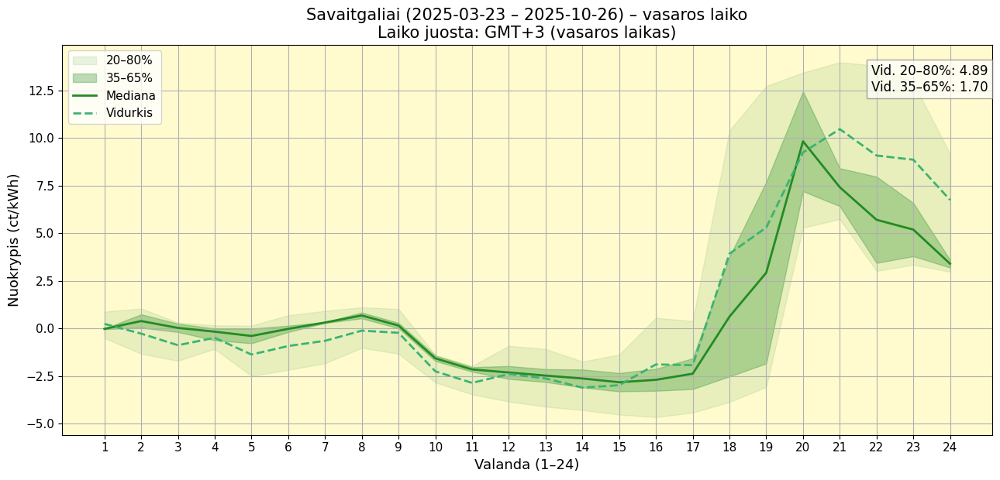

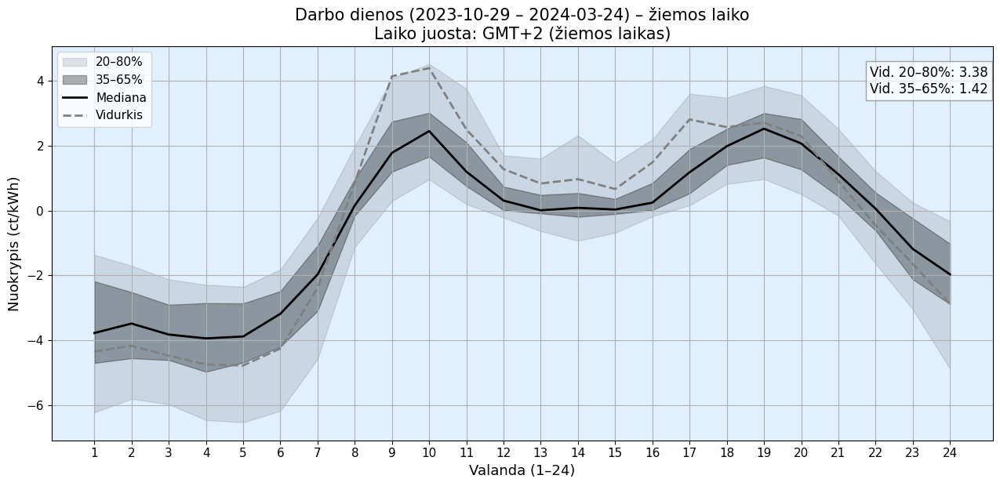

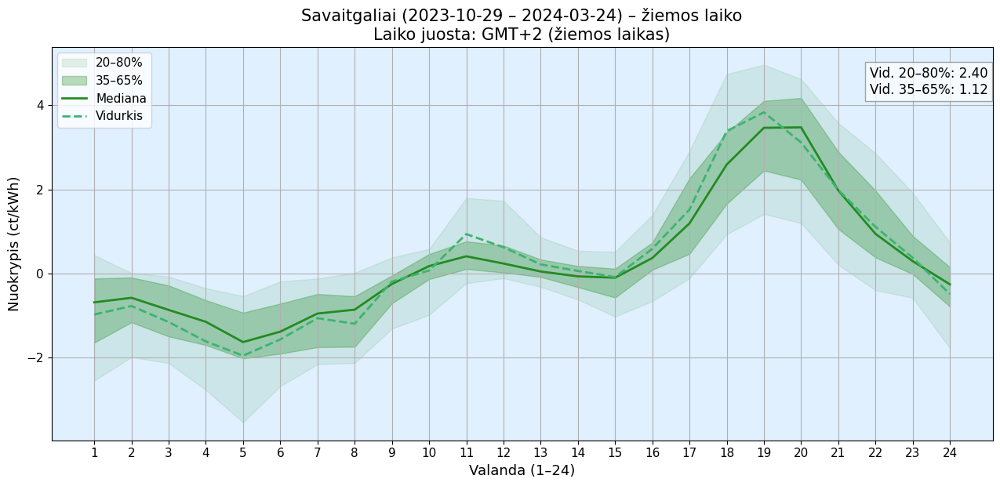

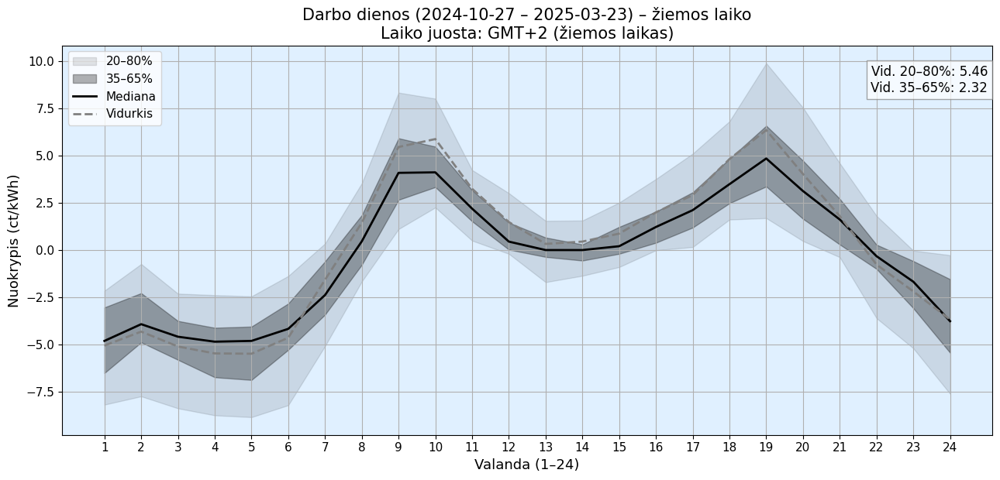

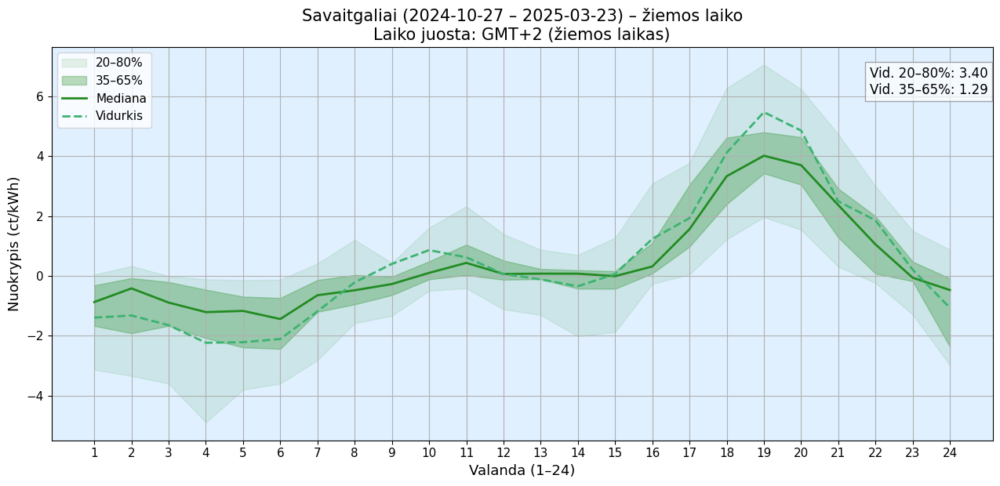

In [22]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_day_profile(df: pd.DataFrame, column: str, title: str, ylabel: str, is_weekend: bool, is_summer: bool):
    df = df.copy()
    df['hour'] = df.index.hour
    stats = df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(12, 6))

    # Foninė spalva
    bg_color = '#fffbcf' if is_summer else '#e0f0ff'
    plt.gca().set_facecolor(bg_color)

    # Linijų spalvos
    main_color = 'forestgreen' if is_weekend else 'black'
    alt_color = 'mediumseagreen' if is_weekend else 'gray'

    plt.fill_between(stats.index + 1, stats['20%'], stats['80%'], color=main_color, alpha=0.1, label='20–80%')
    plt.fill_between(stats.index + 1, stats['35%'], stats['65%'], color=main_color, alpha=0.3, label='35–65%')
    plt.plot(stats.index + 1, stats['Median'], label='Mediana', linewidth=2, color=main_color)
    plt.plot(stats.index + 1, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color=alt_color)

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(0.995, 0.95, label, transform=plt.gca().transAxes,
             ha='right', va='top', fontsize=12,
             bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7))

    tz_label = 'GMT+3 (vasaros laikas)' if is_summer else 'GMT+2 (žiemos laikas)'
    plt.title(f"{title}\nLaiko juosta: {tz_label}", fontsize=15)
    plt.xlabel("Valanda (1–24)", fontsize=13)
    plt.ylabel(ylabel, fontsize=13)
    plt.xticks(range(1, 25), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.0, right=1.0)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def plot_by_dst_intervals(df: pd.DataFrame, column: str):
    df = df.copy()
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date

    transitions = get_dst_transitions(df)

    for start_date, end_date in transitions:
        summer_df = df[(df.index.date >= start_date) & (df.index.date < end_date)]
        for is_weekend, name in [(False, 'darbo dienos'), (True, 'savaitgaliai')]:
            subset = summer_df[summer_df['weekday'] >= 5] if is_weekend else summer_df[summer_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"{name.capitalize()} ({start_date.isoformat()} – {end_date.isoformat()}) – vasaros laiko",
                    "Nuokrypis (ct/kWh)",
                    is_weekend=is_weekend,
                    is_summer=True
                )

    for i in range(len(transitions) - 1):
        end_date = transitions[i][1]
        next_start = transitions[i + 1][0]
        winter_df = df[(df.index.date >= end_date) & (df.index.date < next_start)]
        for is_weekend, name in [(False, 'darbo dienos'), (True, 'savaitgaliai')]:
            subset = winter_df[winter_df['weekday'] >= 5] if is_weekend else winter_df[winter_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"{name.capitalize()} ({end_date.isoformat()} – {next_start.isoformat()}) – žiemos laiko",
                    "Nuokrypis (ct/kWh)",
                    is_weekend=is_weekend,
                    is_summer=False
                )


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df = df.copy()
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_by_dst_intervals(df, 'deviation')


if __name__ == "__main__":
    main()


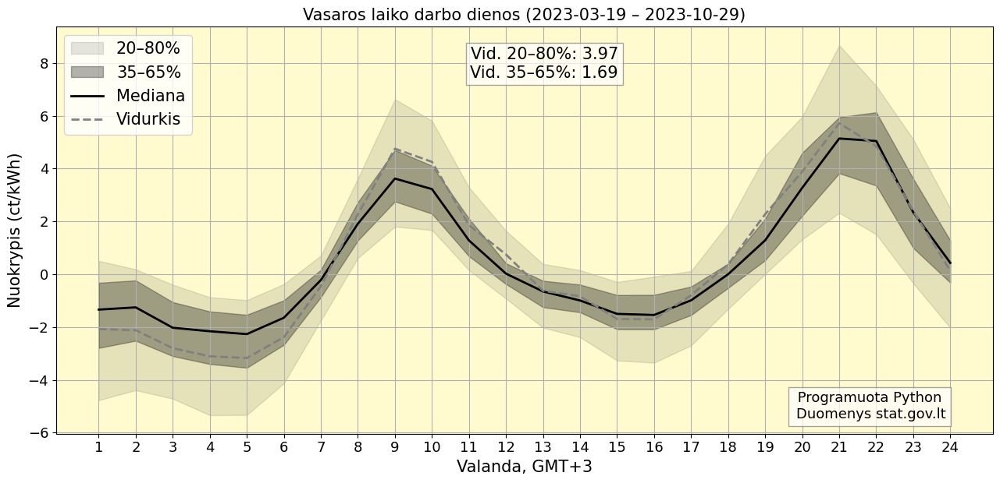

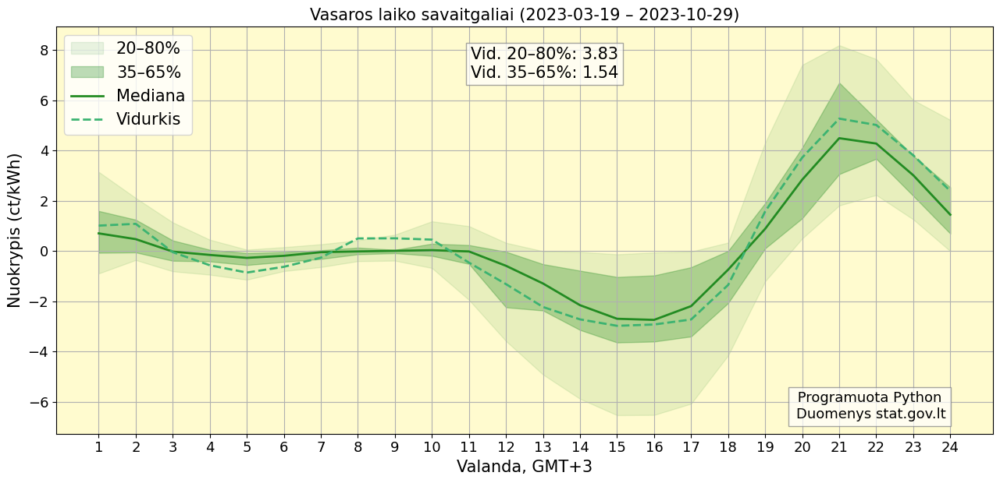

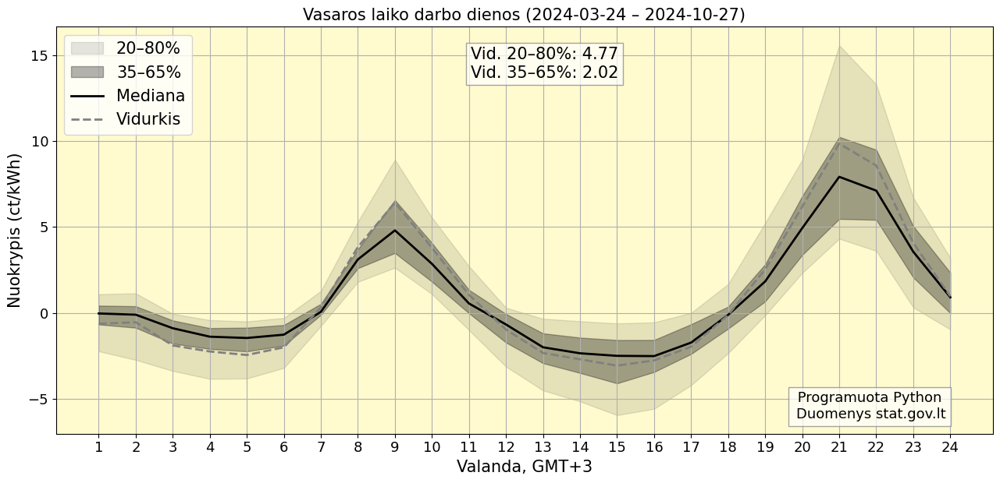

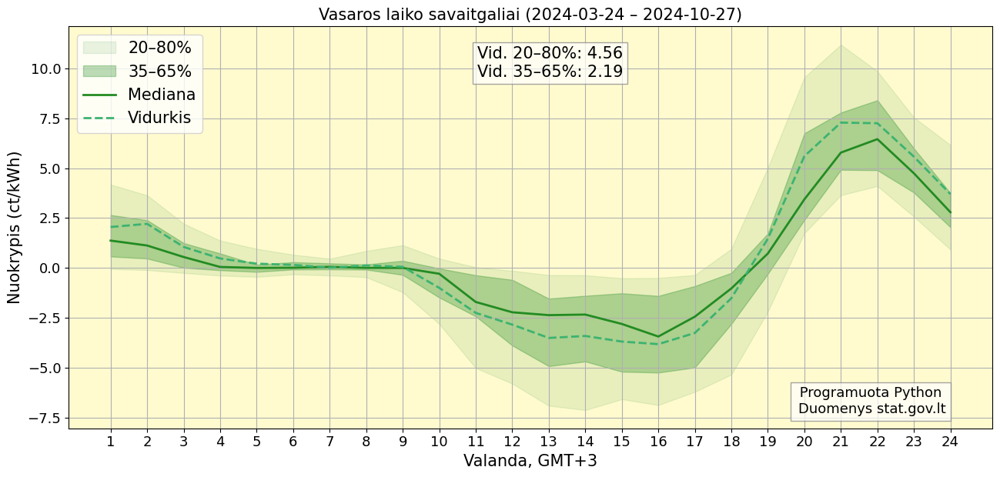

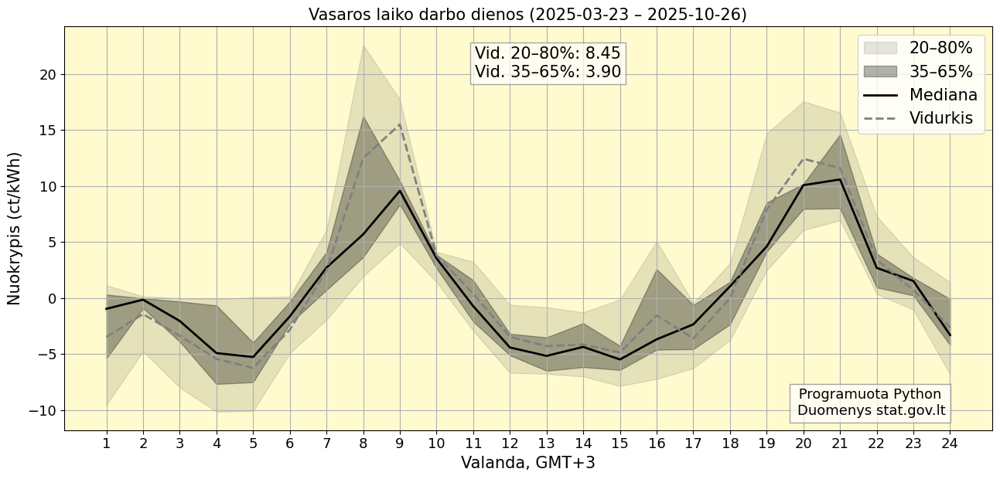

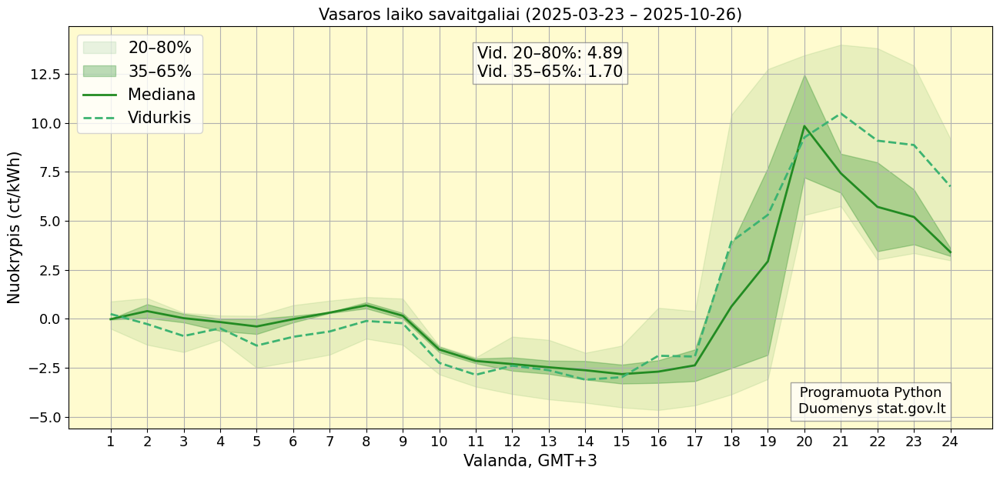

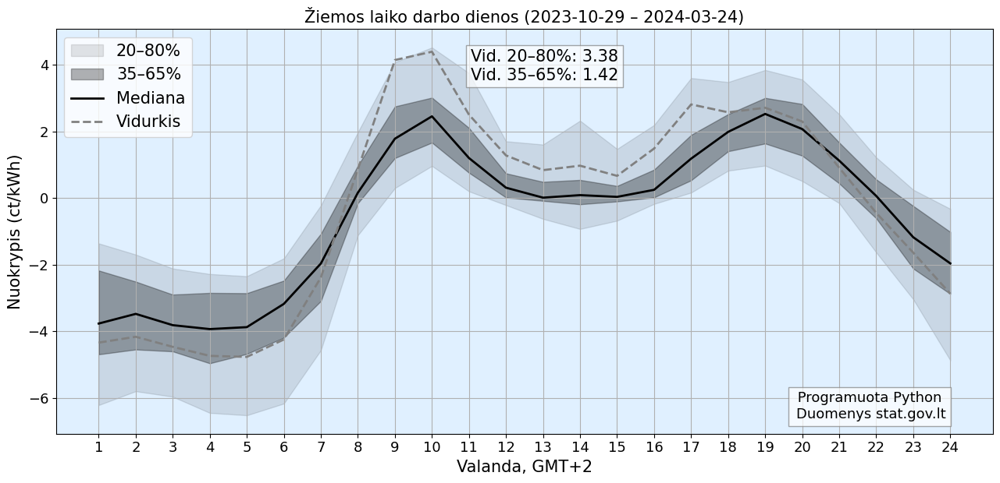

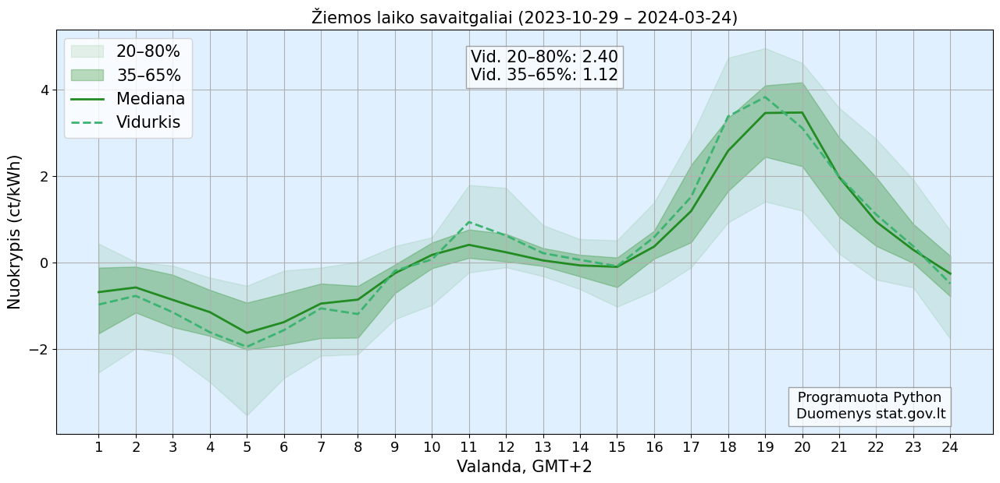

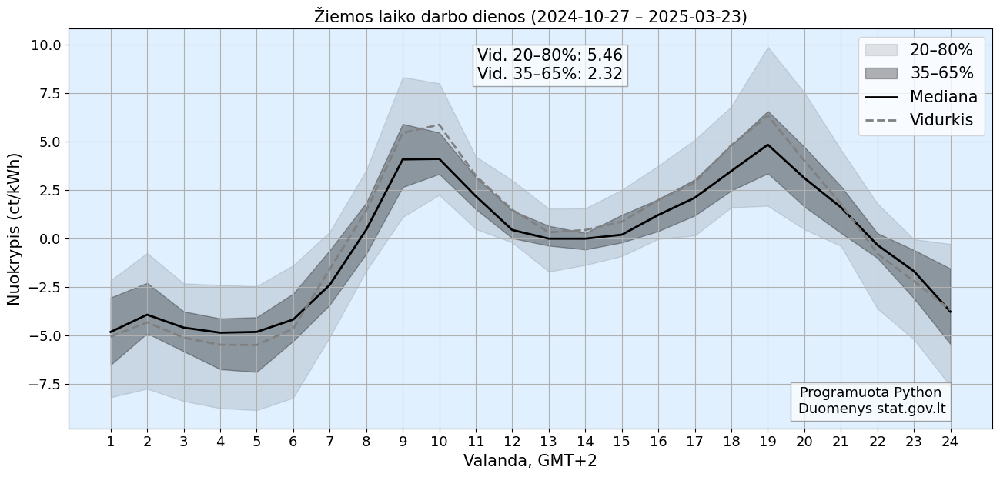

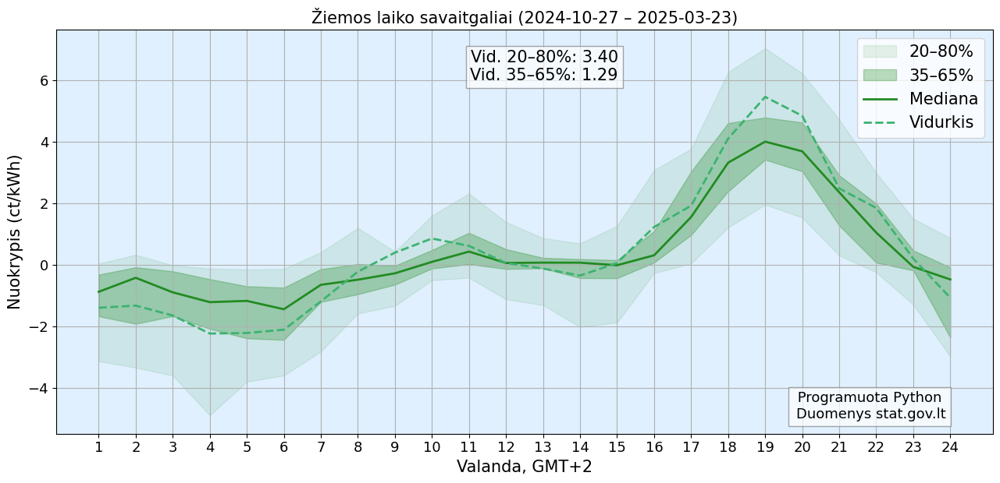

In [23]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_day_profile(df: pd.DataFrame, column: str, title: str, ylabel: str, is_weekend: bool, is_summer: bool):
    df = df.copy()
    df['hour'] = df.index.hour
    stats = df.groupby('hour')[column].agg([
        ('Mean', 'mean'),
        ('20%', lambda x: x.quantile(0.2)),
        ('35%', lambda x: x.quantile(0.35)),
        ('Median', 'median'),
        ('65%', lambda x: x.quantile(0.65)),
        ('80%', lambda x: x.quantile(0.8))
    ])

    mean_20_80 = (stats['80%'] - stats['20%']).mean()
    mean_35_65 = (stats['65%'] - stats['35%']).mean()

    plt.figure(figsize=(12, 6))

    # Foninė spalva
    bg_color = '#fffbcf' if is_summer else '#e0f0ff'
    plt.gca().set_facecolor(bg_color)

    # Linijų spalvos
    main_color = 'forestgreen' if is_weekend else 'black'
    alt_color = 'mediumseagreen' if is_weekend else 'gray'

    plt.fill_between(stats.index + 1, stats['20%'], stats['80%'], color=main_color, alpha=0.1, label='20–80%')
    plt.fill_between(stats.index + 1, stats['35%'], stats['65%'], color=main_color, alpha=0.3, label='35–65%')
    plt.plot(stats.index + 1, stats['Median'], label='Mediana', linewidth=2, color=main_color)
    plt.plot(stats.index + 1, stats['Mean'], label='Vidurkis', linewidth=2, linestyle='--', color=alt_color)

    label = f"Vid. 20–80%: {mean_20_80:.2f}\nVid. 35–65%: {mean_35_65:.2f}"
    plt.text(
        0.6, 0.95, label, transform=plt.gca().transAxes,
        ha='right', va='top', fontsize=15,
        bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7)
    )

    plt.text(
        0.95, 0.03, ' Programuota Python \nDuomenys stat.gov.lt',
        fontsize=13,
        ha='right',  # horizontal alignment
        va='bottom',  # vertical alignment
        transform=plt.gca().transAxes,
        color='black',
        bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7)
    )

    tz_label = 'GMT+3' if is_summer else 'GMT+2'
    plt.title(f"{title}", fontsize=15)
    plt.xlabel(f"Valanda, {tz_label}", fontsize=15)
    plt.ylabel(ylabel, fontsize=15)
    plt.xticks(range(1, 25), fontsize=13)
    plt.yticks(fontsize=13)
    plt.grid(True)
    plt.legend(fontsize=15)
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.0, right=1.0)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def plot_by_dst_intervals(df: pd.DataFrame, column: str):
    df = df.copy()
    df['weekday'] = df.index.weekday
    df['hour'] = df.index.hour
    df['date'] = df.index.date

    transitions = get_dst_transitions(df)

    for start_date, end_date in transitions:
        summer_df = df[(df.index.date >= start_date) & (df.index.date < end_date)]
        for is_weekend, name in [(False, 'darbo dienos'), (True, 'savaitgaliai')]:
            subset = summer_df[summer_df['weekday'] >= 5] if is_weekend else summer_df[summer_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"Vasaros laiko {name} ({start_date.isoformat()} – {end_date.isoformat()})",
                    "Nuokrypis (ct/kWh)",
                    is_weekend=is_weekend,
                    is_summer=True
                )

    for i in range(len(transitions) - 1):
        end_date = transitions[i][1]
        next_start = transitions[i + 1][0]
        winter_df = df[(df.index.date >= end_date) & (df.index.date < next_start)]
        for is_weekend, name in [(False, 'darbo dienos'), (True, 'savaitgaliai')]:
            subset = winter_df[winter_df['weekday'] >= 5] if is_weekend else winter_df[winter_df['weekday'] < 5]
            if not subset.empty:
                plot_day_profile(
                    subset,
                    column,
                    f"Žiemos laiko {name} ({end_date.isoformat()} – {next_start.isoformat()})",
                    "Nuokrypis (ct/kWh)",
                    is_weekend=is_weekend,
                    is_summer=False
                )


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df = df.copy()
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_by_dst_intervals(df, 'deviation')


if __name__ == "__main__":
    main()


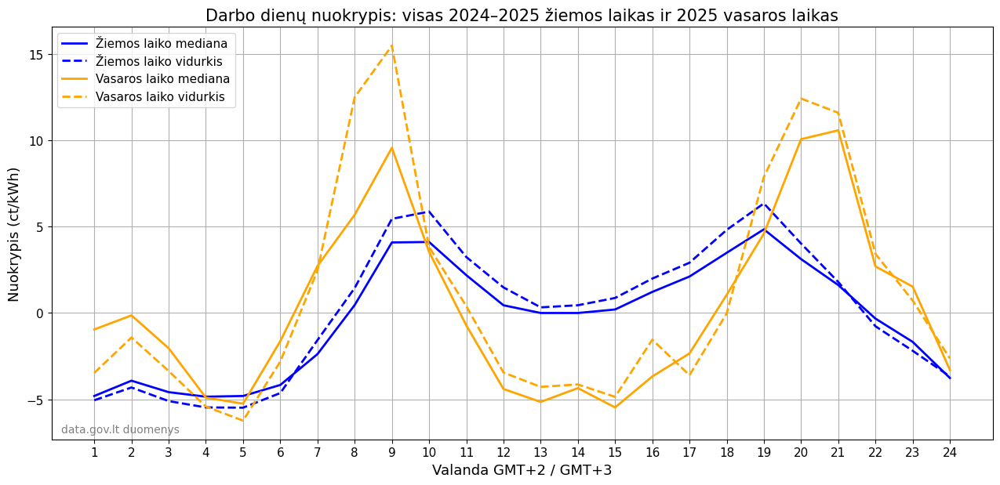

In [24]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_transition_pair(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    tz = pytz.timezone("Europe/Vilnius")
    transitions = get_dst_transitions(df)
    if not transitions:
        return

    # Visas paskutinis žiemos laikotarpis
    last_winter_start = transitions[-2][1]
    last_winter_end = transitions[-1][0]
    winter_df = df[(df.index.date >= last_winter_start) & (df.index.date < last_winter_end) & (df['weekday'] < 5)]

    # Visa turima vasaros laikotarpio dalis po paskutinio perėjimo
    summer_df = df[(df.index.date >= last_winter_end) & (df['weekday'] < 5)]

    winter_stats = winter_df.groupby('hour')['deviation'].agg(['mean', 'median'])
    summer_stats = summer_df.groupby('hour')['deviation'].agg(['mean', 'median'])

    plt.figure(figsize=(12, 6))
    plt.plot(winter_stats.index + 1, winter_stats['median'], label='Žiemos laiko mediana', color='blue', linewidth=2)
    plt.plot(winter_stats.index + 1, winter_stats['mean'], label='Žiemos laiko vidurkis', color='blue', linestyle='--', linewidth=2)

    plt.plot(summer_stats.index + 1, summer_stats['median'], label='Vasaros laiko mediana', color='orange', linewidth=2)
    plt.plot(summer_stats.index + 1, summer_stats['mean'], label='Vasaros laiko vidurkis', color='orange', linestyle='--', linewidth=2)

    plt.title("Darbo dienų nuokrypis: visas 2024–2025 žiemos laikas ir 2025 vasaros laikas", fontsize=15)
    plt.xlabel("Valanda GMT+2 / GMT+3", fontsize=13)
    plt.ylabel("Nuokrypis (ct/kWh)", fontsize=13)
    plt.xticks(range(1, 25), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=11)
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=10, color='gray')
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.0, right=1.0)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df = df.copy()
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_transition_pair(df)


if __name__ == "__main__":
    main()

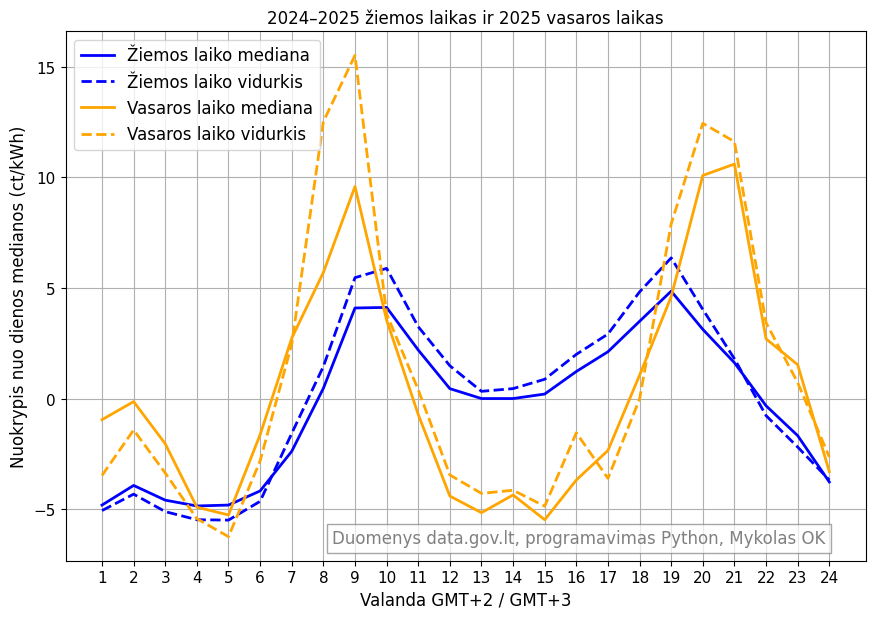

In [25]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_transition_pair(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    tz = pytz.timezone("Europe/Vilnius")
    transitions = get_dst_transitions(df)
    if not transitions:
        return

    # Visas paskutinis žiemos laikotarpis
    last_winter_start = transitions[-2][1]
    last_winter_end = transitions[-1][0]
    winter_df = df[(df.index.date >= last_winter_start) & (df.index.date < last_winter_end) & (df['weekday'] < 5)]

    # Visa turima vasaros laikotarpio dalis po paskutinio perėjimo
    summer_df = df[(df.index.date >= last_winter_end) & (df['weekday'] < 5)]

    winter_stats = winter_df.groupby('hour')['deviation'].agg(['mean', 'median'])
    summer_stats = summer_df.groupby('hour')['deviation'].agg(['mean', 'median'])

    plt.figure(figsize=(8,6))
    plt.plot(winter_stats.index + 1, winter_stats['median'], label='Žiemos laiko mediana', color='blue', linewidth=2)
    plt.plot(winter_stats.index + 1, winter_stats['mean'], label='Žiemos laiko vidurkis', color='blue', linestyle='--', linewidth=2)

    plt.plot(summer_stats.index + 1, summer_stats['median'], label='Vasaros laiko mediana', color='orange', linewidth=2)
    plt.plot(summer_stats.index + 1, summer_stats['mean'], label='Vasaros laiko vidurkis', color='orange', linestyle='--', linewidth=2)

    plt.title("2024–2025 žiemos laikas ir 2025 vasaros laikas", fontsize=12)
    plt.xlabel("Valanda GMT+2 / GMT+3", fontsize=12)
    plt.ylabel("Nuokrypis nuo dienos medianos (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=12)
    plt.text(0.95, 0.025, 'Duomenys data.gov.lt, programavimas Python, Mykolas OK', 
            transform=plt.gca().transAxes,
            ha='right',  # horizontal alignment
            va='bottom',  # vertical alignment
            fontsize=12, color='gray',
            bbox=dict(facecolor='white', edgecolor='gray', alpha=0.7)
    )
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.0, right=1.0)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df = df.copy()
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_transition_pair(df)


if __name__ == "__main__":
    main()

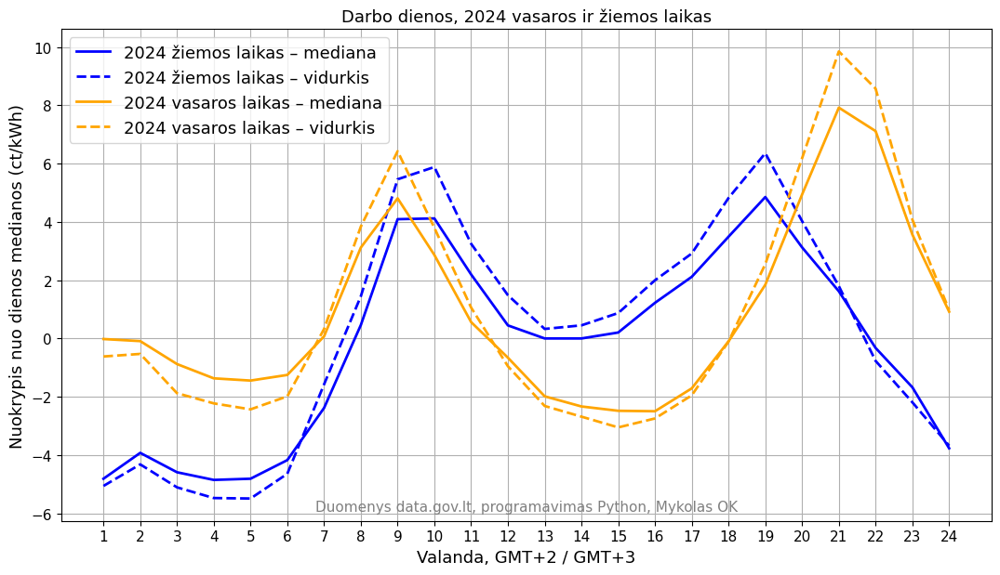

In [26]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def plot_2024_seasonal_pair(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    tz = pytz.timezone("Europe/Vilnius")
    transitions = get_dst_transitions(df)
    if not transitions:
        return

    # Surandame 2024 metų perėjimo datas
    for i in range(len(transitions)):
        start_date, end_date = transitions[i]
        if start_date.year == 2024:
            summer_start = start_date
            winter_start = end_date
            break
    else:
        return

    # 2024 vasaros laikas: nuo summer_start iki winter_start
    summer_df = df[(df.index.date >= summer_start) & (df.index.date < winter_start) & (df['weekday'] < 5)]

    # 2024 žiemos laikas: nuo winter_start iki 2025-03-31 perėjimo (jei yra)
    next_summer_start = None
    for j in range(i + 1, len(transitions)):
        if transitions[j][0].year == 2025:
            next_summer_start = transitions[j][0]
            break
    if next_summer_start:
        winter_df = df[(df.index.date >= winter_start) & (df.index.date < next_summer_start) & (df['weekday'] < 5)]
    else:
        winter_df = df[(df.index.date >= winter_start) & (df['weekday'] < 5)]

    winter_stats = winter_df.groupby('hour')['deviation'].agg(['mean', 'median'])
    summer_stats = summer_df.groupby('hour')['deviation'].agg(['mean', 'median'])

    plt.figure(figsize=(10, 6))
    plt.plot(winter_stats.index + 1, winter_stats['median'], label='2024 žiemos laikas – mediana', color='blue', linewidth=2)
    plt.plot(winter_stats.index + 1, winter_stats['mean'], label='2024 žiemos laikas – vidurkis', color='blue', linestyle='--', linewidth=2)

    plt.plot(summer_stats.index + 1, summer_stats['median'], label='2024 vasaros laikas – mediana', color='orange', linewidth=2)
    plt.plot(summer_stats.index + 1, summer_stats['mean'], label='2024 vasaros laikas – vidurkis', color='orange', linestyle='--', linewidth=2)

    plt.title("Darbo dienos, 2024 vasaros ir žiemos laikas", fontsize=13)
    plt.xlabel("Valanda, GMT+2 / GMT+3", fontsize=13)
    plt.ylabel("Nuokrypis nuo dienos medianos (ct/kWh)", fontsize=13)
    plt.xticks(range(1, 25), fontsize=11)
    plt.yticks(fontsize=11)
    plt.grid(True)
    plt.legend(fontsize=13)
    plt.text(0.5, 0.015, 'Duomenys data.gov.lt, programavimas Python, Mykolas OK', 
            transform=plt.gca().transAxes,
            ha='center', va='bottom', fontsize=11, color='gray')
    plt.tight_layout(pad=0)
    plt.subplots_adjust(left=0.0, right=1.0)
    plt.show()


def get_dst_transitions(df: pd.DataFrame) -> list:
    tz = pytz.timezone("Europe/Vilnius")
    years = df.index.year.unique()
    transitions = []
    for year in years:
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)

            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)

            transitions.append((start.astimezone(tz).date(), end.astimezone(tz).date()))
        except Exception:
            continue
    return transitions


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    df = df.copy()
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())
    plot_2024_seasonal_pair(df)


if __name__ == "__main__":
    main()


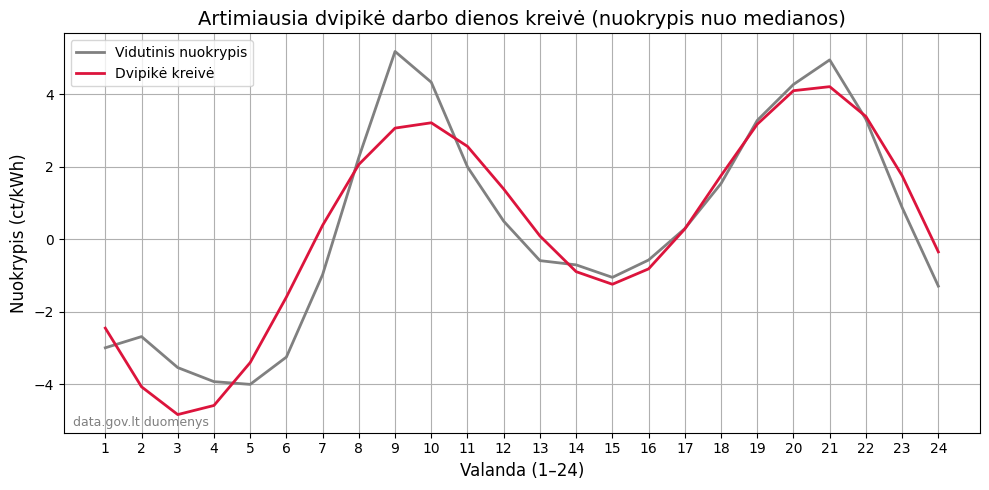

In [27]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    # Tik darbo dienos
    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['deviation'].mean()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinis nuokrypis', color='gray', linewidth=2)
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (nuokrypis nuo medianos)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Nuokrypis (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)


if __name__ == "__main__":
    main()


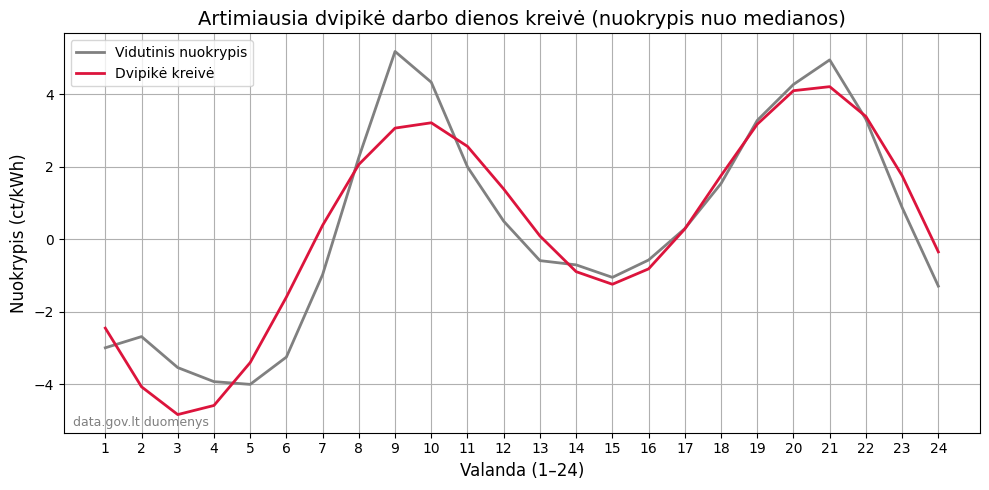

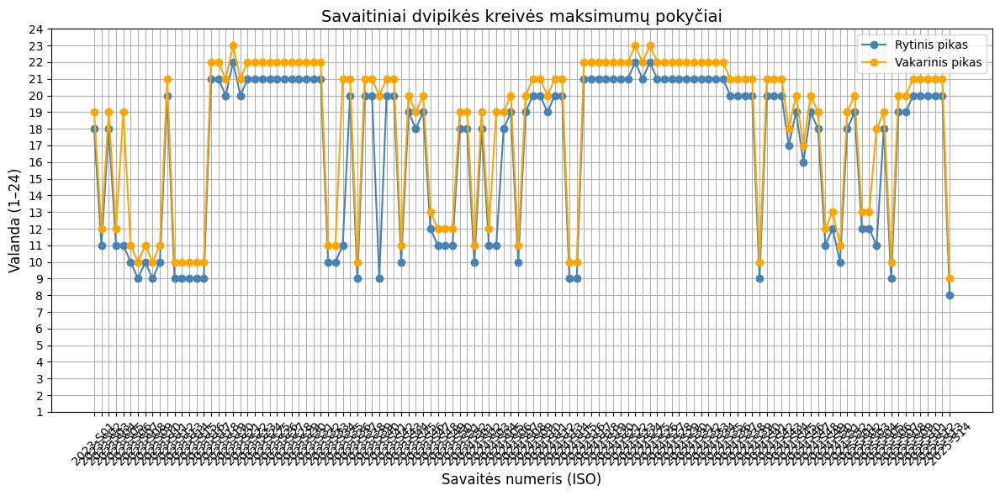

In [29]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['deviation'].mean()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinis nuokrypis', color='gray', linewidth=2)
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (nuokrypis nuo medianos)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Nuokrypis (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()


def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['deviation'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)
        sorted_peaks = hours[np.argsort(fitted_values)[-2:]] + 1  # valandos nuo 1
        sorted_peaks.sort()
        weekly_peaks.append((f"{year}-S{week:02d}", sorted_peaks[0], sorted_peaks[1]))

    result_df = pd.DataFrame(weekly_peaks, columns=['Week', 'MorningPeak', 'EveningPeak'])

    plt.figure(figsize=(12, 6))
    plt.plot(result_df['Week'], result_df['MorningPeak'], marker='o', linestyle='-', label='Rytinis pikas', color='steelblue')
    plt.plot(result_df['Week'], result_df['EveningPeak'], marker='o', linestyle='-', label='Vakarinis pikas', color='orange')
    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai", fontsize=14)
    plt.xlabel("Savaitės numeris (ISO)", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.xticks(rotation=45)
    plt.yticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)


if __name__ == "__main__":
    main()

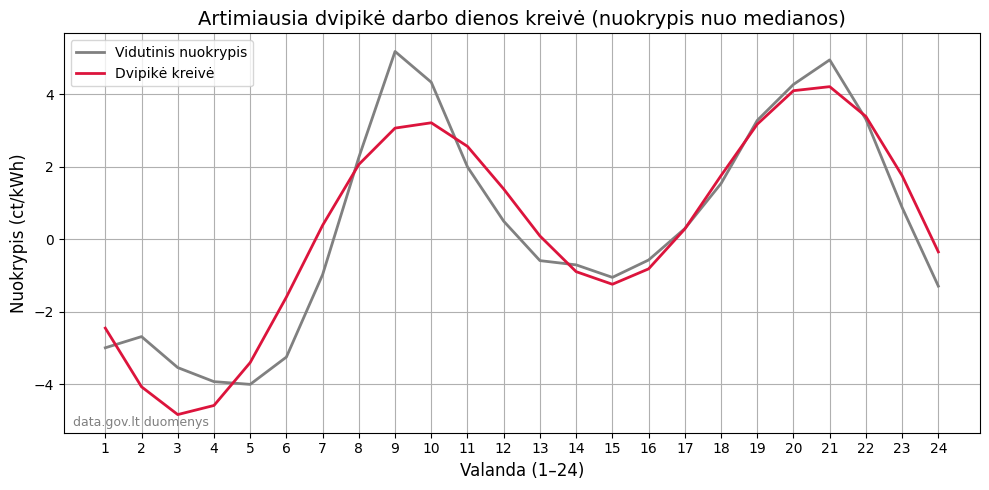

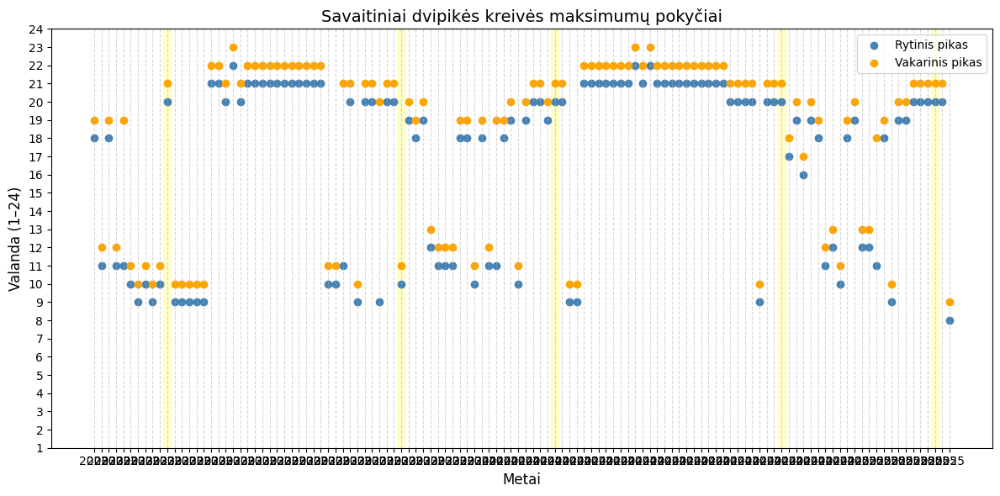

In [31]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['deviation'].mean()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinis nuokrypis', color='gray', linewidth=2)
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (nuokrypis nuo medianos)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Nuokrypis (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()


def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)


def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['deviation'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)
        sorted_indices = np.argsort(fitted_values)[-2:]
        sorted_peaks = hours[sorted_indices] + 1
        sorted_peaks.sort()
        if len(sorted_peaks) == 2:
            weekly_peaks.append((year, week, sorted_peaks[0], sorted_peaks[1]))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak'])
    result_df['Label'] = result_df['Year']

    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)

    plt.scatter(result_df.index, result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df.index, result_df['EveningPeak'], label='Vakarinis pikas', color='orange')

    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai", fontsize=14)
    plt.xlabel("Metai", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.xticks(result_df.index, result_df['Label'], rotation=0)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)


if __name__ == "__main__":
    main()

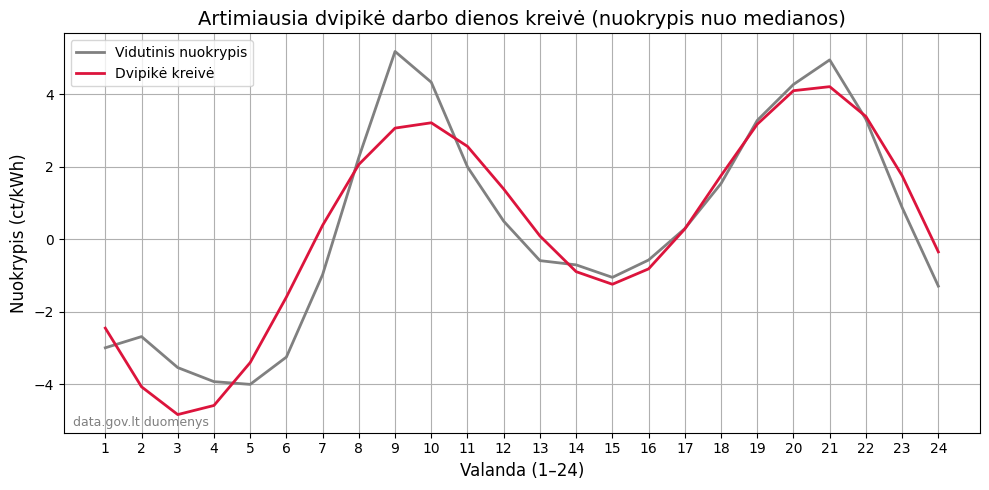

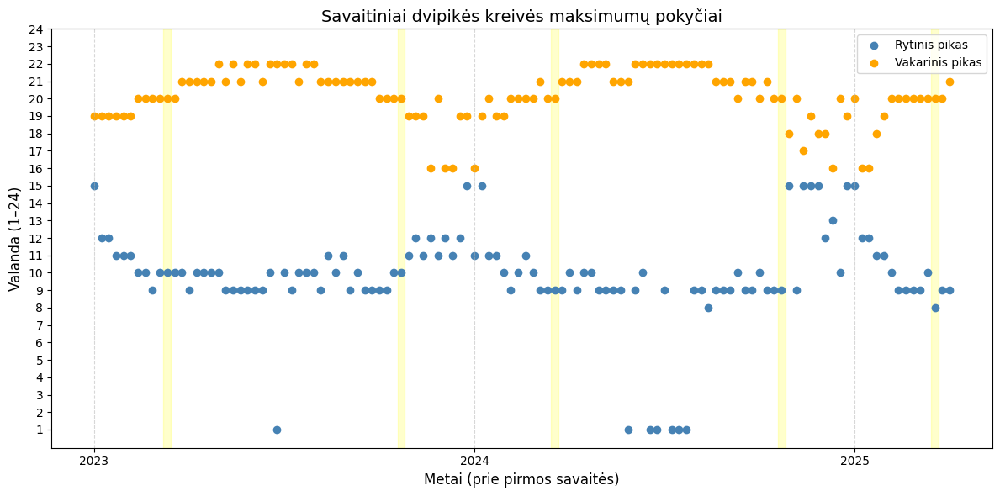

In [32]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['deviation'].mean()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinis nuokrypis', color='gray', linewidth=2)
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (nuokrypis nuo medianos)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Nuokrypis (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()


def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)


def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['deviation'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)

        morning_peak = np.argmax(fitted_values[:15]) + 1
        evening_peak = np.argmax(fitted_values[15:]) + 16

        weekly_peaks.append((year, week, morning_peak, evening_peak))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak'])
    result_df['Index'] = range(len(result_df))

    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)

    plt.scatter(result_df['Index'], result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPeak'], label='Vakarinis pikas', color='orange')

    year_ticks = result_df[result_df['Week'] == 1][['Index', 'Year']]
    plt.xticks(year_ticks['Index'], year_ticks['Year'])

    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)


if __name__ == "__main__":
    main()

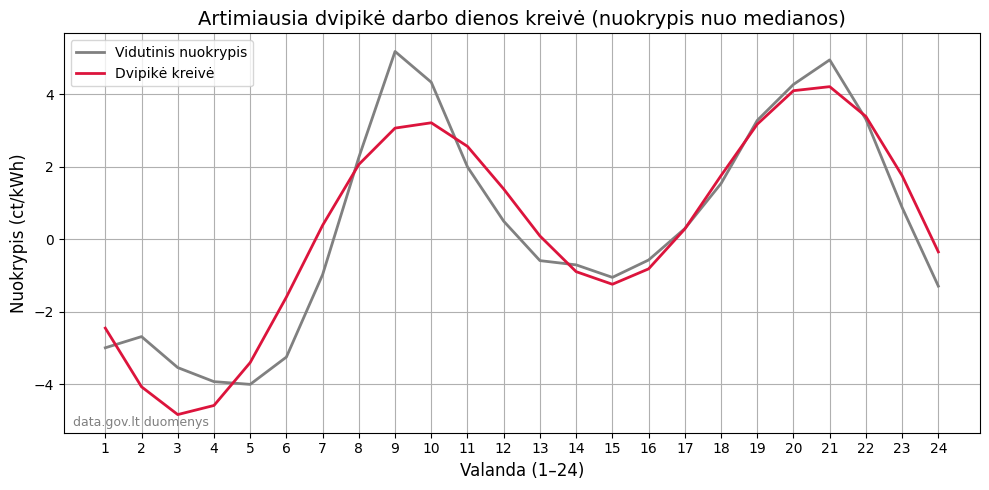

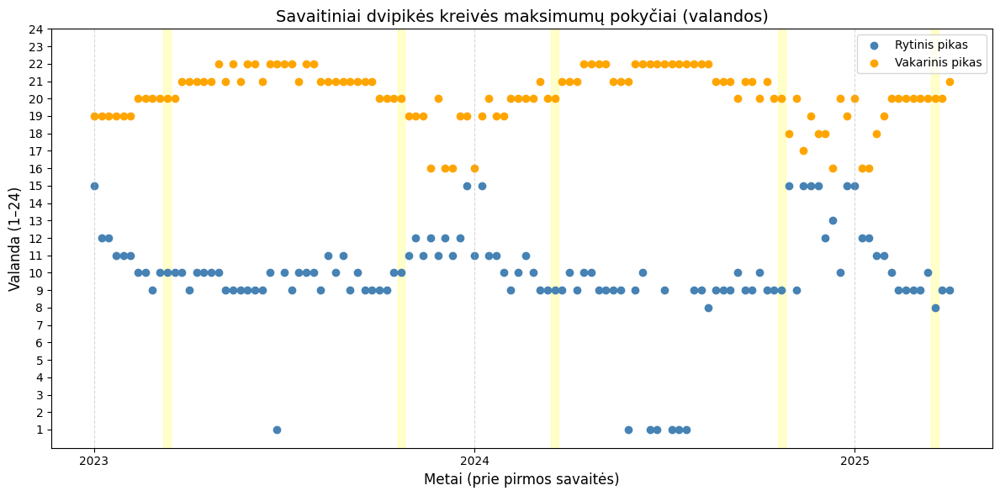

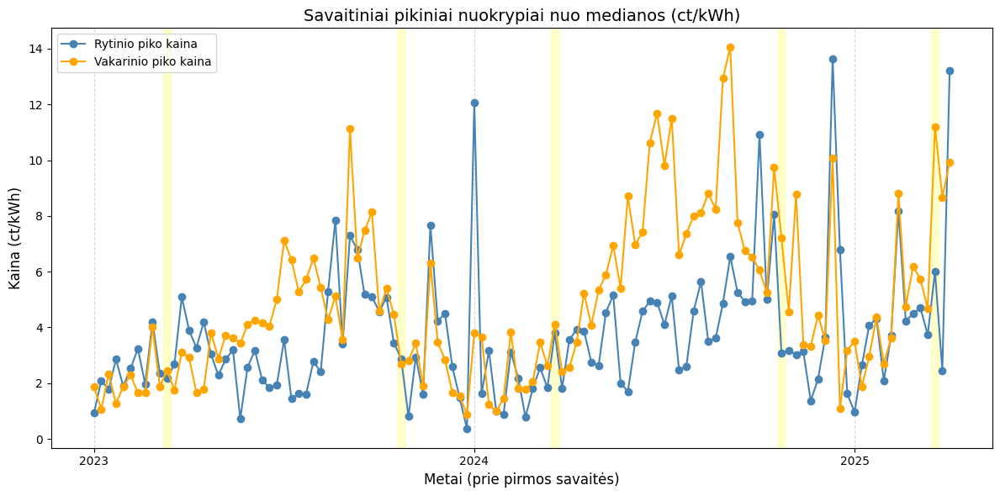

In [33]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['deviation'].mean()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinis nuokrypis', color='gray', linewidth=2)
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (nuokrypis nuo medianos)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Nuokrypis (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()


def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)


def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year
    df['deviation'] = df.groupby(df.index.date)['price_ct_kwh'].transform(lambda x: x - x.median())

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['deviation'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)

        morning_values = fitted_values[:15]
        evening_values = fitted_values[15:]

        if morning_values.max() == morning_values.min() or evening_values.max() == evening_values.min():
            continue

        morning_peak = np.argmax(morning_values) + 1
        evening_peak = np.argmax(evening_values) + 16

        morning_price = morning_values[morning_peak - 1]
        evening_price = evening_values[evening_peak - 16]

        weekly_peaks.append((year, week, morning_peak, evening_peak, morning_price, evening_price))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak', 'MorningPrice', 'EveningPrice'])
    result_df['Index'] = range(len(result_df))

    # Pirmas grafikas – pikinės valandos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPeak'], label='Vakarinis pikas', color='orange')
    year_ticks = result_df[result_df['Week'] == 1][['Index', 'Year']]
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai (valandos)", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Antras grafikas – pikinės kainos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.plot(result_df['Index'], result_df['MorningPrice'], label='Rytinio piko kaina', color='steelblue', marker='o', linestyle='-')
    plt.plot(result_df['Index'], result_df['EveningPrice'], label='Vakarinio piko kaina', color='orange', marker='o', linestyle='-')
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitiniai pikiniai nuokrypiai nuo medianos (ct/kWh)", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)


if __name__ == "__main__":
    main()


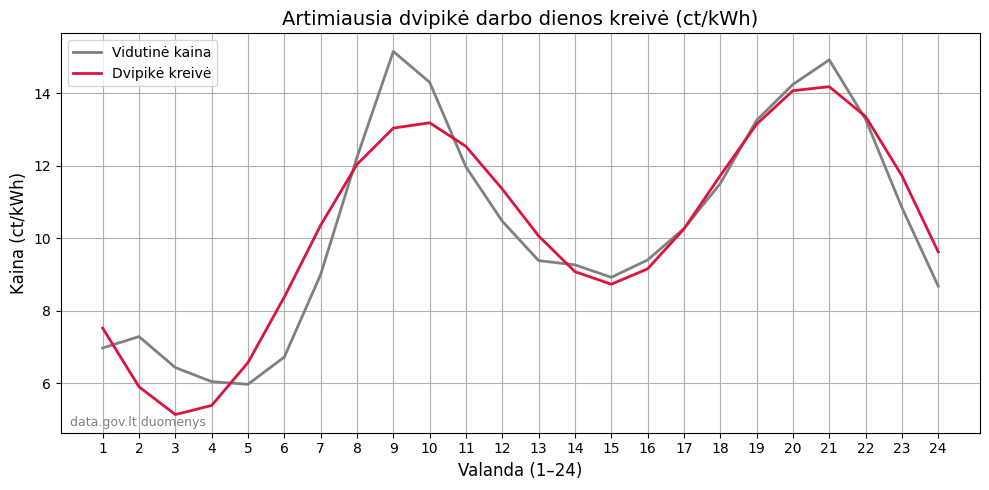

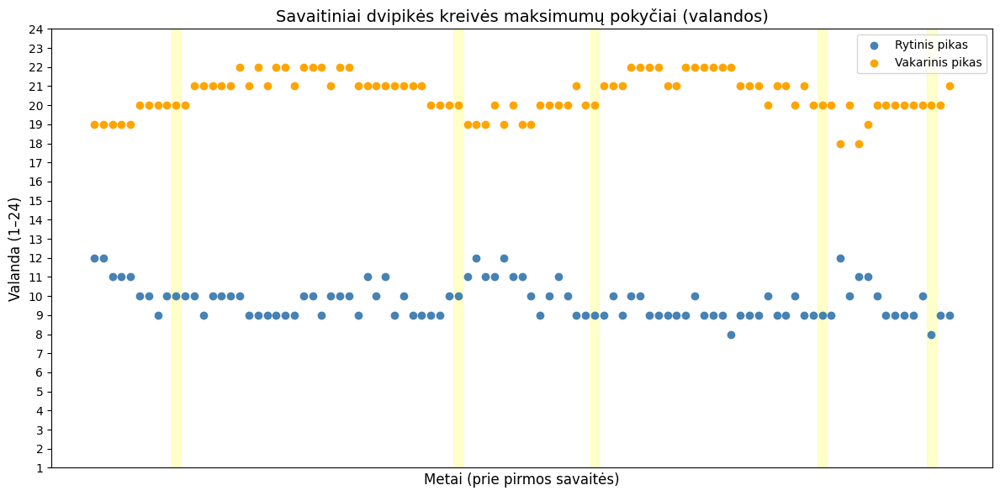

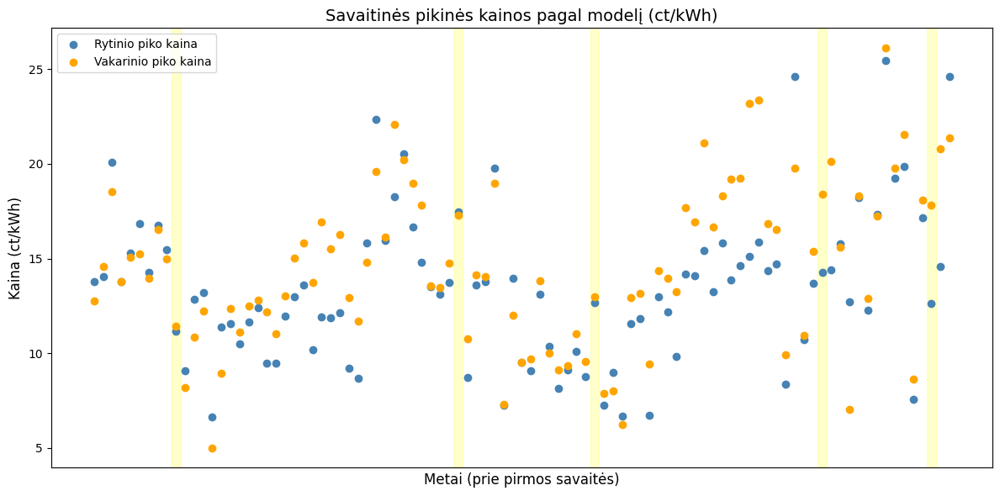

In [35]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['price_ct_kwh'].mean()
    hour_median = workdays.groupby('hour')['price_ct_kwh'].median()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
    plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (ct/kWh)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()

# likusi kodo dalis nesikeičia

def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['price_ct_kwh'].mean()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (ct/kWh)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()


def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)


def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['price_ct_kwh'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)

        morning_values = fitted_values[:15]
        evening_values = fitted_values[15:]

        if (morning_values.max() == morning_values.min() or
            evening_values.max() == evening_values.min() or
            np.argmax(morning_values) in [0, 14] or
            np.argmax(evening_values) in [0, 8]):
            continue

        morning_peak = np.argmax(morning_values) + 1
        evening_peak = np.argmax(evening_values) + 16

        morning_price = morning_values[morning_peak - 1]
        evening_price = evening_values[evening_peak - 16]

        weekly_peaks.append((year, week, morning_peak, evening_peak, morning_price, evening_price))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak', 'MorningPrice', 'EveningPrice'])
    result_df['Index'] = range(len(result_df))

    # Pirmas grafikas – pikinės valandos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPeak'], label='Vakarinis pikas', color='orange')
    year_ticks = result_df[result_df['Week'] == 1][['Index', 'Year']]
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai (valandos)", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Antras grafikas – pikinės kainos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPrice'], label='Rytinio piko kaina', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPrice'], label='Vakarinio piko kaina', color='orange')
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitinės pikinės kainos pagal modelį (ct/kWh)", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)


if __name__ == "__main__":
    main()

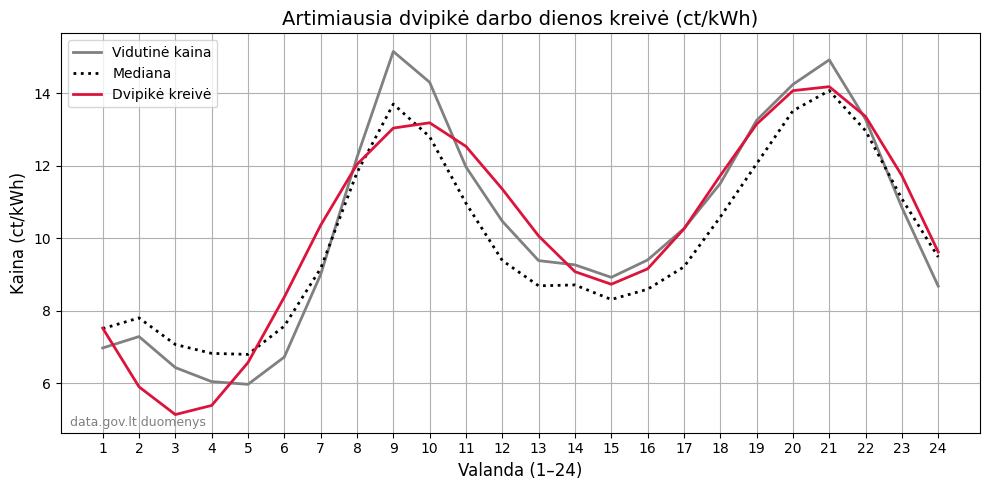

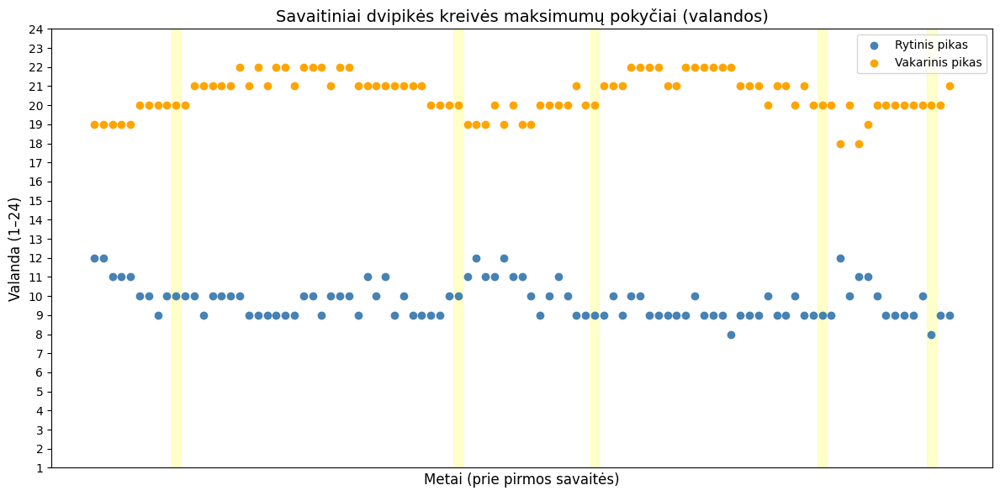

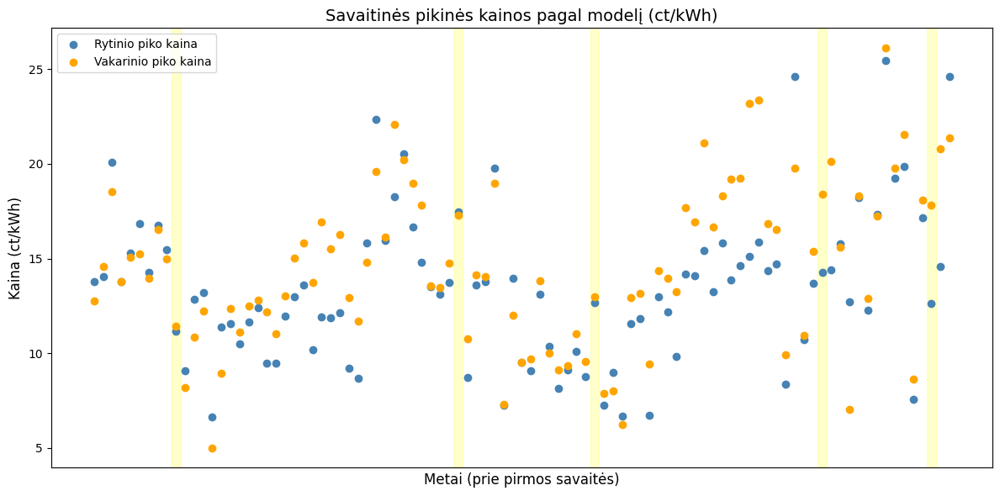

In [37]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['price_ct_kwh'].mean()
    hour_median = workdays.groupby('hour')['price_ct_kwh'].median()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
    plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (ct/kWh)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()

# likusi kodo dalis nesikeičia

def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)


def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['price_ct_kwh'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)

        morning_values = fitted_values[:15]
        evening_values = fitted_values[15:]

        if (morning_values.max() == morning_values.min() or
            evening_values.max() == evening_values.min() or
            np.argmax(morning_values) in [0, 14] or
            np.argmax(evening_values) in [0, 8]):
            continue

        morning_peak = np.argmax(morning_values) + 1
        evening_peak = np.argmax(evening_values) + 16

        morning_price = morning_values[morning_peak - 1]
        evening_price = evening_values[evening_peak - 16]

        weekly_peaks.append((year, week, morning_peak, evening_peak, morning_price, evening_price))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak', 'MorningPrice', 'EveningPrice'])
    result_df['Index'] = range(len(result_df))

    # Pirmas grafikas – pikinės valandos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPeak'], label='Vakarinis pikas', color='orange')
    year_ticks = result_df[result_df['Week'] == 1][['Index', 'Year']]
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai (valandos)", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Antras grafikas – pikinės kainos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPrice'], label='Rytinio piko kaina', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPrice'], label='Vakarinio piko kaina', color='orange')
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitinės pikinės kainos pagal modelį (ct/kWh)", fontsize=14)
    plt.xlabel("Metai (prie pirmos savaitės)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)


if __name__ == "__main__":
    main()


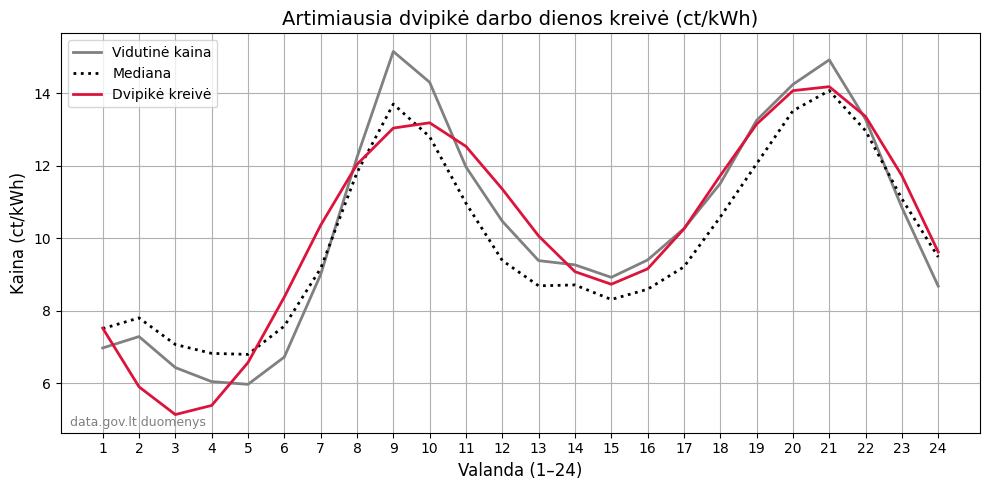

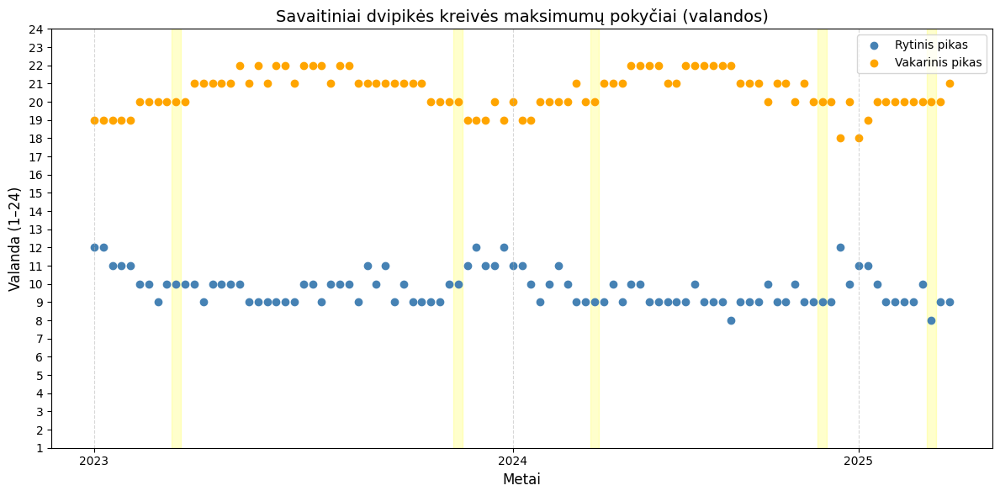

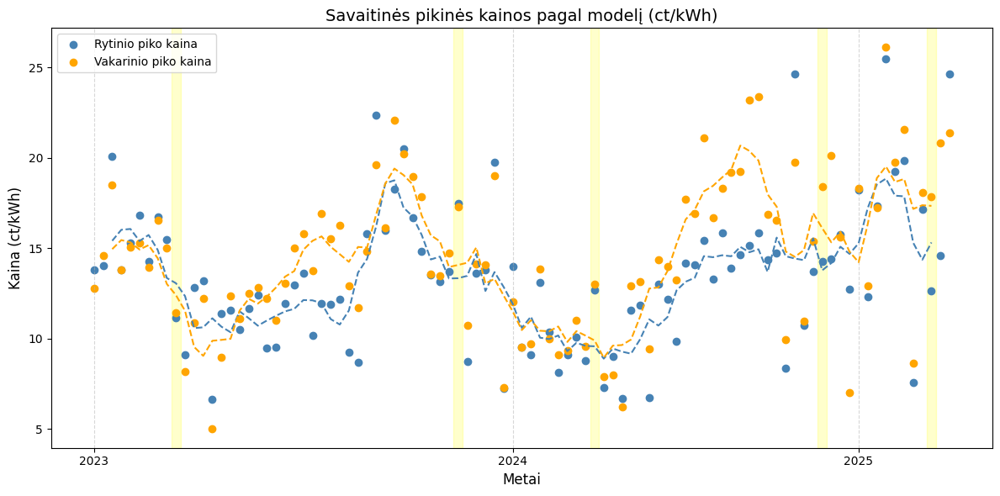

In [ ]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    workdays = df[df['weekday']<5]
    hour_avg = workdays.groupby('hour')['price_ct_kwh'].mean()
    hour_median = workdays.groupby('hour')['price_ct_kwh'].median()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
    plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (ct/kWh)", fontsize=14)
    plt.xlabel("Valanda", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()

def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)

def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['price_ct_kwh'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)

        morning_values = fitted_values[:15]
        evening_values = fitted_values[15:]

        if (morning_values.max() == morning_values.min() or
            evening_values.max() == evening_values.min() or
            np.argmax(morning_values) in [0, 14] or
            np.argmax(evening_values) in [0, 8]):
            continue

        morning_peak = np.argmax(morning_values) + 1
        evening_peak = np.argmax(evening_values) + 16

        morning_price = morning_values[morning_peak - 1]
        evening_price = evening_values[evening_peak - 16]

        weekly_peaks.append((year, week, morning_peak, evening_peak, morning_price, evening_price))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak', 'MorningPrice', 'EveningPrice'])
    result_df['Index'] = range(len(result_df))

    # Pirmas grafikas – pikinės valandos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPeak'], label='Vakarinis pikas', color='orange')
    year_ticks = result_df.drop_duplicates(subset='Year', keep='first')[['Index', 'Year']]
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai (valandos)", fontsize=14)
    plt.xlabel("Metai", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Antrasis grafikas – pikinės kainos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPrice'], label='Rytinio piko kaina', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPrice'], label='Vakarinio piko kaina', color='orange')
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitinės pikinės kainos pagal modelį (ct/kWh)", fontsize=14)
    plt.xlabel("Metai", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    
    window = 5
    result_df['MorningSmooth'] = result_df['MorningPrice'].rolling(window, center=True).mean()
    result_df['EveningSmooth'] = result_df['EveningPrice'].rolling(window, center=True).mean()

    plt.plot(result_df['Index'], result_df['MorningSmooth'], label='Rytinio piko slankusis vidurkis', color='steelblue', linestyle='--')
    plt.plot(result_df['Index'], result_df['EveningSmooth'], label='Vakarinio piko slankusis vidurkis', color='orange', linestyle='--')

def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)

if __name__ == "__main__":
    main()


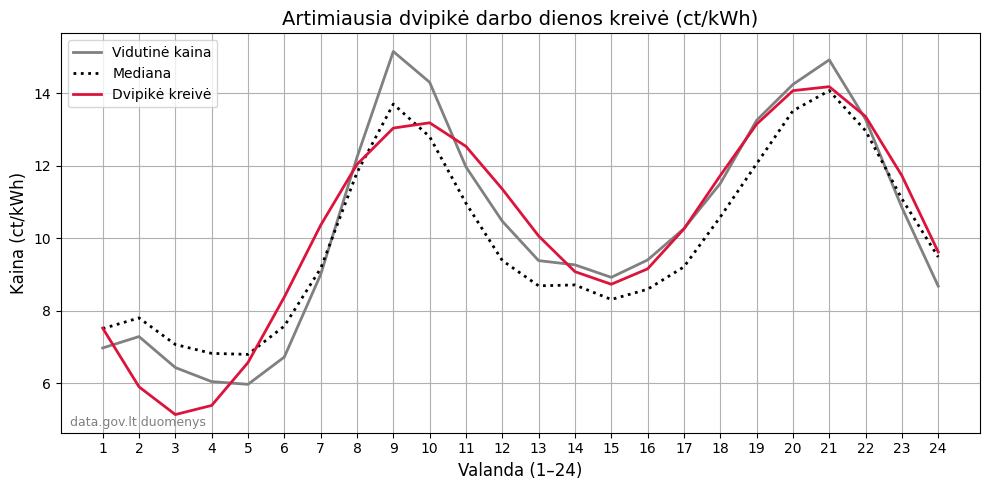

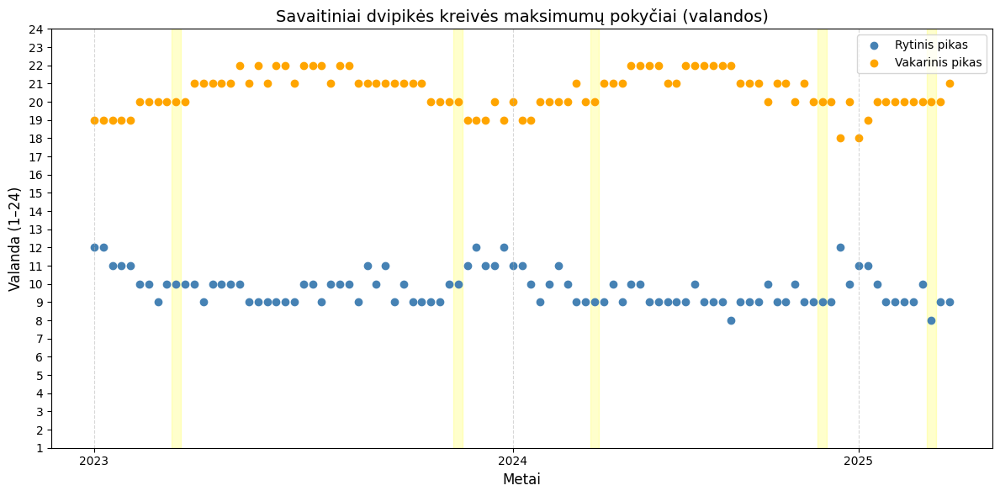

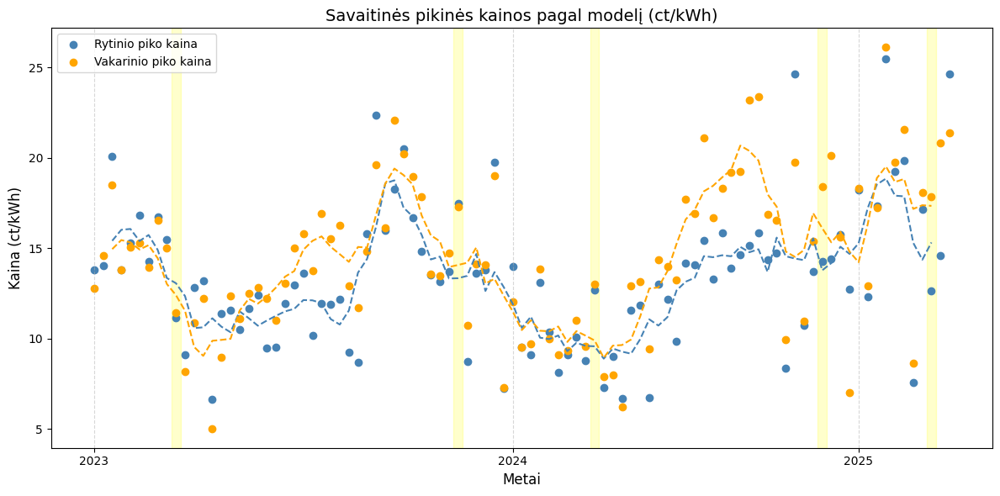

In [39]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def plot_fitted_double_peak(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date

    workdays = df[df['weekday'] < 5]
    hour_avg = workdays.groupby('hour')['price_ct_kwh'].mean()
    hour_median = workdays.groupby('hour')['price_ct_kwh'].median()

    hours = np.arange(24)
    values = hour_avg.values

    fitted_func, params = fit_two_peak_cosine(hours, values)
    fitted_values = fitted_func(hours)

    plt.figure(figsize=(10, 5))
    plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
    plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
    plt.plot(hours + 1, fitted_values, label='Dvipikė kreivė', color='crimson', linestyle='-', linewidth=2)

    plt.title("Artimiausia dvipikė darbo dienos kreivė (ct/kWh)", fontsize=14)
    plt.xlabel("Valanda (1–24)", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.xticks(range(1, 25))
    plt.grid(True)
    plt.legend()
    plt.text(0.01, 0.01, 'data.gov.lt duomenys', transform=plt.gca().transAxes,
             ha='left', va='bottom', fontsize=9, color='gray')
    plt.tight_layout()
    plt.show()

def get_dst_weeks(df: pd.DataFrame):
    tz = pytz.timezone("Europe/Vilnius")
    transitions = []
    for year in df.index.year.unique():
        try:
            start = tz.localize(datetime(year, 3, 31)).astimezone(pytz.utc)
            while start.astimezone(tz).weekday() != 6 or start.astimezone(tz).hour != 3:
                start -= pd.Timedelta(hours=1)
            end = tz.localize(datetime(year, 10, 31)).astimezone(pytz.utc)
            while end.astimezone(tz).weekday() != 6 or end.astimezone(tz).hour != 4:
                end -= pd.Timedelta(hours=1)
            transitions.append((start.date().isocalendar()[1], start.year))
            transitions.append((end.date().isocalendar()[1], end.year))
        except Exception:
            continue
    return set(transitions)

def plot_weekly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['date'] = df.index.date
    df['week'] = df.index.isocalendar().week
    df['year'] = df.index.isocalendar().year

    dst_weeks = get_dst_weeks(df)

    workdays = df[df['weekday'] < 5]
    weekly_peaks = []

    for (year, week), group in workdays.groupby(['year', 'week']):
        hour_avg = group.groupby('hour')['price_ct_kwh'].mean()
        if len(hour_avg) < 24:
            continue
        hours = np.arange(24)
        fitted_func, _ = fit_two_peak_cosine(hours, hour_avg.values)
        fitted_values = fitted_func(hours)

        morning_values = fitted_values[:15]
        evening_values = fitted_values[15:]

        if (morning_values.max() == morning_values.min() or
            evening_values.max() == evening_values.min() or
            np.argmax(morning_values) in [0, 14] or
            np.argmax(evening_values) in [0, 8]):
            continue

        morning_peak = np.argmax(morning_values) + 1
        evening_peak = np.argmax(evening_values) + 16

        morning_price = morning_values[morning_peak - 1]
        evening_price = evening_values[evening_peak - 16]

        weekly_peaks.append((year, week, morning_peak, evening_peak, morning_price, evening_price))

    result_df = pd.DataFrame(weekly_peaks, columns=['Year', 'Week', 'MorningPeak', 'EveningPeak', 'MorningPrice', 'EveningPrice'])
    result_df['Index'] = range(len(result_df))

    # Pirmas grafikas – pikinės valandos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPeak'], label='Rytinis pikas', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPeak'], label='Vakarinis pikas', color='orange')
    year_ticks = result_df.drop_duplicates(subset='Year', keep='first')[['Index', 'Year']]
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitiniai dvipikės kreivės maksimumų pokyčiai (valandos)", fontsize=14)
    plt.xlabel("Metai", fontsize=12)
    plt.ylabel("Valanda (1–24)", fontsize=12)
    plt.yticks(range(1, 25))
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()

    # Antras grafikas – pikinės kainos
    plt.figure(figsize=(12, 6))
    for i, row in result_df.iterrows():
        if (row['Week'], row['Year']) in dst_weeks:
            plt.axvspan(i - 0.5, i + 0.5, color='yellow', alpha=0.2)
    plt.scatter(result_df['Index'], result_df['MorningPrice'], label='Rytinio piko kaina', color='steelblue')
    plt.scatter(result_df['Index'], result_df['EveningPrice'], label='Vakarinio piko kaina', color='orange')
    plt.xticks(year_ticks['Index'], year_ticks['Year'])
    plt.title("Savaitinės pikinės kainos pagal modelį (ct/kWh)", fontsize=14)
    plt.xlabel("Metai", fontsize=12)
    plt.ylabel("Kaina (ct/kWh)", fontsize=12)
    plt.grid(True, axis='x', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    
    window = 5
    result_df['MorningSmooth'] = result_df['MorningPrice'].rolling(window, center=True).mean()
    result_df['EveningSmooth'] = result_df['EveningPrice'].rolling(window, center=True).mean()

    plt.plot(result_df['Index'], result_df['MorningSmooth'], label='Rytinio piko slankusis vidurkis', color='steelblue', linestyle='--')
    plt.plot(result_df['Index'], result_df['EveningSmooth'], label='Vakarinio piko slankusis vidurkis', color='orange', linestyle='--')

def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_fitted_double_peak(df)
    plot_weekly_peak_positions(df)

if __name__ == "__main__":
    main()



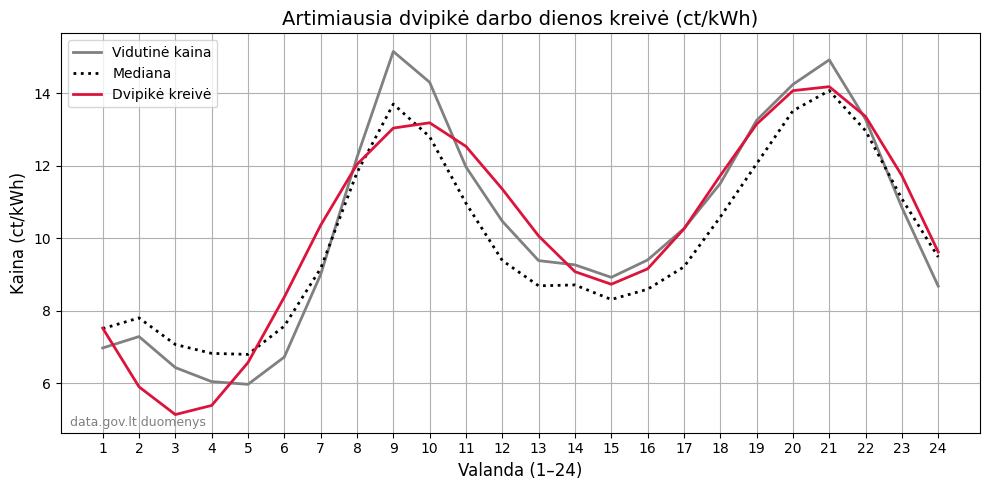

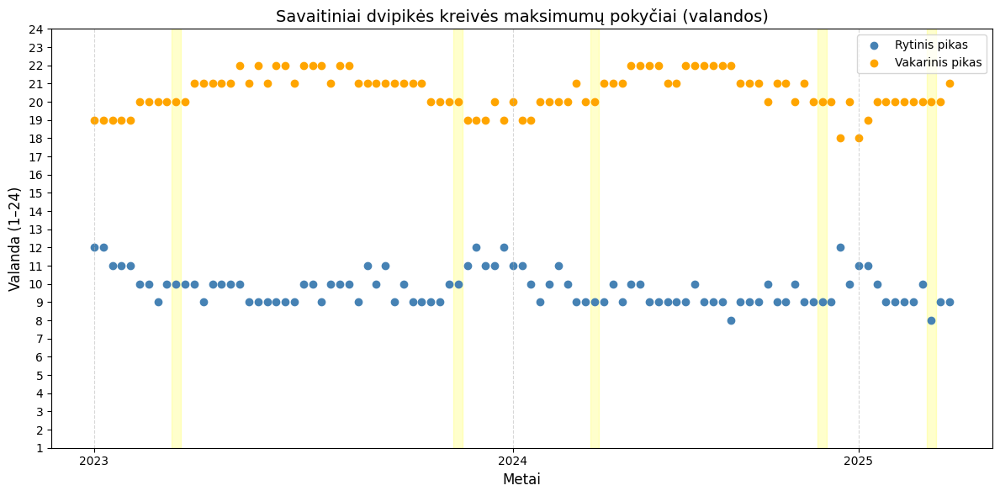

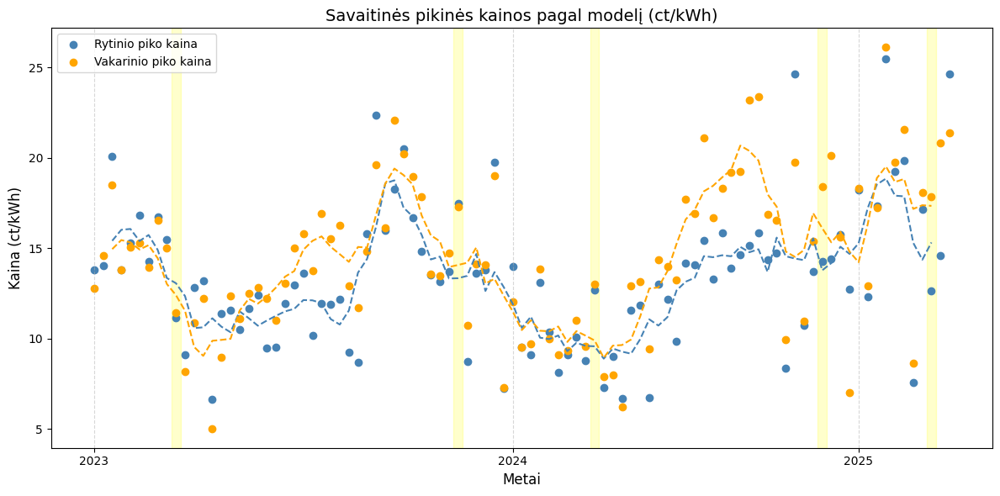

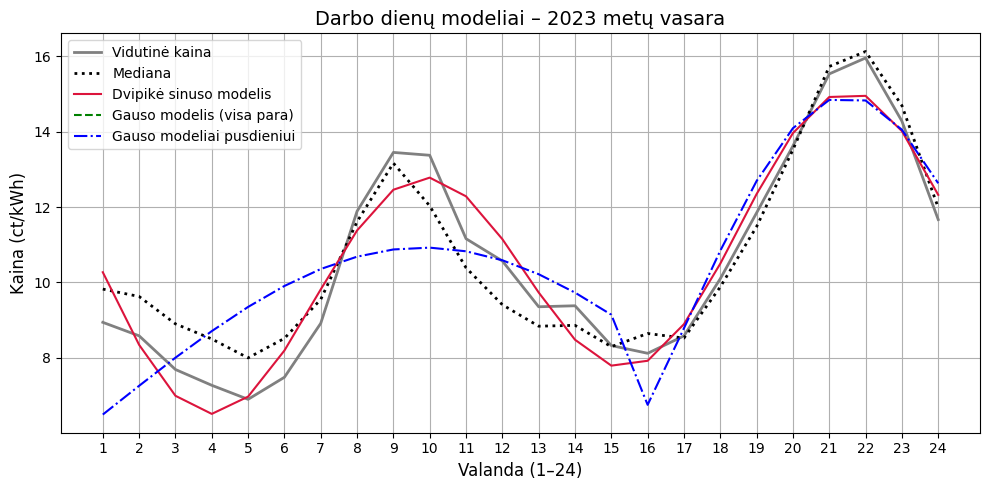

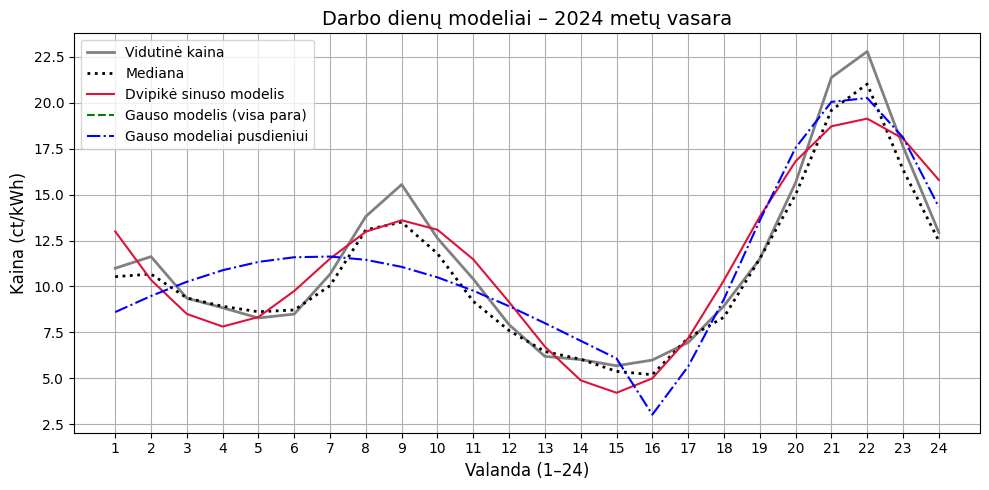

In [43]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def fit_gaussian(x: np.ndarray, y: np.ndarray):
    def gauss(x, a, mu, sigma):
        return a * np.exp(-(x - mu) ** 2 / (2 * sigma ** 2))
    init_params = [max(y), x[np.argmax(y)], 2.0]
    try:
        popt, _ = curve_fit(gauss, x, y, p0=init_params)
        return lambda h: gauss(h, *popt), popt
    except RuntimeError:
        return lambda h: np.full_like(h, np.nan, dtype=float), init_params


def plot_model_comparison_for_each_summer(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    summers = df[(df['weekday'] < 5) & (df['month'].isin([6, 7, 8]))]

    for year in sorted(summers['year'].unique()):
        subset = summers[summers['year'] == year]
        hour_avg = subset.groupby('hour')['price_ct_kwh'].mean()
        hour_median = subset.groupby('hour')['price_ct_kwh'].median()
        hours = np.arange(24)
        values = hour_avg.values

        cosine_model, _ = fit_two_peak_cosine(hours, values)
        cosine_vals = cosine_model(hours)

        gauss_full_model, _ = fit_gaussian(hours, values)
        gauss_full_vals = gauss_full_model(hours)

        gauss_morning_model, _ = fit_gaussian(hours[:15], values[:15])
        gauss_evening_model, _ = fit_gaussian(hours[15:], values[15:])
        gauss_split_vals = np.concatenate([gauss_morning_model(hours[:15]), gauss_evening_model(hours[15:])])

        plt.figure(figsize=(10, 5))
        plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
        plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
        plt.plot(hours + 1, cosine_vals, label='Dvipikė sinuso modelis', color='crimson', linestyle='-')
        plt.plot(hours + 1, gauss_full_vals, label='Gauso modelis (visa para)', color='green', linestyle='--')
        plt.plot(hours + 1, gauss_split_vals, label='Gauso modeliai pusdieniui', color='blue', linestyle='-.')

        plt.title(f"Darbo dienų modeliai – {year} metų vasara", fontsize=14)
        plt.xlabel("Valanda (1–24)", fontsize=12)
        plt.ylabel("Kaina (ct/kWh)", fontsize=12)
        plt.xticks(range(1, 25))
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_model_comparison_for_each_summer(df)


if __name__ == "__main__":
    main()


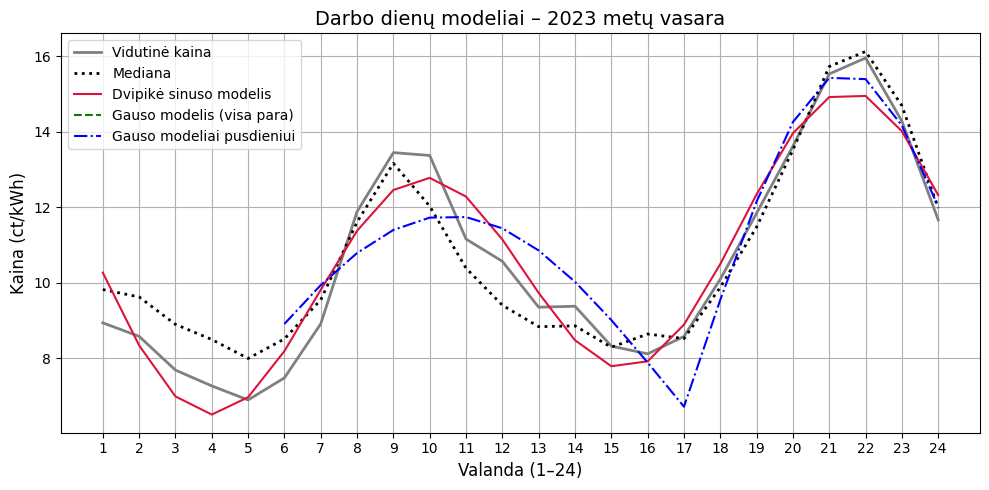

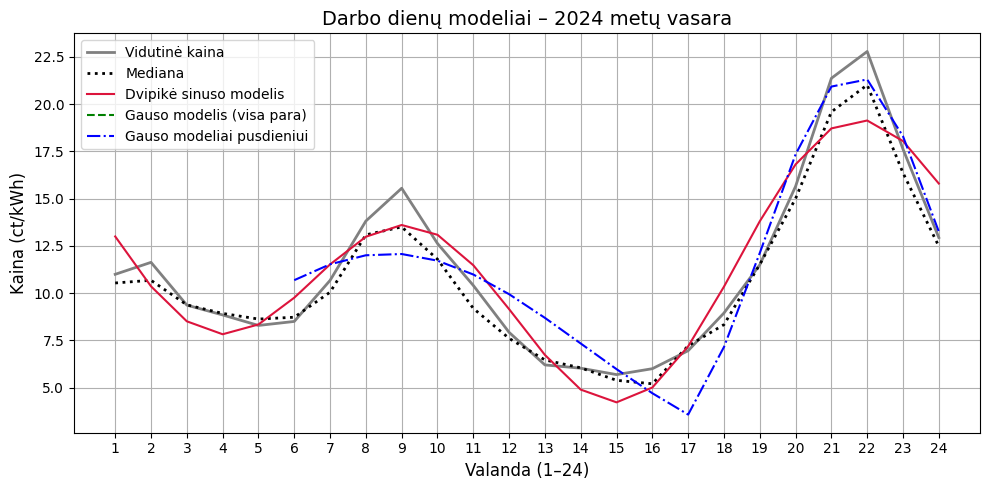

In [44]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def fit_gaussian(x: np.ndarray, y: np.ndarray):
    def gauss(x, a, mu, sigma):
        return a * np.exp(-(x - mu) ** 2 / (2 * sigma ** 2))
    init_params = [max(y), x[np.argmax(y)], 2.0]
    try:
        popt, _ = curve_fit(gauss, x, y, p0=init_params)
        return lambda h: gauss(h, *popt), popt
    except RuntimeError:
        return lambda h: np.full_like(h, np.nan, dtype=float), init_params


def plot_model_comparison_for_each_summer(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    summers = df[(df['weekday'] < 5) & (df['month'].isin([6, 7, 8]))]

    for year in sorted(summers['year'].unique()):
        subset = summers[summers['year'] == year]
        hour_avg = subset.groupby('hour')['price_ct_kwh'].mean()
        hour_median = subset.groupby('hour')['price_ct_kwh'].median()
        hours = np.arange(24)
        values = hour_avg.values

        cosine_model, _ = fit_two_peak_cosine(hours, values)
        cosine_vals = cosine_model(hours)

        gauss_full_model, _ = fit_gaussian(hours, values)
        gauss_full_vals = gauss_full_model(hours)

        gauss_morning_model, _ = fit_gaussian(hours[5:17], values[5:17])
        gauss_evening_model, _ = fit_gaussian(hours[17:], values[17:])
        gauss_split_vals = np.concatenate([
    np.full(5, np.nan),
    gauss_morning_model(hours[5:17]),
    gauss_evening_model(hours[17:])
])

        plt.figure(figsize=(10, 5))
        plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
        plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
        plt.plot(hours + 1, cosine_vals, label='Dvipikė sinuso modelis', color='crimson', linestyle='-')
        plt.plot(hours + 1, gauss_full_vals, label='Gauso modelis (visa para)', color='green', linestyle='--')
        plt.plot(hours + 1, gauss_split_vals, label='Gauso modeliai pusdieniui', color='blue', linestyle='-.')

        plt.title(f"Darbo dienų modeliai – {year} metų vasara", fontsize=14)
        plt.xlabel("Valanda (1–24)", fontsize=12)
        plt.ylabel("Kaina (ct/kWh)", fontsize=12)
        plt.xticks(range(1, 25))
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_model_comparison_for_each_summer(df)


if __name__ == "__main__":
    main()


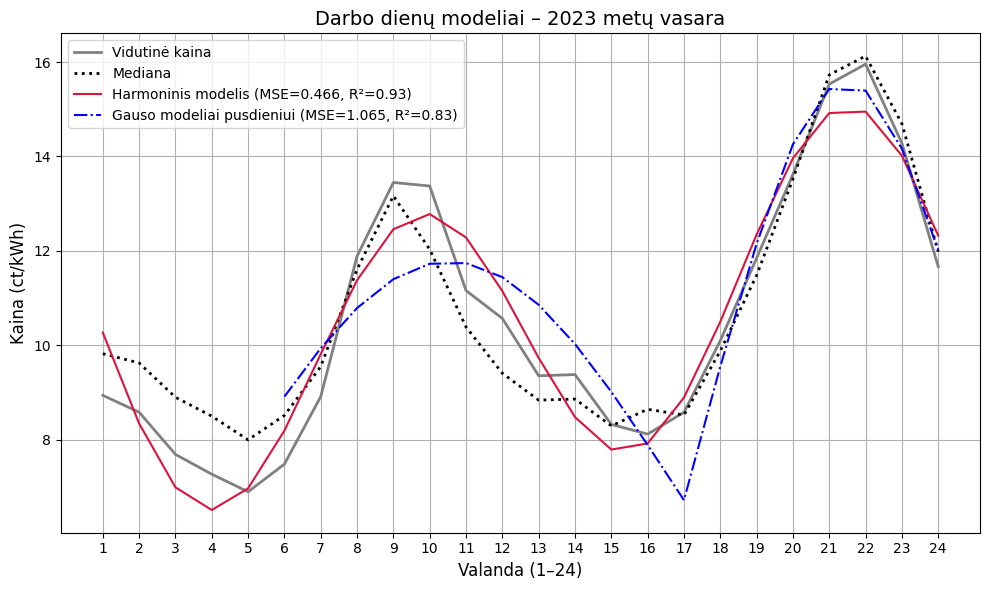

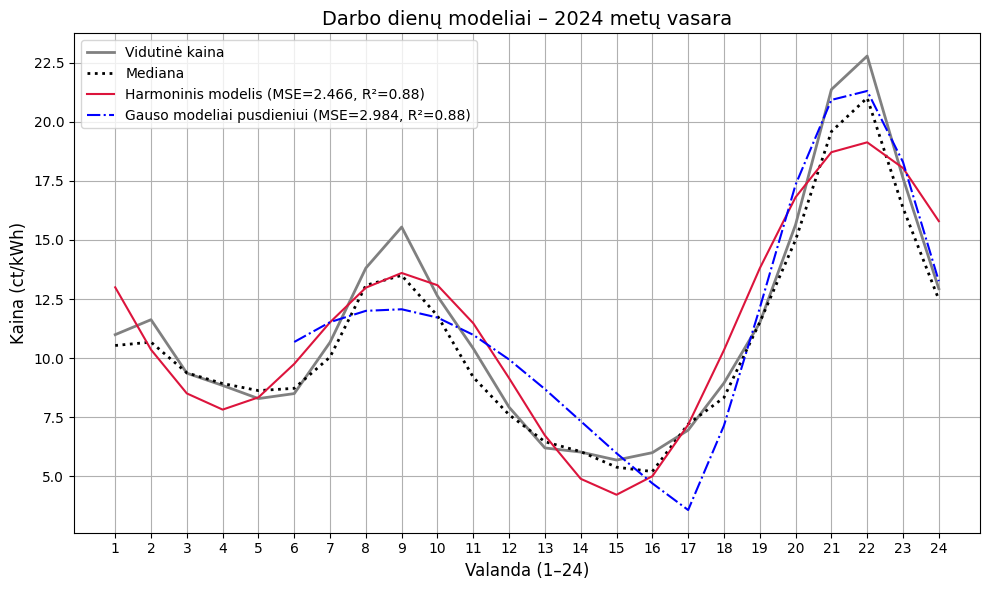

In [51]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit
from sklearn.metrics import mean_squared_error, r2_score


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def fit_gaussian(x: np.ndarray, y: np.ndarray):
    if len(x) == 0 or len(y) == 0:
        return lambda h: np.full_like(h, np.nan, dtype=float), [np.nan, np.nan, np.nan]

    def gauss(x, a, mu, sigma):
        return a * np.exp(-(x - mu) ** 2 / (2 * sigma ** 2))

    init_params = [max(y), x[np.argmax(y)], 2.0]
    try:
        popt, _ = curve_fit(gauss, x, y, p0=init_params)
        return lambda h: gauss(h, *popt), popt
    except RuntimeError:
        return lambda h: np.full_like(h, np.nan, dtype=float), init_params


def plot_model_comparison_for_each_summer(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    summers = df[(df['weekday'] < 5) & (df['month'].isin([6, 7, 8]))]

    for year in sorted(summers['year'].unique()):
        subset = summers[summers['year'] == year]
        hour_avg = subset.groupby('hour')['price_ct_kwh'].mean()
        hour_median = subset.groupby('hour')['price_ct_kwh'].median()
        hours = np.arange(24)
        values = hour_avg.values

        cosine_model, _ = fit_two_peak_cosine(hours, values)
        cosine_vals = cosine_model(hours)

        gauss_morning_model, _ = fit_gaussian(hours[5:17], values[5:17])
        gauss_evening_model, _ = fit_gaussian(hours[17:], values[17:])
        gauss_split_vals = np.concatenate([
            np.full(5, np.nan),
            gauss_morning_model(hours[5:17]),
            gauss_evening_model(hours[17:])
        ])

        # Skaičiuojame metrikas tik kur nėra NaN
        mask_cosine = ~np.isnan(cosine_vals)
        mask_split = ~np.isnan(gauss_split_vals)

        metrics = {
            'Cosine': (
                mean_squared_error(values[mask_cosine], cosine_vals[mask_cosine]),
                r2_score(values[mask_cosine], cosine_vals[mask_cosine])
            ),
            'Gaussian (split)': (
                mean_squared_error(values[mask_split], gauss_split_vals[mask_split]),
                r2_score(values[mask_split], gauss_split_vals[mask_split])
            )
        }

        plt.figure(figsize=(10, 6))
        plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
        plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
        plt.plot(hours + 1, cosine_vals,
                 label=f'Harmoninis modelis (MSE={metrics["Cosine"][0]:.3f}, R²={metrics["Cosine"][1]:.2f})',
                 color='crimson')
        plt.plot(hours + 1, gauss_split_vals,
                 label=f'Gauso modeliai pusdieniui (MSE={metrics["Gaussian (split)"][0]:.3f}, R²={metrics["Gaussian (split)"][1]:.2f})',
                 color='blue', linestyle='-.')

        plt.title(f"Darbo dienų modeliai – {year} metų vasara", fontsize=14)
        plt.xlabel("Valanda (1–24)", fontsize=12)
        plt.ylabel("Kaina (ct/kWh)", fontsize=12)
        plt.xticks(range(1, 25))
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_model_comparison_for_each_summer(df)


if __name__ == "__main__":
    main()

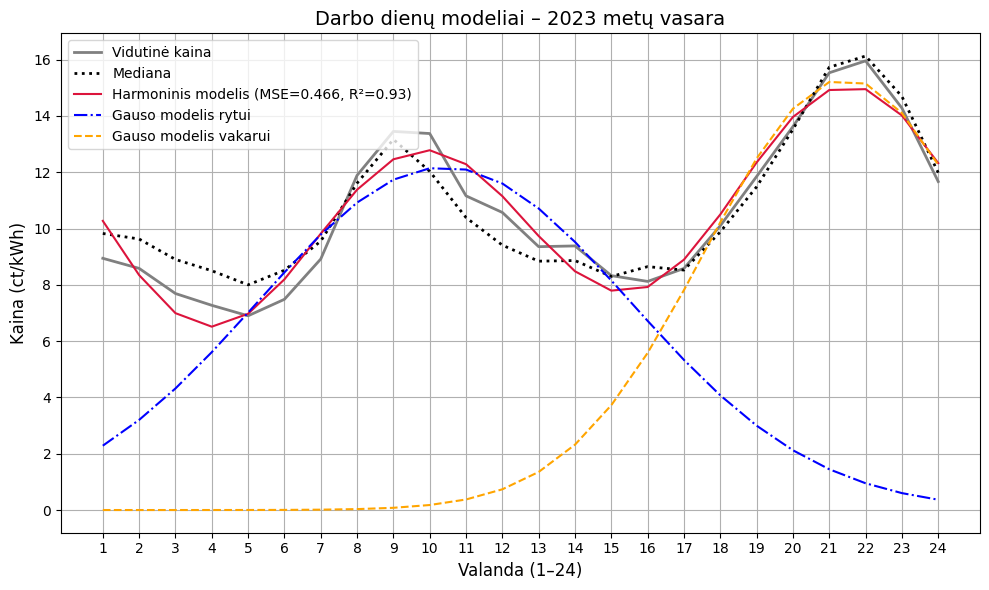

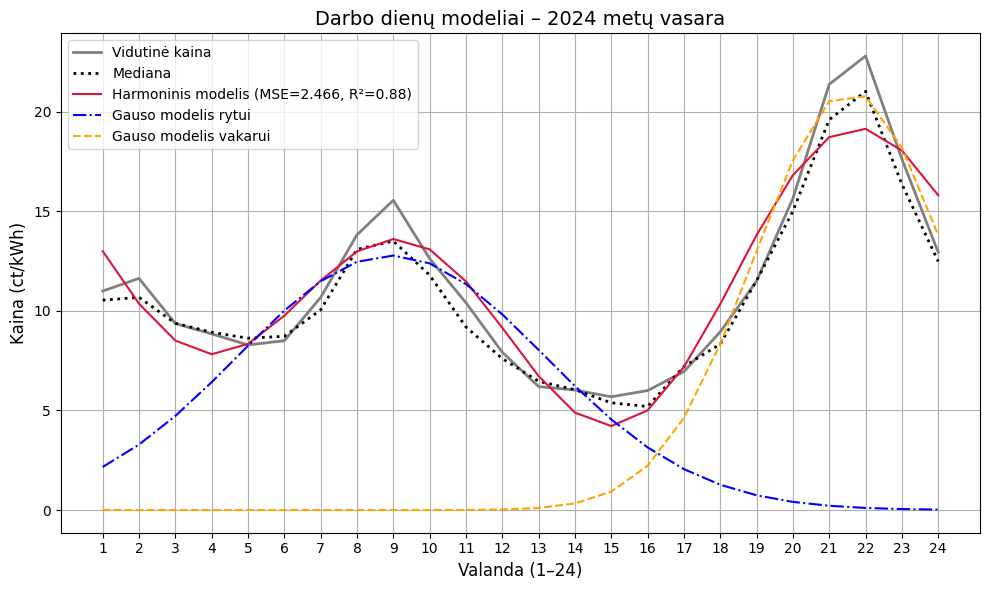

In [56]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit
from sklearn.metrics import mean_squared_error, r2_score


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def fit_gaussian(x: np.ndarray, y: np.ndarray):
    if len(x) == 0 or len(y) == 0:
        return lambda h: np.full_like(h, np.nan, dtype=float), [np.nan, np.nan, np.nan]

    def gauss(x, a, mu, sigma):
        return a * np.exp(-(x - mu) ** 2 / (2 * sigma ** 2))

    init_params = [max(y), x[np.argmax(y)], 2.0]
    try:
        popt, _ = curve_fit(gauss, x, y, p0=init_params)
        return lambda h: gauss(h, *popt), popt
    except RuntimeError:
        return lambda h: np.full_like(h, np.nan, dtype=float), init_params


def plot_model_comparison_for_each_summer(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    summers = df[(df['weekday'] < 5) & (df['month'].isin([6, 7, 8]))]

    for year in sorted(summers['year'].unique()):
        subset = summers[summers['year'] == year]
        hour_avg = subset.groupby('hour')['price_ct_kwh'].mean()
        hour_median = subset.groupby('hour')['price_ct_kwh'].median()
        hours = np.arange(24)
        values = hour_avg.values

        cosine_model, _ = fit_two_peak_cosine(hours, values)
        cosine_vals = cosine_model(hours)

        gauss_morning_model, _ = fit_gaussian(hours[4:16], values[4:16])
        gauss_evening_model, _ = fit_gaussian(hours[16:], values[16:])
        gauss_morning_vals = gauss_morning_model(hours)
        gauss_evening_vals = gauss_evening_model(hours)
        gauss_split_vals = np.where(~np.isnan(gauss_morning_vals), gauss_morning_vals, gauss_evening_vals)

        mask_cosine = ~np.isnan(cosine_vals)
        mask_split = ~np.isnan(gauss_split_vals)

        metrics = {
            'Cosine': (
                mean_squared_error(values[mask_cosine], cosine_vals[mask_cosine]),
                r2_score(values[mask_cosine], cosine_vals[mask_cosine])
            ),
            'Gaussian (split)': (
                mean_squared_error(values[mask_split], gauss_split_vals[mask_split]),
                r2_score(values[mask_split], gauss_split_vals[mask_split])
            )
        }

        plt.figure(figsize=(10, 6))
        plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
        plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
        plt.plot(hours + 1, cosine_vals,
                 label=f'Harmoninis modelis (MSE={metrics["Cosine"][0]:.3f}, R²={metrics["Cosine"][1]:.2f})',
                 color='crimson')
        plt.plot(hours + 1, gauss_morning_vals,
                 label='Gauso modelis rytui', color='blue', linestyle='-.')
        plt.plot(hours + 1, gauss_evening_vals,
                 label='Gauso modelis vakarui', color='orange', linestyle='--')

        plt.title(f"Darbo dienų modeliai – {year} metų vasara", fontsize=14)
        plt.xlabel("Valanda (1–24)", fontsize=12)
        plt.ylabel("Kaina (ct/kWh)", fontsize=12)
        plt.xticks(range(1, 25))
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_model_comparison_for_each_summer(df)


if __name__ == "__main__":
    main()


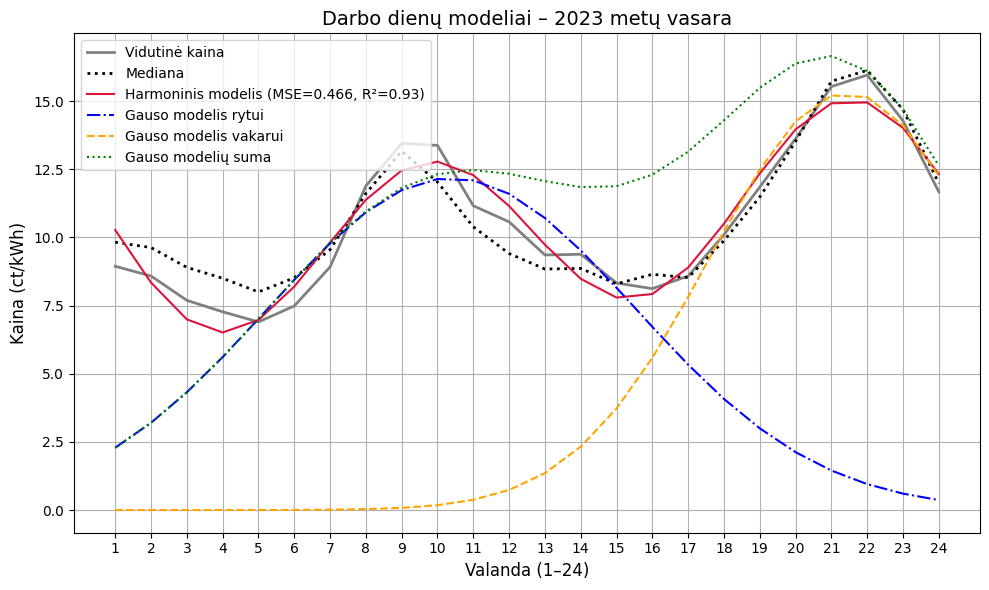

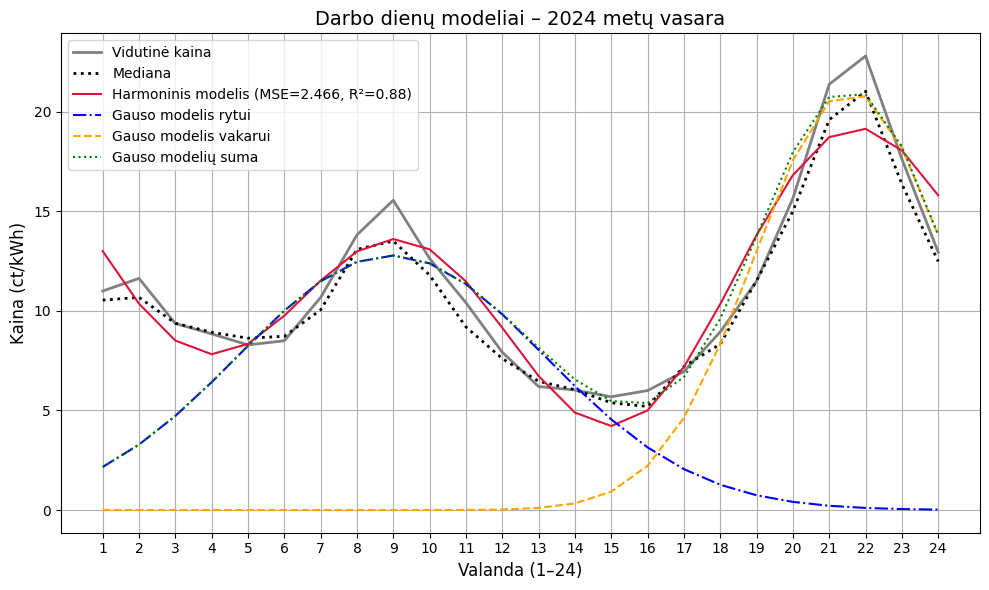

In [57]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit
from sklearn.metrics import mean_squared_error, r2_score


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def fit_gaussian(x: np.ndarray, y: np.ndarray):
    if len(x) == 0 or len(y) == 0:
        return lambda h: np.full_like(h, np.nan, dtype=float), [np.nan, np.nan, np.nan]

    def gauss(x, a, mu, sigma):
        return a * np.exp(-(x - mu) ** 2 / (2 * sigma ** 2))

    init_params = [max(y), x[np.argmax(y)], 2.0]
    try:
        popt, _ = curve_fit(gauss, x, y, p0=init_params)
        return lambda h: gauss(h, *popt), popt
    except RuntimeError:
        return lambda h: np.full_like(h, np.nan, dtype=float), init_params


def plot_model_comparison_for_each_summer(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    summers = df[(df['weekday'] < 5) & (df['month'].isin([6, 7, 8]))]

    for year in sorted(summers['year'].unique()):
        subset = summers[summers['year'] == year]
        hour_avg = subset.groupby('hour')['price_ct_kwh'].mean()
        hour_median = subset.groupby('hour')['price_ct_kwh'].median()
        hours = np.arange(24)
        values = hour_avg.values

        cosine_model, _ = fit_two_peak_cosine(hours, values)
        cosine_vals = cosine_model(hours)

        gauss_morning_model, _ = fit_gaussian(hours[4:16], values[4:16])
        gauss_evening_model, _ = fit_gaussian(hours[16:], values[16:])
        gauss_morning_vals = gauss_morning_model(hours)
        gauss_evening_vals = gauss_evening_model(hours)
        gauss_split_vals = np.where(~np.isnan(gauss_morning_vals), gauss_morning_vals, gauss_evening_vals)

        mask_cosine = ~np.isnan(cosine_vals)
        mask_split = ~np.isnan(gauss_split_vals)

        metrics = {
            'Cosine': (
                mean_squared_error(values[mask_cosine], cosine_vals[mask_cosine]),
                r2_score(values[mask_cosine], cosine_vals[mask_cosine])
            ),
            'Gaussian (split)': (
                mean_squared_error(values[mask_split], gauss_split_vals[mask_split]),
                r2_score(values[mask_split], gauss_split_vals[mask_split])
            )
        }

        plt.figure(figsize=(10, 6))
        plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
        plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
        plt.plot(hours + 1, cosine_vals,
                 label=f'Harmoninis modelis (MSE={metrics["Cosine"][0]:.3f}, R²={metrics["Cosine"][1]:.2f})',
                 color='crimson')
        plt.plot(hours + 1, gauss_morning_vals,
                 label='Gauso modelis rytui', color='blue', linestyle='-.')
        plt.plot(hours + 1, gauss_evening_vals,
                 label='Gauso modelis vakarui', color='orange', linestyle='--')
        gauss_sum_vals = gauss_morning_vals + gauss_evening_vals
        plt.plot(hours + 1, gauss_sum_vals,
                 label='Gauso modelių suma', color='green', linestyle=':')

        plt.title(f"Darbo dienų modeliai – {year} metų vasara", fontsize=14)
        plt.xlabel("Valanda (1–24)", fontsize=12)
        plt.ylabel("Kaina (ct/kWh)", fontsize=12)
        plt.xticks(range(1, 25))
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()


def main():
    url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
    df = download_and_process_json(url)
    plot_model_comparison_for_each_summer(df)


if __name__ == "__main__":
    main()


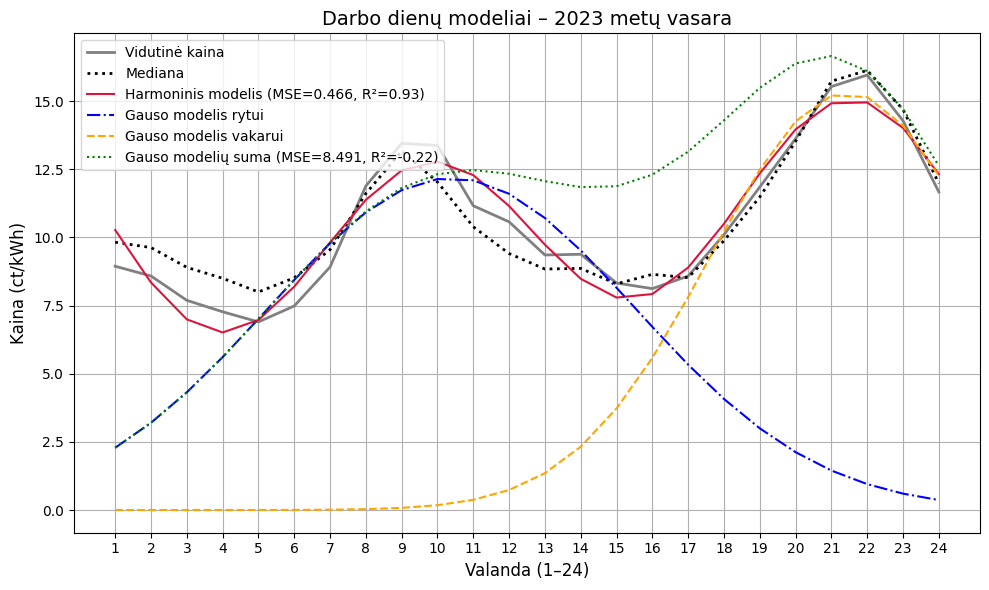

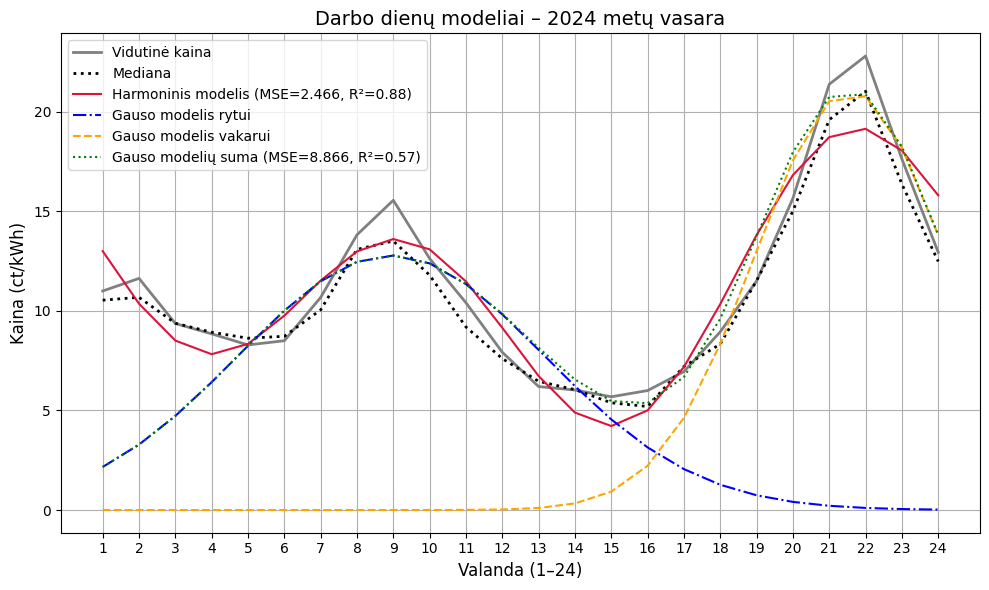

In [63]:
import requests
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime
import pytz
import numpy as np
from scipy.optimize import curve_fit
from sklearn.metrics import mean_squared_error, r2_score


def download_and_process_json(url: str) -> pd.DataFrame:
    response = requests.get(url)
    response.raise_for_status()
    data = response.json()

    df = pd.DataFrame(data)
    df['local_time'] = pd.to_datetime(df['ltu'])
    df['price_ct_kwh'] = df['value'].astype(float) * 0.1
    df.set_index('local_time', inplace=True)
    return df


def fit_two_peak_cosine(hours: np.ndarray, values: np.ndarray):
    def model(h, a0, a1, b1, a2, b2):
        return (
            a0 +
            a1 * np.cos(2 * np.pi * h / 24) + b1 * np.sin(2 * np.pi * h / 24) +
            a2 * np.cos(4 * np.pi * h / 24) + b2 * np.sin(4 * np.pi * h / 24)
        )
    params, _ = curve_fit(model, hours, values)
    return lambda h: model(h, *params), params


def fit_gaussian(x: np.ndarray, y: np.ndarray):
    if len(x) == 0 or len(y) == 0:
        return lambda h: np.full_like(h, np.nan, dtype=float), [np.nan, np.nan, np.nan]

    def gauss(x, a, mu, sigma):
        return a * np.exp(-(x - mu) ** 2 / (2 * sigma ** 2))

    init_params = [max(y), x[np.argmax(y)], 2.0]
    try:
        popt, _ = curve_fit(gauss, x, y, p0=init_params)
        return lambda h: gauss(h, *popt), popt
    except RuntimeError:
        return lambda h: np.full_like(h, np.nan, dtype=float), init_params


def plot_model_comparison_for_each_summer(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    summers = df[(df['weekday'] < 5) & (df['month'].isin([6, 7, 8]))]

    for year in sorted(summers['year'].unique()):
        subset = summers[summers['year'] == year]
        hour_avg = subset.groupby('hour')['price_ct_kwh'].mean()
        hour_median = subset.groupby('hour')['price_ct_kwh'].median()
        hours = np.arange(24)
        values = hour_avg.values

        cosine_model, _ = fit_two_peak_cosine(hours, values)
        cosine_vals = cosine_model(hours)

        gauss_morning_model, _ = fit_gaussian(hours[4:16], values[4:16])
        gauss_evening_model, _ = fit_gaussian(hours[16:], values[16:])
        gauss_morning_vals = gauss_morning_model(hours)
        gauss_evening_vals = gauss_evening_model(hours)
        gauss_split_vals = np.where(~np.isnan(gauss_morning_vals), gauss_morning_vals, gauss_evening_vals)

        mask_cosine = ~np.isnan(cosine_vals)
        mask_split = ~np.isnan(gauss_split_vals)
        gauss_sum_vals = gauss_morning_vals + gauss_evening_vals
        mse_sum = mean_squared_error(values, gauss_sum_vals)
        r2_sum = r2_score(values, gauss_sum_vals)

        metrics = {
            'Cosine': (
                mean_squared_error(values[mask_cosine], cosine_vals[mask_cosine]),
                r2_score(values[mask_cosine], cosine_vals[mask_cosine])
            ),
            'Gaussian (split)': (
                mean_squared_error(values[mask_split], gauss_split_vals[mask_split]),
                r2_score(values[mask_split], gauss_split_vals[mask_split])
            ),
            'Gaussian (sum)': (
                mse_sum,
                r2_sum
            )
        }

        plt.figure(figsize=(10, 6))
        plt.plot(hours + 1, values, label='Vidutinė kaina', color='gray', linewidth=2)
        plt.plot(hours + 1, hour_median.values, label='Mediana', color='black', linewidth=2, linestyle=':')
        plt.plot(hours + 1, cosine_vals,
                 label=f'Harmoninis modelis (MSE={metrics["Cosine"][0]:.3f}, R²={metrics["Cosine"][1]:.2f})',
                 color='crimson')
        plt.plot(hours + 1, gauss_morning_vals,
                 label='Gauso modelis rytui', color='blue', linestyle='-.')
        plt.plot(hours + 1, gauss_evening_vals,
                 label='Gauso modelis vakarui', color='orange', linestyle='--')
        gauss_sum_vals = gauss_morning_vals + gauss_evening_vals
        mse_sum = mean_squared_error(values, gauss_sum_vals)
        r2_sum = r2_score(values, gauss_sum_vals)
        plt.plot(hours + 1, gauss_sum_vals,
                 label=f'Gauso modelių suma (MSE={metrics["Gaussian (sum)"][0]:.3f}, R²={metrics["Gaussian (sum)"][1]:.2f})', color='green', linestyle=':')

        plt.title(f"Darbo dienų modeliai – {year} metų vasara", fontsize=14)
        plt.xlabel("Valanda (1–24)", fontsize=12)
        plt.ylabel("Kaina (ct/kWh)", fontsize=12)
        plt.xticks(range(1, 25))
        plt.grid(True)
        plt.legend()
        plt.tight_layout()
        plt.show()


def plot_monthly_peak_positions(df: pd.DataFrame):
    df = df.copy()
    df['hour'] = df.index.hour
    df['weekday'] = df.index.weekday
    df['year'] = df.index.year
    df['month'] = df.index.month

    workdays = df[df['weekday'] < 5]
    grouped = workdays.groupby(['year', 'month'])

    months = []
    morning_peaks = []
    evening_peaks = []

    for (year, month), group in grouped:
        hour_avg = group.groupby('hour')['price_ct_kwh'].mean()
        hours = np.arange(24)
        values = hour_avg.values

        gauss_morning_model, _ = fit_gaussian(hours[4:16], values[4:16])
        gauss_evening_model, _ = fit_gaussian(hours[16:], values[16:])
        gauss_morning_vals = gauss_morning_model(hours)
        gauss_evening_vals = gauss_evening_model(hours)

        if np.all(np.isnan(gauss_morning_vals)) or np.all(np.isnan(gauss_evening_vals)):
            continue

        morning_peak = np.nanargmax(gauss_morning_vals) + 1
        evening_peak = np.nanargmax(gauss_evening_vals) + 1

        months.append(f"{year}-{month:02d}")
        morning_peaks.append(morning_peak)
        evening_peaks.append(evening_peak)

    plt.figure(figsize=(12, 6))
    x = np.arange(len(months))
    plt.scatter(x, morning_peaks, label='Rytinis pikas', color='blue')
    plt.scatter(x, evening_peaks, label='Vakarinis pikas', color='orange')
    plt.xticks(x, months, rotation=90)
    plt.ylabel("Valanda (1–24)")
    plt.title("Mėnesiniai Gauso modelio piko laikai")
    plt.grid(True, axis='y', linestyle='--', alpha=0.5)
    plt.legend()
    plt.tight_layout()
    plt.show()


    def main():
        url = "https://data.gov.lt/media/filer_public/af/c0/afc0bec7-14fd-4174-9545-b81a722c1dd5/nord_pool_lietuva_eurmwh.json"
        df = download_and_process_json(url)
        plot_model_comparison_for_each_summer(df)
        plot_monthly_peak_positions(df)


if __name__ == "__main__":
    main()
